# NGC 628 (M74, UGC 1149)  2D small

In [1]:
from IPython.display import HTML
from IPython.display import Image
import os
from PIL import Image as ImagePIL
import itertools
import time
from astropy.io import fits
import cv2
import matplotlib.patches as patches
import math
import copy

from scipy.interpolate import LinearNDInterpolator, RectBivariateSpline, RegularGridInterpolator
from scipy.ndimage import map_coordinates
# https://nbviewer.jupyter.org/github/pierre-haessig/stodynprog/blob/master/stodynprog/linear_interp_benchmark.ipynb

%pylab
%matplotlib inline
%run ../../utils/load_notebook.py

Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


C:\Anaconda\lib\site-packages\IPython\core\magics\pylab.py:161: UserWarning: pylab import has clobbered these variables: ['copy']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [2]:
from utils import *

importing Jupyter notebook from utils.ipynb
importing Jupyter notebook from instabilities.ipynb
Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [3]:
from photometry import *

importing Jupyter notebook from photometry.ipynb
Using matplotlib backend: Qt5Agg
Populating the interactive namespace from numpy and matplotlib


In [4]:
from instabilities import *

* [NED](https://ned.ipac.caltech.edu/cgi-bin/objsearch?objname=n628&extend=no&hconst=73&omegam=0.27&omegav=0.73&corr_z=1&out_csys=Equatorial&out_equinox=J2000.0&obj_sort=RA+or+Longitude&of=pre_text&zv_breaker=30000.0&list_limit=5&img_stamp=YES)
* [HYPERLEDA](http://leda.univ-lyon1.fr/ledacat.cgi?o=n628)

In [5]:
name = 'NGC628'
# gtype = 'SBm' #LEDA
incl = 7.0  #Leroy, Walter08
distance = 7.3 #Mpc, Walter08
scale = calc_scale(distance) #kpc/arcsec

# TODO: предпочесть другой угол и расстояние? Herrmann et al. 2008

data_path = '../../data/ngc628'
sin_i, cos_i = np.sin(incl*np.pi/180.), np.cos(incl*np.pi/180.)
print 'sin_i={:5.5f}, cos_i={:5.5f}, scale={:5.5f} kpc/arcsec'.format(sin_i, cos_i, scale)

sin_i=0.12187, cos_i=0.99255, scale=0.03539 kpc/arcsec


Мотивация: результат из Leroy 2008

In [6]:
os.chdir(data_path)

Полезные функции:

In [7]:
def color_to_level(color, colorbar, barlen, zeroval, scale):
    '''Вычисляем исходную величину из цвета colorbar'''
    argmin = np.argmin(np.linalg.norm(colorbar - color, axis=1))
    return (zeroval + (barlen-argmin)/scale)

def image_map_to_colorbar(img_raw, colorbar, scale, zeroval):
    '''Переводим рисунок в значения, соответствующие его colorbar'''
    height, width = img_raw.height, img_raw.width
    X,Y = np.meshgrid(np.arange(0.,width,1), np.arange(0.,height,1))
    fdata = list(img_raw.getdata())
    try:
        Z = np.array(fdata).reshape(height, width, 4)
    except ValueError:
        Z = np.array(fdata).reshape(height, width, 3)
    Z = np.apply_along_axis(lambda l: color_to_level(l, colorbar, len(colorbar), zeroval, scale), 2, Z)
    Z = Z[::-1, :] #inverse axes
    return Z

def resize_image(img_old, width, height, yinterp=None, xinterp=None):
    '''Изменяем размер картнки интерполяцией на другую сетку'''
    start = time.time()
    old_height, old_width = img_old.shape
    xgrid = np.arange(0.,len(img_old),1)
    ygrid = np.arange(0.,len(img_old[0]),1)
    f_2d_grid = img_old[::-1, :]
    if yinterp is None:
        yinterp = np.linspace(0., old_width, width)
    if xinterp is None:
        xinterp = np.linspace(0., old_height, height)
    points_x, points_y = np.broadcast_arrays(xgrid.reshape(-1,1), ygrid)
    points = np.vstack((points_x.flatten(),
                        points_y.flatten())).T
    values = f_2d_grid.flatten()
    f_2d_interp = LinearNDInterpolator(points, values)
    tmp = f_2d_interp(xinterp.reshape(-1,1), yinterp)
    print 'resize take {:2.2f} sec'.format(time.time()-start)
    return tmp[::-1, :]

from matplotlib import colors

# http://www-astro.physics.ox.ac.uk/~mxc/software/

def register_sauron_colormap():
    """
    Regitsr the 'sauron' and 'sauron_r' colormaps in Matplotlib

    """
    cdict = {'red':[(0.000,   0.01,   0.01),
                 (0.170,   0.0,    0.0),
                 (0.336,   0.4,    0.4),
                 (0.414,   0.5,    0.5),
                 (0.463,   0.3,    0.3),
                 (0.502,   0.0,    0.0),
                 (0.541,   0.7,    0.7),
                 (0.590,   1.0,    1.0),
                 (0.668,   1.0,    1.0),
                 (0.834,   1.0,    1.0),
                 (1.000,   0.9,    0.9)],
        'green':[(0.000,   0.01,   0.01),
                 (0.170,   0.0,    0.0),
                 (0.336,   0.85,   0.85),
                 (0.414,   1.0,    1.0),
                 (0.463,   1.0,    1.0),
                 (0.502,   0.9,    0.9),
                 (0.541,   1.0,    1.0),
                 (0.590,   1.0,    1.0),
                 (0.668,   0.85,   0.85),
                 (0.834,   0.0,    0.0),
                 (1.000,   0.9,    0.9)],
         'blue':[(0.000,   0.01,   0.01),
                 (0.170,   1.0,    1.0),
                 (0.336,   1.0,    1.0),
                 (0.414,   1.0,    1.0),
                 (0.463,   0.7,    0.7),
                 (0.502,   0.0,    0.0),
                 (0.541,   0.0,    0.0),
                 (0.590,   0.0,    0.0),
                 (0.668,   0.0,    0.0),
                 (0.834,   0.0,    0.0),
                 (1.000,   0.9,    0.9)]
         }

    rdict = {'red':[(0.000,   0.9,    0.9),
                 (0.170,   1.0,    1.0),
                 (0.336,   1.0,    1.0),
                 (0.414,   1.0,    1.0),
                 (0.463,   0.7,    0.7),
                 (0.502,   0.0,    0.0),
                 (0.541,   0.3,    0.3),
                 (0.590,   0.5,    0.5),
                 (0.668,   0.4,    0.4),
                 (0.834,   0.0,    0.0),
                 (1.000,   0.01,   0.01)],
        'green':[(0.000,   0.9,    0.9),
                 (0.170,   0.0,    0.0),
                 (0.336,   0.85,   0.85),
                 (0.414,   1.0,    1.0),
                 (0.463,   1.0,    1.0),
                 (0.502,   0.9,    0.9),
                 (0.541,   1.0,    1.0),
                 (0.590,   1.0,    1.0),
                 (0.668,   0.85,   0.85),
                 (0.834,   0.0,    0.0),
                 (1.000,   0.01,   0.01)],
         'blue':[(0.000,   0.9,    0.9),
                 (0.170,   0.0,    0.0),
                 (0.336,   0.0,    0.0),
                 (0.414,   0.0,    0.0),
                 (0.463,   0.0,    0.0),
                 (0.502,   0.0,    0.0),
                 (0.541,   0.7,    0.7),
                 (0.590,   1.0,    1.0),
                 (0.668,   1.0,    1.0),
                 (0.834,   1.0,    1.0),
                 (1.000,   0.01,   0.01)]
         }

    sauron = colors.LinearSegmentedColormap('sauron', cdict)
    sauron_r = colors.LinearSegmentedColormap('sauron_r', rdict)
    plt.register_cmap(cmap=sauron)
    plt.register_cmap(cmap=sauron_r)
    
    
register_sauron_colormap()

In [8]:
# размеры области pix
Ny, Nx = 55, 155

Работа с координатами в фитсах:

- https://astropy.readthedocs.io/en/latest/nddata/utils.html#cutout-images
- https://astropy.readthedocs.io/en/latest/api/astropy.nddata.utils.Cutout2D.html
- http://hea-www.harvard.edu/~aldcroft/tmp/p4a/hamogu/html/astropy/wcs.html
* reproject https://reproject.readthedocs.io/en/stable/

In [9]:
from astropy.wcs import WCS
from astropy.io import fits
from astropy.coordinates import SkyCoord
import astropy.units as u
from astropy.nddata import Cutout2D
from mpl_toolkits.axes_grid1 import make_axes_locatable
from astropy.wcs.utils import pixel_to_skycoord, skycoord_to_pixel

def build_wcs(fits_name):
    data = fits.getdata(fits_name)
    data = np.squeeze(data)
    w = WCS(fname, naxis=2)    
#     header = fits.getheader(fits_name, naxis=2)
#     w = WCS(header)
    return w

def get_cutout(fits_name, size=(106, 314)):
    data = fits.getdata(fits_name)
    data = np.squeeze(data)
    w = WCS(fits_name, naxis=2)
    cposition= SkyCoord('{} {}'.format(w.wcs.crval[0], w.wcs.crval[1]), frame='fk5', unit='deg', equinox='J2000.0')
#     print cposition
#     cposition= SkyCoord('24.176371524899999  15.7865508568', frame='fk5', unit='deg', equinox='J2000.0')
    cposition= SkyCoord('24.174042  15.783472', frame='fk5', unit='deg', equinox='J2000.0')
    
    size = u.Quantity(size, u.arcsec)
    cutout = Cutout2D(data, cposition, size, wcs=w)
    return cutout, w

def plot_cutout(fits_name, size=(106, 314), coordinates=True, figsize=[24, 8], colorbar=False, title=None, **kwargs):
    cutout, wcs = get_cutout(fits_name, size=size)
    
    # http://docs.astropy.org/en/stable/wcs/note_sip.html
    wcs.sip = None
    cutout.wcs.sip = None
    
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111, projection=cutout.wcs)
    im = ax.imshow(cutout.data, origin='lower', **kwargs)
    
#     print pixel_to_skycoord(104, 35, cutout.wcs)
#     print wcs.wcs_pix2world(104, 35,0)
#     print wcs.wcs_world2pix(cposition)
    
    lon = ax.coords[0]
    lat = ax.coords[1]
    if coordinates:
        lon.set_major_formatter('dd:mm:ss')
        lat.set_major_formatter('dd:mm:ss')

        lon.set_ticks(spacing=30. * u.arcsec)
        lat.set_ticks(spacing=30. * u.arcsec)

        lon.display_minor_ticks(True)
        lat.display_minor_ticks(True)
        lat.set_minor_frequency(3)
        lon.set_minor_frequency(3)
    else:
        lon.set_ticks_visible(False)
        lon.set_ticklabel_visible(False)
        lat.set_ticks_visible(False)
        lat.set_ticklabel_visible(False)
        lon.set_axislabel('')
        lat.set_axislabel('')
    
#     ax.scatter(cposition.ra, cposition.dec, 100, color='r')
#     ax.scatter(35.18,  15.8, 100, color='m')
    cposition= SkyCoord('24.174042  15.783472', frame='fk5', unit='deg', equinox='J2000.0')
    spix = skycoord_to_pixel(cposition, cutout.wcs)
    ax.scatter(spix[0],  spix[1], 10, color='m')
    
    X,Y = np.meshgrid(np.arange(0.,160,1), np.arange(0.,60,1))
#     sig_los = Z[4:-1, 3:-2]
#     plt.plot(X[4:-1, 3:-2].ravel(), Y[4:-1, 3:-2].ravel(), '.', color='r', ms=0.5)
    
    
    if title is not None:
        ax.set_title(title + ':{}'.format(cutout.data.shape))
        
    if colorbar:
#         divider = make_axes_locatable(ax)
#         cax = divider.append_axes("right", size="5%", pad=0.05)
#         plt.colorbar(im, cax=cax)
        vmin,vmax = im.get_clim()
        #-- Defining a normalised scale
        cNorm = matplotlib.colors.Normalize(vmin=vmin, vmax=vmax)
        #-- Creating a new axes at the right side
        ax3 = fig.add_axes([0.9, 0.1, 0.03, 0.8])
        #-- Plotting the colormap in the created axes
        cb1 = matplotlib.colorbar.ColorbarBase(ax3, norm=cNorm)
#     plt.show()
    return cutout

def plot_rectange_from_grid(ax, points, color='r', ls='-', ms=3, **kwargs):
    mi_x, ma_x, mi_y, ma_y = min(zip(*points)[0]), max(zip(*points)[0]), min(zip(*points)[1]), max(zip(*points)[1])
    ax.plot([mi_x, mi_x],  [mi_y, ma_y], ls=ls, ms=ms, color=color, **kwargs)
    ax.plot([mi_x, ma_x],  [mi_y, mi_y], ls=ls, ms=ms, color=color, **kwargs)
    ax.plot([mi_x, ma_x],  [ma_y, ma_y], ls=ls, ms=ms, color=color, **kwargs)
    ax.plot([ma_x, ma_x],  [mi_y, ma_y], ls=ls, ms=ms, color=color, **kwargs)

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


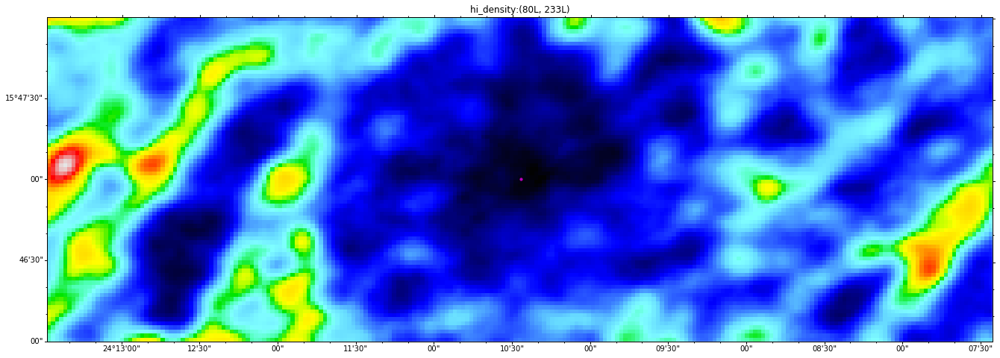

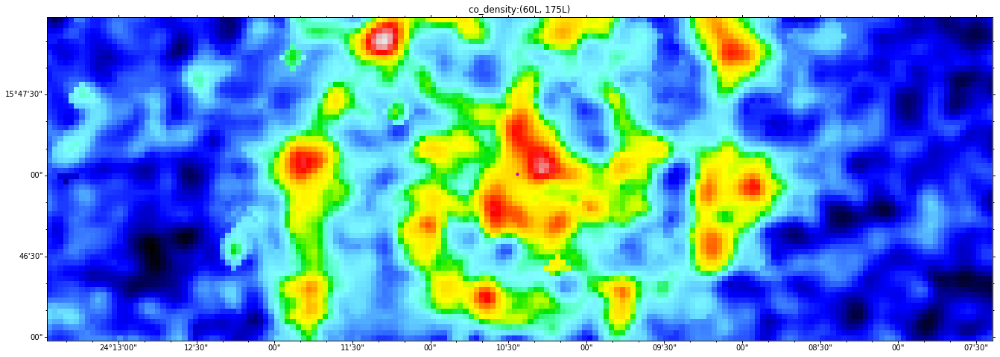

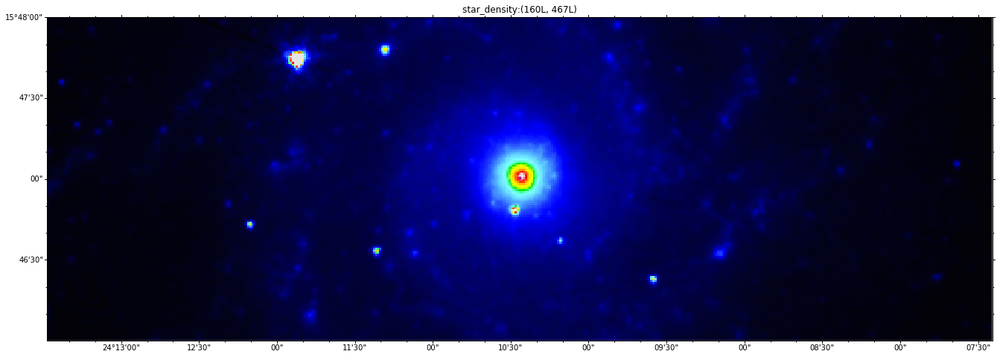

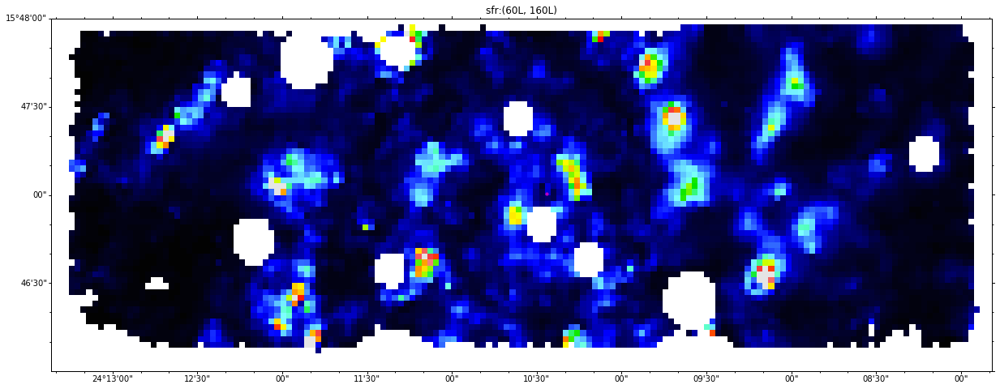

In [10]:
size = (120, 350)

plot_cutout('NGC_628_NA_MOM0_THINGS.FITS', size=size, coordinates=True, figsize=[24, 8], title='hi_density', cmap='sauron')
plot_cutout('../../data/ngc628/ngc0628_heracles_mom0.fits', size=size, coordinates=True, figsize=[24, 8], title='co_density', cmap='sauron')
plot_cutout('NGC0628.phot.1_nonan.fits', size=size, coordinates=True, figsize=[24, 8], title='star_density', cmap='sauron', vmax=10.)
plot_cutout('../../data/ngc628/blanc_fits/NGC0628_map_ha_corr.fits', size=size, coordinates=True, figsize=[24, 8], title='sfr', cmap='sauron', colorbar=False, vmax=1e-14)

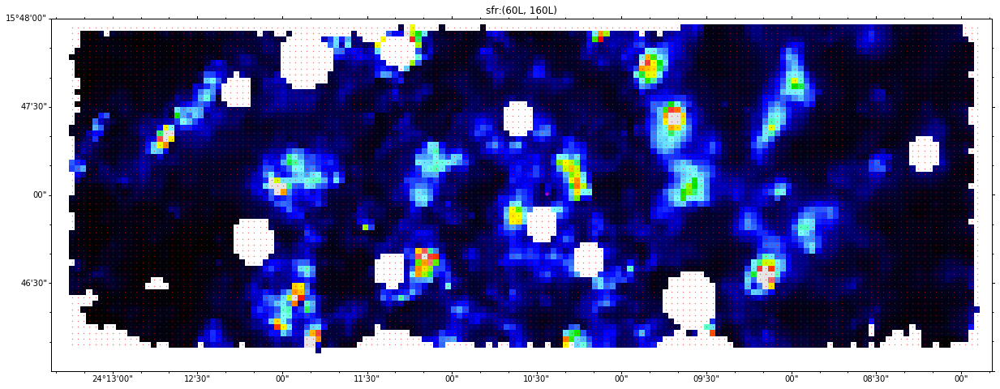

In [11]:
cutout = plot_cutout('../../data/ngc628/blanc_fits/NGC0628_map_ha_corr.fits', size=size, coordinates=True, figsize=[24, 8], title='sfr', cmap='sauron', colorbar=False, vmax=1e-14)
venga_wcs  = cutout.wcs
X,Y = np.meshgrid(np.arange(0.,160,1), np.arange(0.,60,1))
plt.plot(X[4:-1, 3:-2].ravel(), Y[4:-1, 3:-2].ravel(), '.', color='r', ms=0.5)
sgrid = pixel_to_skycoord(X[4:-1, 3:-2].ravel(), Y[4:-1, 3:-2].ravel(), venga_wcs).reshape((55, 155))
# plt.scatter(len(X[0])/2, len(X)/2, 150, color='m')
plt.show()

# Источники, мотивация и картинки

Сравнивать будем с результатами из [The Star Formation Efficiency in Nearby Galaxies: Measuring Where Gas Forms Stars Effectively](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2782/pdf) Leroy 2008

Цитата про S04 модель, которая объясняет чем у них плохо:
> Inner galaxy disks will tend
to have higher metallicities, which will lower ΣS04. We already
find Σgas > ΣS04 over most inner disks; therefore, missing Z
seems unlikely to seriously bias our results.

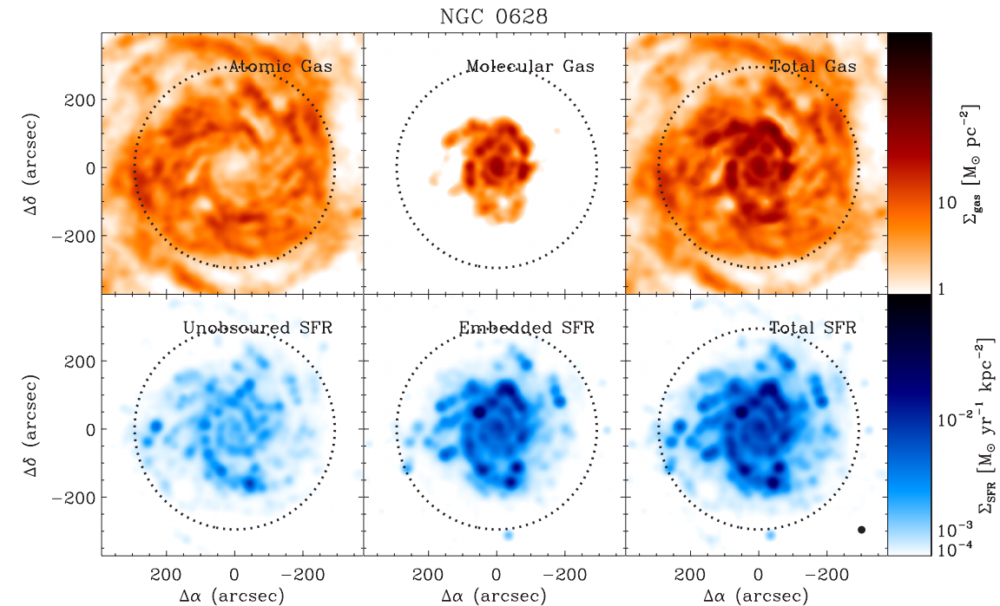

In [6]:
Image('Leroy2008_maps.png')

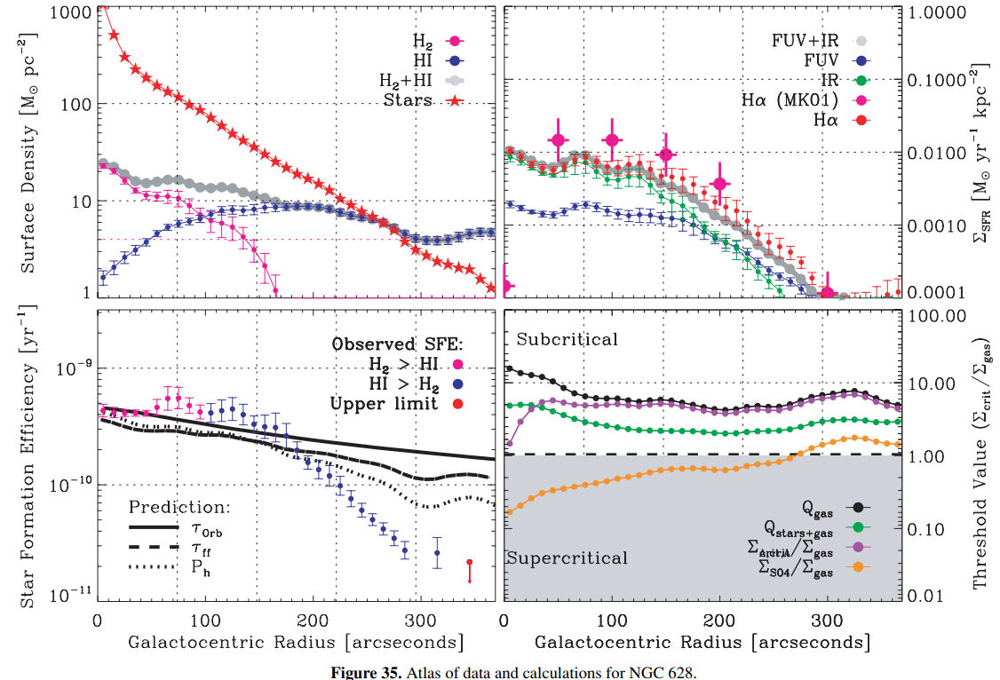

In [7]:
Image('Leroy2008_results.png')

* [THINGS: THE H i NEARBY GALAXY SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf) Walter 2008 - $I_{HI}, V_{HI}, \sigma_{HI}$
* https://arxiv.org/pdf/1612.05272.pdf - velocity dispersion of the HI gas, and early work with the WSRT indicated a value around 10 km/s, with a slight enhancement in star forming regions as found for NGC 628 by Shostak and van der Kruit (1984)
* [THE BIMA SURVEY OF NEARBY GALAXIES. I. THE RADIAL DISTRIBUTION OF CO EMISSION IN SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1086/323221/pdf)-$I_{CO}$
* [THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): SURVEY DESIGN, DATA PROCESSING, AND SPECTRAL ANALYSIS METHODS](http://iopscience.iop.org/article/10.1088/0004-6256/145/5/138/pdf) - $V_*, \sigma_*$
* [THE VIRUS-P EXPLORATION OF NEARBY GALAXIES (VENGA): THE XCO GRADIENT IN NGC 628](http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf) - Данные по $SFR$, $I_{CO}$ из HERACLES, BIMA, CARMS, карта металличности, изучение $X_{CO}$
>We caution against adopting a single XCO value when large changes in gas surface density
or metallicity are present.
* [The JCMT Nearby Galaxies Legacy Survey – IV. Velocity dispersions in the molecular interstellar medium in spiral galaxies](https://ui.adsabs.harvard.edu/#abs/2011MNRAS.410.1409W/abstract)- $\sigma_{CO(3-2)}$
>CO J = 3–2 velocity dispersion for six galaxies which are not members of the Virgo cluster. (a) NGC 628. Contour levels are 2.5, 5 and 10 km s−1
and the colour scale peak is 15 km s−1.
* [The extended law of star formation: the combined role of gas and stars](https://arxiv.org/pdf/1702.02609.pdf) Dib (2016) - **обязательно цитировать**, ибо они делают очень похожее и для той же галактики с теми же данными! Но при этом там непонятная турбулентность, результаты похожи на читерские, пикселей всего 90 (The number of resolution elements in NGC 628 that simultaneously have σ∗ measurements in VENGA as well as measured values of ΣSFR,obs is 91 - ?), звезды у них изотермическая жидкость, т.е. дисперсии во все стороны равны.
* [COMPARING C ii, H i, AND CO DYNAMICS OF NEARBY GALAXIES](https://arxiv.org/pdf/1604.08777.pdf)- есть карта скоростей CII, HI и CO
* [CO(J = 3 − 2) On-the-fly Mapping of the Nearby Spiral Galaxies NGC 628 and NGC 7793: Spatially-resolved CO(J = 3 − 2) Star-formation Law](https://arxiv.org/pdf/1512.04159.pdf)-$I_{CO(3-2)}$
* [HI AND CO VELOCITY DISPERSIONS IN NEARBY GALAXIES](https://arxiv.org/pdf/1511.06006.pdf) - радиальные профили $\sigma_{HI}, \sigma_{CO}$, можно использовать для проверки
* [HERACLES: THE HERA CO LINE EXTRAGALACTIC SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/137/6/4670/pdf) Leroy 2009 - есть карта $I_{CO(2-1)}$
* [SCALING RELATIONS OF THE PROPERTIES FOR CO RESOLVED STRUCTURES IN NEARBY SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf) Leroy 2015 - $\Sigma_{H_2}, \Sigma_{SFR}$ (правда только для верхней части галактики судя по всему)
* [THE CO-TO-H2 CONVERSION FACTOR AND DUST-TO-GAS RATIO ON KILOPARSEC SCALES IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/777/1/5/pdf) - Данные по $\alpha_{CO}, \Sigma_{dust}$
* [DISCOVERY OF RECENT STAR FORMATION IN THE EXTREME OUTER REGIONS OF DISK GALAXIES](http://iopscience.iop.org/article/10.1086/311626/pdf) - $H_{\alpha}$ картинка
* [The JCMT Nearby Galaxies Legacy Survey. VII. Hα imaging and massive star formation properties](https://arxiv.org/pdf/1203.0001.pdf) - картинка $H_{\alpha}$
* [The Westerbork SINGS survey III. Global magnetic field topology](https://www.aanda.org/articles/aa/pdf/2010/06/aa13375-09.pdf) - В случае, если нас заинтересует - есть данные по магнитному полю
* [Hα Kinematics of the SINGS Nearby Galaxies Survey](https://arxiv.org/pdf/astro-ph/0601376.pdf) - $H_{\alpha}$ кривая вращения
* [The JCMT Nearby Galaxies Legacy Survey – VIII. CO data and the LCO(3−2)–LFIR correlation in the SINGS sample](https://oup.silverchair-cdn.com/oup/backfile/Content_public/Journal/mnras/424/4/10.1111_j.1365-2966.2012.21453.x/1/424-4-3050.pdf?Expires=1504015928&Signature=LkroryIoCFcC7KwEtI73WJ5DKK3qzRrM56WiybgKCpcejAtQaaqbqzVcZkEUnYo3u3M8-nsM4AWNjXtjV3nJHRi5FU1dqAQ4VqritmCvXw1hbstOSTNWjsZzPNiD9TAehKbLPAblc6EFF0338NS7vyGp8UUNWq95zIeqA0FIjM4UxtotKVyOfjsMruYY4PjjJCbF8ItUsFFXelMiri2JlKUuVS6Lz2pmfxj8UntbHhqzVBawtdWD4IV0BTLPHN6oB58hwZ~3lVXurPXOkm1C9a-GBaZCQgEucyDCTjIPoJJWnE1fY7z5ouaRL6BsJsdHEe3XTr9F9uW387tcailomQ__&Key-Pair-Id=APKAIUCZBIA4LVPAVW3Q) - есть карта $I_{CO(3-2)}, V_{CO(3-2)}$
* Heidt 2001 https://www.aanda.org/articles/aa/pdf/2001/10/aa10227.pdf - Фотометрия балдж 13-20 arcsec
* http://iopscience.iop.org/article/10.1088/0004-6256/142/1/16/pdf - Фотометрия балдж вроде порядка 15
* [http://www.oulu.fi/astronomy/S4G_PIPELINE4/MAIN/decomp0053.html#entry0003](S4G) - там тоже видно, что балдж не такой большой (точно не скажу, надо вспоминать, там scale есть)
* https://arxiv.org/pdf/1506.01653.pdf - $M_*,SFR, extinction$ maps
* SPITZER изображение http://www.spitzer.caltech.edu/images/2257-sig06-018c-NASA-s-Spitzer-Space-Telescope-View-of-M74
* На заглавной https://guaix.fis.ucm.es/sings есть куча картинок NGC628 в полосах FUV 1528 A,	NUV   2271 A,	B   0.45 μm,	V   0.55 μm,	R   0.66 μm,	I   0.81 μm, IRAC1   3.6 μm,
	IRAC2   4.5 μm,IRAC3   5.8 μm,	IRAC4   8.0 μm,	MIPS1   24 μm,	MIPS2   70 μm. 
* S4G $S^4G$ http://www.oulu.fi/astronomy/S4G_PIPELINE4/MAIN/decomp0053.html#entry0003
* [Parameters of the brightest star formation regions in the two principal spiral arms of NGC 628](https://arxiv.org/pdf/1310.3690.pdf) - спиральные рукава и star-forming regions
* [Late-type galaxies observed with SAURON: two-dimensional stellar and emission-line kinematics of 18 spirals](https://academic.oup.com/mnras/article/367/1/46/1020614/Late-type-galaxies-observed-with-SAURON-two) - странные диспресии и скорости
* [The inner mass distribution of late-type spiral galaxies from SAURON stellar kinematic maps](https://arxiv.org/pdf/1609.08700.pdf) - еще более странные дисперсии и скорости. Есть кривая вращения, но как-то уж очень странно извлеченная.
* [Hα kinematics of the SINGS nearby galaxies survey – I](http://adsabs.harvard.edu/abs/2006MNRAS.367..469D)
* http://iopscience.iop.org/article/10.1088/0004-6256/141/1/24/pdf Vollmer Leroy 2011 - турбулентная модель и кривая вращения
* [THE HIERARCHICAL DISTRIBUTION OF THE YOUNG STELLAR CLUSTERS IN SIX LOCAL STAR FORMING GALAXIES](https://arxiv.org/pdf/1704.06321.pdf) и [PLANETARY NEBULAE IN FACE-ON SPIRAL GALAXIES. III. PLANETARY NEBULA KINEMATICS AND DISK MASS](http://iopscience.iop.org/article/10.1088/0004-637X/705/2/1686/pdf) - есть кривая вращения и много разноцветных кружков YSO
* [HERACLES: THE HERA CO LINE EXTRAGALACTIC SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/137/6/4670/pdf) HERACLES CO Leroy 2009 - M_H2/M_HI = 0.24, M_H2/M_* = 0.1, (M_H2 + M_HI)/M_* = 0.52, ну и карта уровней CO само собой
* [WHAT IS DRIVING THE H i VELOCITY DISPERSION?](http://iopscience.iop.org/article/10.1088/0004-6256/137/5/4424/pdf) Tamburro 2009 - THINGS velocity resolution of the H i data cubes - 2.6 km/s, H i mass-weighted median of the H i velocity dispersion - 8.0 km/s, LEDA Hubble Type - S?, есть Radial profiles of H i velocity dispersion 
* [THE STAR FORMATION EFFICIENCY IN NEARBY GALAXIES: MEASURING WHERE GAS FORMS STARS EFFECTIVELY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2782/pdf) Leroy 2008 - M_B = −20.0, logM* = 10.1, logM_HI = 9.7, logM_H2 = 9.0, SFR=0.807 Msun/yr, $l_*\approx l{SFR} \approx l_{CO}$, таблица профилей $\Sigma_{HI},\Sigma_{H2}, \Sigma_{*}, FUV,24\mu m$
* [THINGS: THE H i NEARBY GALAXY SURVEY](http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf) Walter 2008 -  M 74, UGC 1149 RA - 01 36 41.8, Decl. +15 47 00, D-7.3 [Karachentsev et al. 2004], m_B=9.35, PA=20 [Tamburro et al. 2008],  12+log(O/H) - 8.33 [Moustakas 2006], SFR-1.21 [Lee 2006], параметры кубов (их два - NA и RO), $M_{HI} = 3.8\times 10^9$
* [KINGFISH—Key Insights on Nearby Galaxies: A Far-Infrared Survey with Herschel: Survey Description and Image Atlas](http://iopscience.iop.org/article/10.1086/663818/pdf) KENNICUTT 2011 - SAc, size 10.5x9.5 arcmin, dist method SN II, SFR - 0.68, high surface brightness
* [ARM AND INTERARM STAR FORMATION IN SPIRAL GALAXIES](http://iopscience.iop.org/article/10.1088/0004-637X/725/1/534/pdf) Foyle 2010 - изучают спиральный узор, много красивых карт и слов про узор (сколько руковов), но главное
> Taken together these results show that interarm star formation
is significant and that the spiral arms gather the gas into
regions of higher surface densities, which leads to an enhanced
molecular fraction, but they do not “shock trigger” star formation
nor molecular gas formation. Thus, spiral arms act only to
reorganize the material in the disk out of which stars form.
* [REGULATION OF STAR FORMATION RATES IN MULTIPHASE GALACTIC DISKS: A THERMAL/DYNAMICAL EQUILIBRIUM MODEL](http://iopscience.iop.org/article/10.1088/0004-637X/721/2/975/pdf) Ostriker 2010 - довольно важная работа, interstellar medium (ISM) heating by stellar UV plays a key role. By requiring that thermal and (vertical) dynamical equilibrium are simultaneously satisfied within the diffuse gas, and that stars form at a rate proportional to the mass of the self-gravitating component. Получилось неплохое согласие с наблюдениями в 628, но там все азимутально усреднено, масштаб в логарифме и толщина постоянна. Но думаю упомянуть стоит в работе.
* [A HIGH-DISPERSION MOLECULAR GAS COMPONENT IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-6256/146/6/150/pdf) Caldu-Primo 2013 - изучали профили диспресий и есть вывод, который можно использовать чтобы обосновать одинаковую дисперсию для HI и CO (также  Combes & Becquaert, 1997):
> similarity of the CO and H i dispersions suggests that the two
components are well mixed, and are only two different phases
of the same kinematical gas component
* https://arxiv.org/pdf/1606.07077.pdf 2016 - есть CO карта с разрешением 45-60 пк.
* [H I AND CO VELOCITY DISPERSIONS IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.3847/0004-6256/151/1/15/pdf) Mogotsi 2016 - есть средние дисперсии по HI и H2 и соотношение между ними и средняя разница (все азимутально усредненное). Дисперсии очень мало отличаются.
* обязательно надо что-то процитировать из http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf (большая работа, много упоминаний)
* пыль и $X_{CO}$ также исследовались в http://iopscience.iop.org/article/10.1088/0004-637X/756/2/138/pdf, большая яработа, может быть важна (есть карты пыли) 
* [A REVISED PLANETARY NEBULA LUMINOSITY FUNCTION DISTANCE TO NGC 628 USING MUSE](https://arxiv.org/pdf/1611.09369.pdf) - самые новые данные по расстоянию, хотя точность меньше чем у тех где 8.6

Еще данных:

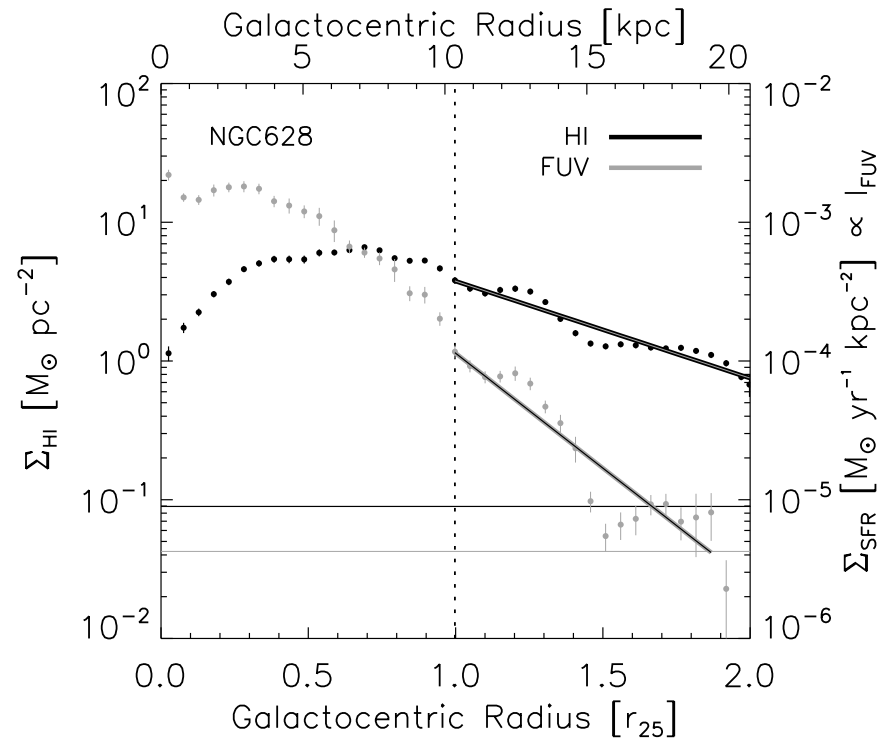

In [12]:
# http://iopscience.iop.org/article/10.1088/0004-6256/140/5/1194/pdf - Bigiel2010
# D-7.3, i-7, PA=20, r25 = 4.9 arcmin, type - Sc
Image('Bigiel2010.png', width=500)

[THE FINE-SCALE STRUCTURE OF THE NEUTRAL INTERSTELLAR MEDIUM IN NEARBY GALAXIES](http://iopscience.iop.org/article/10.1088/0004-6256/141/1/23/pdf) Bagetakos 2011 - изучают HI holes:

> there must be sufficient contrast (at least a 50% drop in
surface brightness) between the hole and its immediate
surroundings & 4. the shape of the hole in pV space must be clearly defined
and adequately described by an ellipse

Также анализируют высоту (средняя - 500 пк ), но там все как обычно по методам. Дыр найдено примерно 100

> NGC 628 is a grand-design Sc spiral galaxy located at a
distance of 7.3 Mpc and is seen almost completely face-on.
We detected 104 holes in its H i layer, with diameters ranging
from 0.24 kpc (the resolution limit) to 2 kpc. Only a small
fraction of these holes are type 3 (≈5%). Several supershells
were detected, however four cases (holes number 24, 45, 47,
and 99) are probably superpositions of two or more holes.

In [ ]:
Image('holes.png', width=600)

[A TEST OF STAR FORMATION LAWS IN DISK GALAXIES. II. DEPENDENCE ON DYNAMICAL PROPERTIES](http://iopscience.iop.org/article/10.1088/0004-637X/787/1/68/pdf) Suwannajak 2014 - есть кривая вращения и сравнение 6 законов звездообразования (K-S,Constant Molecular,KM05,KMT09,Gas-Ω, GMC Collision law), которые все неплохо согласуются.

In [ ]:
Image('Suwannajak2014.png')

# Данные

## Расстояния (THINGS/VENGA область)

Рассчитаем покоординатно расстояние от центра галактики.

https://physics.stackexchange.com/questions/224950/how-can-i-convert-right-ascension-and-declination-to-distances

In [50]:
%%time
cposition= SkyCoord('24.174042  15.783472', frame='fk5', unit='deg', equinox='J2000.0')
dist = np.zeros((55, 155))

for i in range(len(dist)):
    for j in range(len(dist[0])):
        scoord = sgrid[i][j]
        dist[i][j] = cposition.separation(scoord).arcsec

Wall time: 3min 43s


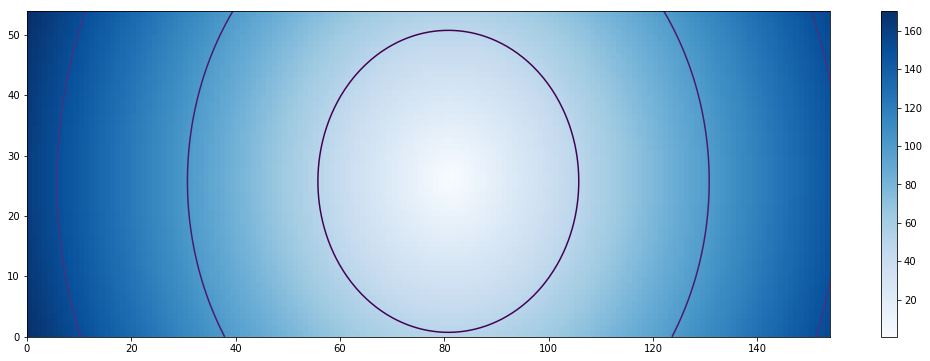

In [52]:
X,Y = np.meshgrid(np.arange(0.,155,1), np.arange(0.,55,1))
plt.figure(figsize=[18, 6])
quadmesh = plt.pcolormesh(X, Y, dist, cmap=cm.Blues)
plt.colorbar()
quadmesh.cmap.set_under('white')
CS = plt.contour(X, Y, dist, levels=[50, 100, 150, 500, 750])

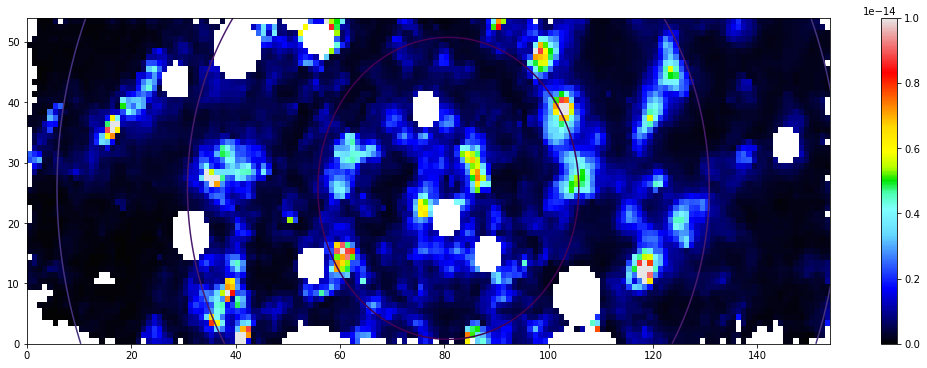

In [63]:
fname = '../../data/ngc628/blanc_fits/NGC0628_map_ha_corr.fits'
data = fits.getdata(fname)
plt.figure(figsize=[18, 6])
quadmesh = plt.pcolormesh(X, Y, np.squeeze(data)[4:-1, 3:-2], cmap='sauron')
quadmesh.set_clim(vmin=0., vmax=1e-14)
# quadmesh.cmap.set_under('white')
plt.colorbar()
CS = plt.contour(X, Y, dist, levels=[50, 100, 150, 500, 750])

plt.show()

In [64]:
np.save('dist.npy', dist)

## Дисперсии $\sigma_{\rm s}$ (VENGA)

$$\sigma^2_{los, \phi} = [\sigma_R^2\sin^2\phi + \sigma^2_{\varphi}\cos^2\phi]\sin^2 i + \sigma_z^2\cos^2 i,$$ where $\phi$ is the angle between the slit and the major axis of the
projected stellar disc (the position angle).

TODO: разрешение куба в пространственном и по скоростям, учеть другой угол и расстояние если надо - у них inclination of i = 8.7 and a distance of 8.6 Mpc (Herrmann et al. 2008).

Как и с SFR, cперва уберем точки и лишнее, применим dilation

VENGA 2013: At the assumed distance of NGC 628 the VENGA spatial resolution corresponds to ∼235 pc (=5.6" FWHM, но пиксели же???)

Fits, который прислал Blanc:

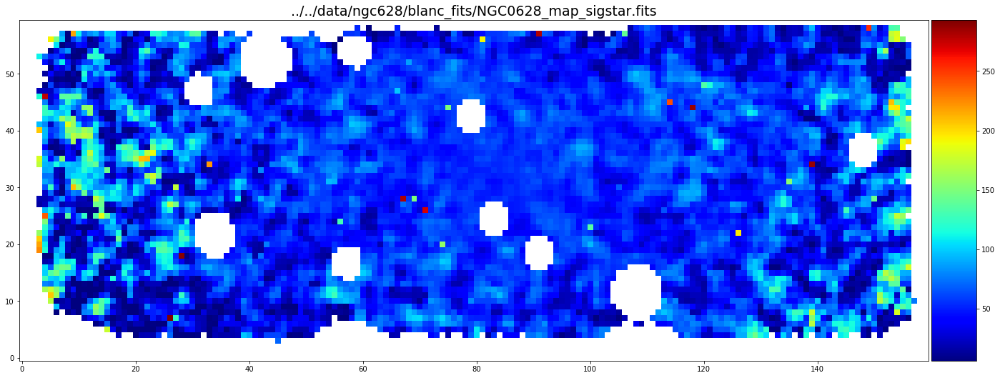

In [125]:
from astropy.io import fits
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig = plt.figure(figsize=[24,16])
ax = plt.gca()
fname = '../../data/ngc628/blanc_fits/NGC0628_map_sigstar.fits'
data = fits.getdata(fname)
im = plt.imshow(np.squeeze(data), origin='lower', cmap='jet')

plt.title(fname, fontsize=19)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax)

plt.show()

In [121]:
data = np.squeeze(data)
data = np.nan_to_num(data)
data.shape

(60L, 160L)

Т.е. 60 на 160 pix. Посмотрим в сауроновских цветах и при оригинальном колорбаре, а также нанесем сетку:

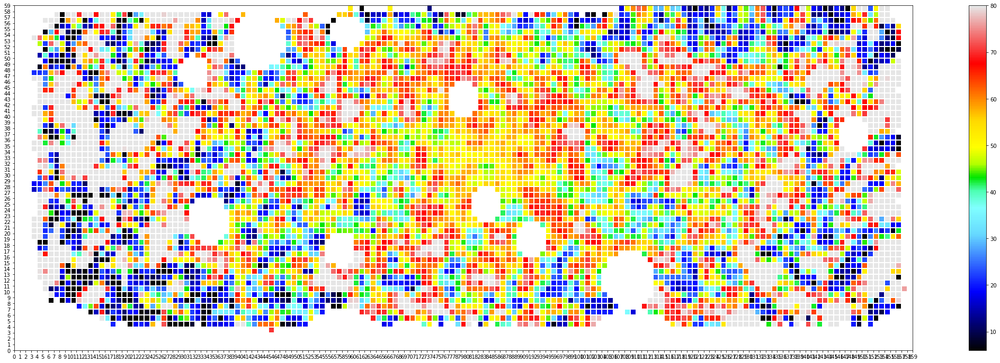

In [67]:
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
fig = plt.figure(figsize=[38, 12])
quadmesh = plt.pcolormesh(X, Y, Z, cmap='sauron')
quadmesh.set_clim(vmin=6., vmax=80.)

# CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
# plt.clabel(CS, inline=1, fontsize=10)

plt.colorbar()

ax = plt.gca()

# Major ticks
ax.set_xticks(np.arange(0, 160, 1));
ax.set_yticks(np.arange(0, 60, 1));

# # Labels for major ticks
# ax.set_xticklabels(np.arange(1, 11, 1));
# ax.set_yticklabels(np.arange(1, 11, 1));

# # Minor ticks
# ax.set_xticks(np.arange(-.5, 10, 0.5), minor=True);
# ax.set_yticks(np.arange(-.5, 10, 0.5), minor=True);

# Gridlines based on minor ticks
ax.grid(which='major', color='w', linestyle='-', linewidth=2)
# ax.grid(which='minor', color='w', linestyle='-', linewidth=1)

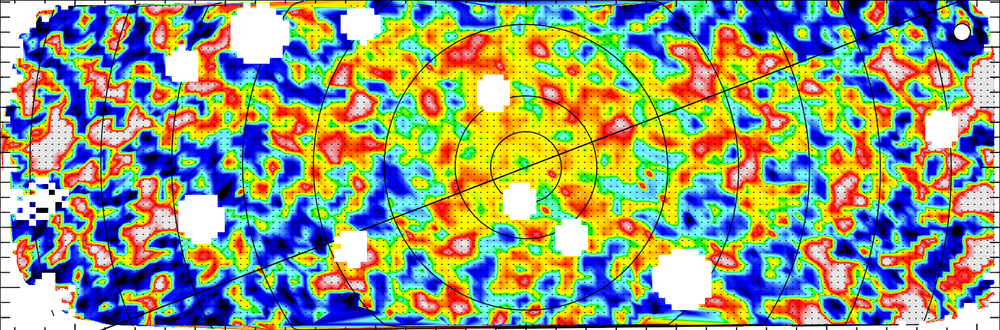

In [68]:
Image('VENGA_sig_los.png', width=1350)

Все очень похоже, хотя они явно снизу убрали часть пикселей (а также слева, справа и сверху). Это согласуется с анализом точек на картинке со статьи, где количество пикселей получилось равным (54L, 154L) (по одному видимо на конце картинки не учли).

In [69]:
sig_los = Z[4:-1, 3:-2]

In [70]:
np.save('sig_los.npy', sig_los)

Теперь надо $\sigma_R$ извлечь, используя формулу выше.

Рассчитаем углы $\phi$ и проверим что верно:

In [71]:
import math

def dotproduct(v1, v2):
    return sum((a*b) for a, b in zip(v1, v2))

def length(v):
    return math.sqrt(dotproduct(v, v))

def angle(v1, v2):
    return math.acos(dotproduct(v1, v2) / (length(v1) * length(v2)))

In [73]:
phi = np.zeros(sig_los.shape)

for i in range(len(sig_los[0])):
    for j in range(len(sig_los)):
        x, y  = 813.5*155./1553.-i, 253.5*55./513.-j
        phi[j][i] = angle(np.array([x,y]), np.array([155., 155.*np.sin(22.5*np.pi/180.)]))*180./np.pi

TODO: проверить, почему приходится дополнительно делать вычитание при отрисовке нулевой линии

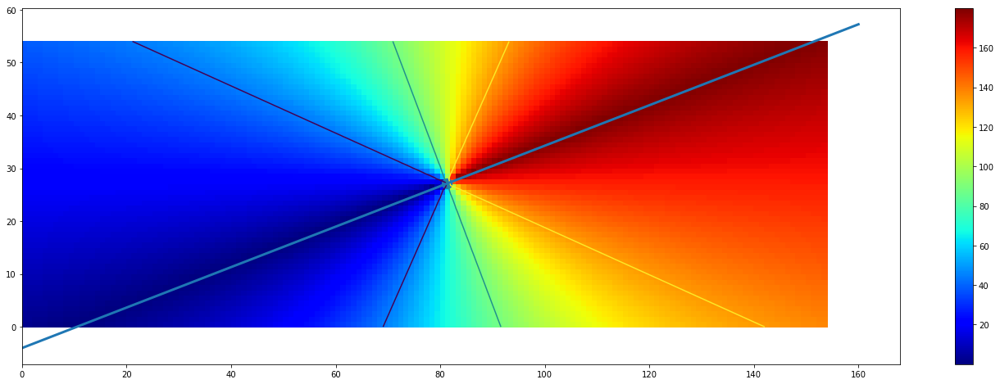

In [74]:
X,Y = np.meshgrid(np.arange(0.,len(sig_los[0]),1), np.arange(0.,len(sig_los),1))

plt.figure(figsize=[24, 8])
quadmesh = plt.pcolormesh(X, Y, phi, cmap=cm.jet)
# quadmesh.set_clim(vmin=6.0, vmax=80.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')

CS = plt.contour(X, Y, phi, levels=[45., 90., 135.], aspect='auto')

plt.plot([0., 160.], [0.-4.0, 160.*np.sin(22.5*np.pi/180.)-4.0], '-', lw=3)
plt.scatter([813.5*155./1553.],[253.5*55./513.],[150.])

In [75]:
sig_r_max = lambda sig, phi_: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + 0.25*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.09*cos_i**2) 
sig_r_min = lambda sig, phi_: sig/np.sqrt(sin_i**2 + 0.49*cos_i**2)

In [76]:
sig_R_max = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_max[i][j] = sig_r_max(sig_los[i][j], phi[i][j])
        
sig_R_min = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_min[i][j] = sig_r_min(sig_los[i][j], phi[i][j])

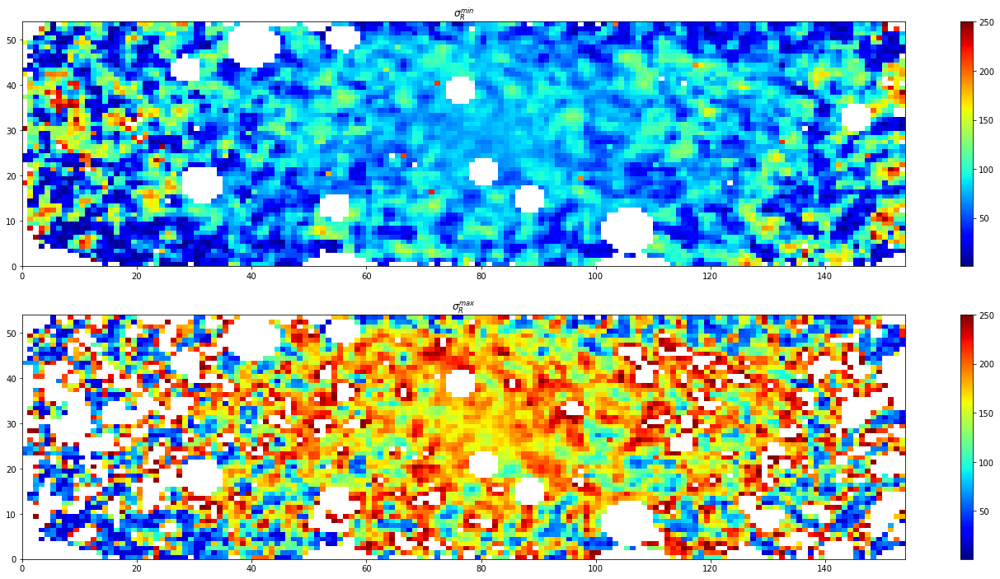

In [77]:
plt.figure(figsize=[24, 12])
plt.subplot(2,1,1)
quadmesh = plt.pcolormesh(X, Y, sig_R_min, cmap=cm.jet)
quadmesh.set_clim(vmin=1.0, vmax=250.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
plt.title(r'$\sigma_R^{min}$')

plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, sig_R_max, cmap=cm.jet)
quadmesh.set_clim(vmin=1.0, vmax=250.)
plt.colorbar()
quadmesh.cmap.set_under('white')
quadmesh.cmap.set_over('white')
plt.title(r'$\sigma_R^{max}$')
plt.show()

In [78]:
np.save('sig_R_max.npy', sig_R_max)
np.save('sig_R_min.npy', sig_R_min)

## Плотность $\Sigma_{\rm HI}$ (THINGS)

Куб данных из THINGS http://www.mpia.de/THINGS/Data.html - дисперсии $\sigma_{HI}$ и плотности $\Sigma_{HI}$.

TODO: про куб - разрешение, почему NA или RO, размеры бима, переводные коэффициенты?, расстояние, H_0 из

http://iopscience.iop.org/article/10.1088/0004-6256/136/6/2563/pdf - масштаб $1.5^{''}/pix$ (а в пк порядка 50 чтоли?)

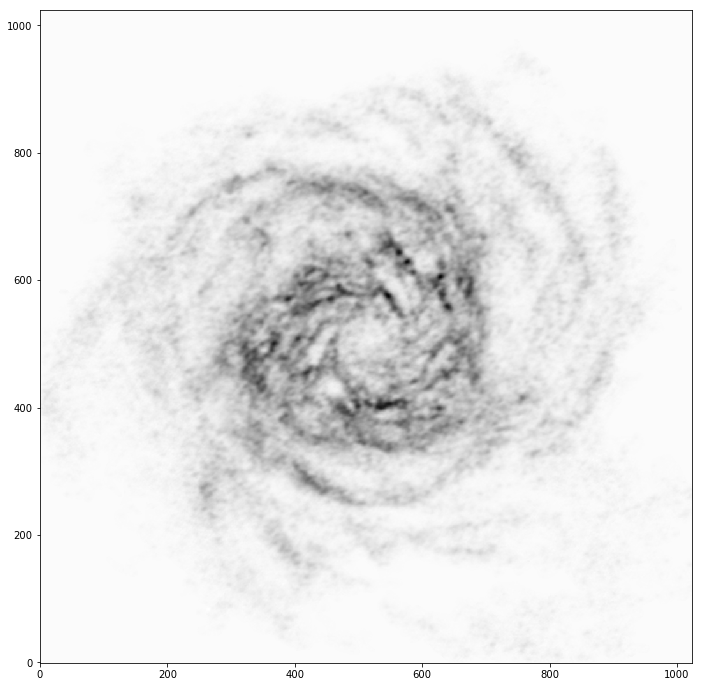

In [41]:
from astropy.io import fits

fig = plt.figure(figsize=[12,12])
data = fits.getdata('NGC_628_NA_MOM0_THINGS.FITS')
plt.imshow(np.squeeze(data), origin='lower', cmap='gist_yarg')
plt.show()

$$\Sigma_{HI} [M_{sun} pc^{-2}] = 0.020 \cos i \times I_{21cm} [K km s^{-1}]$$

TODO:**which accounts for inclination and includes a factor of 1.36 to
reflect the presence of helium!**

из https://arxiv.org/pdf/1609.03179.pdf $$\Sigma_{HI}[M_{sun} {pc}^{-2}] = 8840\times\frac{F_{HI}[Jy / beam \times km/s]}{bmaj\times bmin [arcsec]},$$
where the bmaj and bmin are the major and minor axis size of the beam, respectively. FHI is the flux detected across all velocity channels.

Чтобы перевести в кельвины в Walter написана формула
$$T[K] = 6.07\times 10^5\times S[Jy beam^{-1}]/(B_{maj}\times B_{min}),$$ где $B_{maj},B_{min}$ - размеры бима в секундах

In [20]:
# заменяем nan на 0.
data = np.squeeze(data)
data = np.nan_to_num(data)

Т.к. мы использовал ```NA``` данные - размеры бима 11.88 и 9.30 arcsec

Не знаю почему, но похоже надо переводить beam в пк.

In [42]:
f = lambda l: 6.07*2*1000*cos_i*l/(11.88*9.30*calc_scale(distance)**2 * 1000**2)
Z1 = f(data)

In [23]:
Sigma_HI = Z1
np.save('Sigma_HI.npy', Sigma_HI)

Проверка и сравнение с данными Лероя дают схожие результаты.

Вырежем теперь cutout и сохраним данные по гриду:

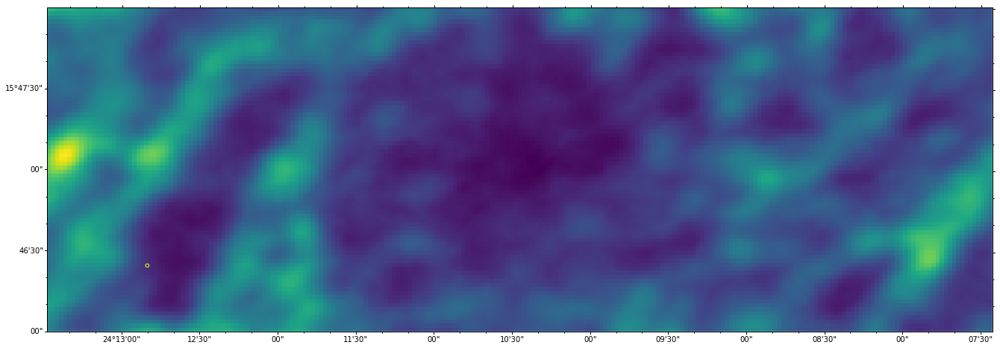

In [46]:
from astropy.visualization.wcsaxes import SphericalCircle

cutout, wcs = get_cutout('NGC_628_NA_MOM0_THINGS.FITS', size=size)

fig = plt.figure(figsize=[24, 8])
ax = fig.add_subplot(111, projection=cutout.wcs)
im = ax.imshow(cutout.data, origin='lower')

lon = ax.coords[0]
lat = ax.coords[1]
lon.set_major_formatter('dd:mm:ss')
lat.set_major_formatter('dd:mm:ss')

lon.set_ticks(spacing=30. * u.arcsec)
lat.set_ticks(spacing=30. * u.arcsec)

lon.display_minor_ticks(True)
lat.display_minor_ticks(True)
lat.set_minor_frequency(3)
lon.set_minor_frequency(3)

r = SphericalCircle((24.174042 * u.deg, 15.783472 * u.deg), 1500 * u.arcsec,
                     edgecolor='yellow', facecolor='none', transform=ax.get_transform(cutout.wcs))
ax.add_patch(r)
plt.show()

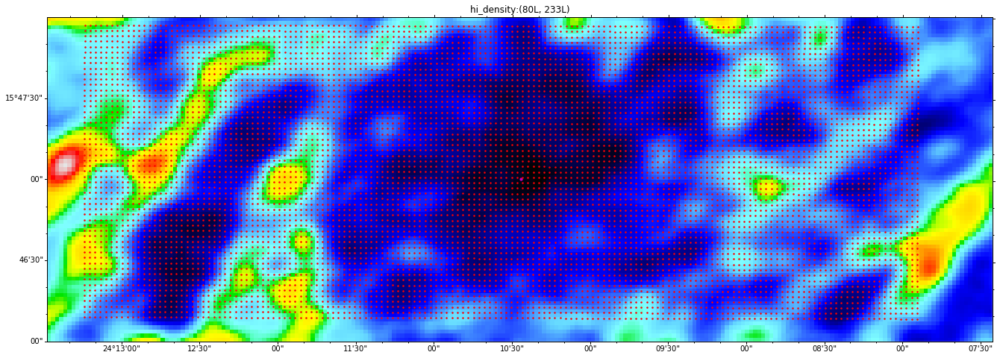

Wall time: 3min 2s


In [48]:
%%time
cutout = plot_cutout('NGC_628_NA_MOM0_THINGS.FITS', size=size, coordinates=True, figsize=[24, 8], title='hi_density', cmap='sauron')

hi_grid_pixs = []
Sigma_HI_cut = []
for scoord in sgrid.ravel():
    spix = skycoord_to_pixel(scoord, cutout.wcs)
    hi_grid_pixs.append(spix)
    Sigma_HI_cut.append(f(cutout.data[int(spix[1])][int(spix[0])]))
plt.plot(zip(*hi_grid_pixs)[0],  zip(*hi_grid_pixs)[1], '.', ms=3, color='r')
plt.show()

In [49]:
len(hi_grid_pixs)

8525

Площадка еще раз

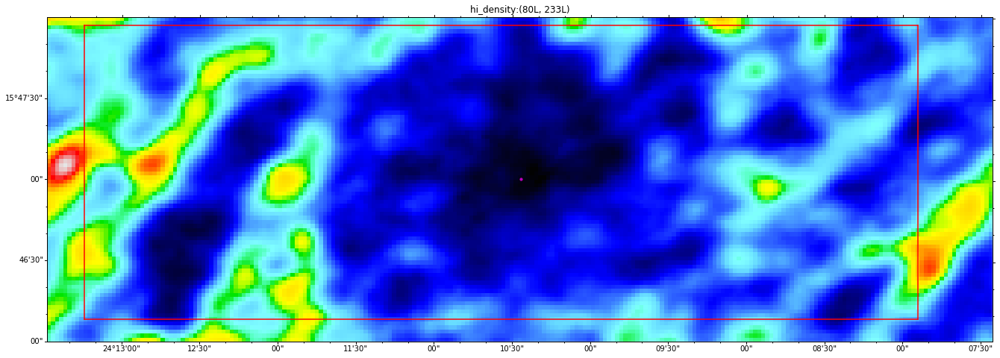

In [50]:
cutout = plot_cutout('NGC_628_NA_MOM0_THINGS.FITS', size=size, coordinates=True, figsize=[24, 8], title='hi_density', cmap='sauron')

plot_rectange_from_grid(plt.gca(), hi_grid_pixs)
plt.show()

In [57]:
Sigma_HI_cut = np.array(Sigma_HI_cut).reshape((55, 155))

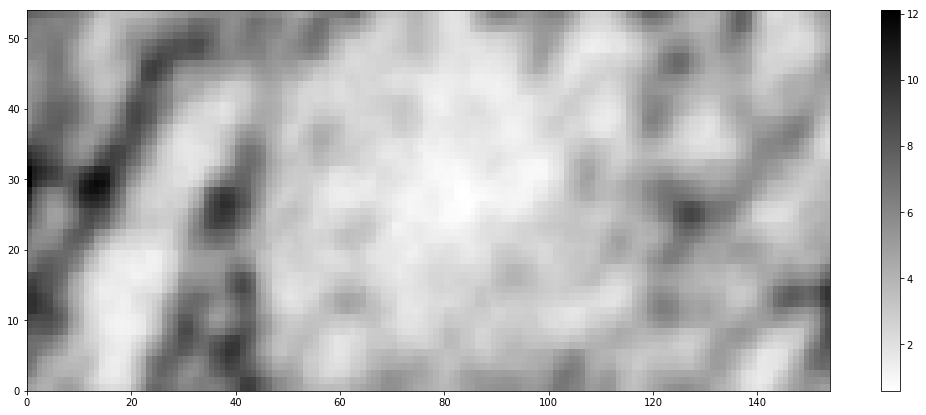

In [58]:
plt.figure(figsize=[18, 7])
X,Y = np.meshgrid(np.arange(0.,155,1), np.arange(0.,55,1))
Z = Sigma_HI_cut
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
plt.colorbar()
quadmesh.cmap.set_under('white')

In [59]:
np.save('Sigma_HI_cut.npy', Sigma_HI_cut)

## Дисперсии $\sigma_{\rm HI}$ (THINGS)

C картинкой в статье совпадает (только в ней вроде убраны с малым S/N точки):

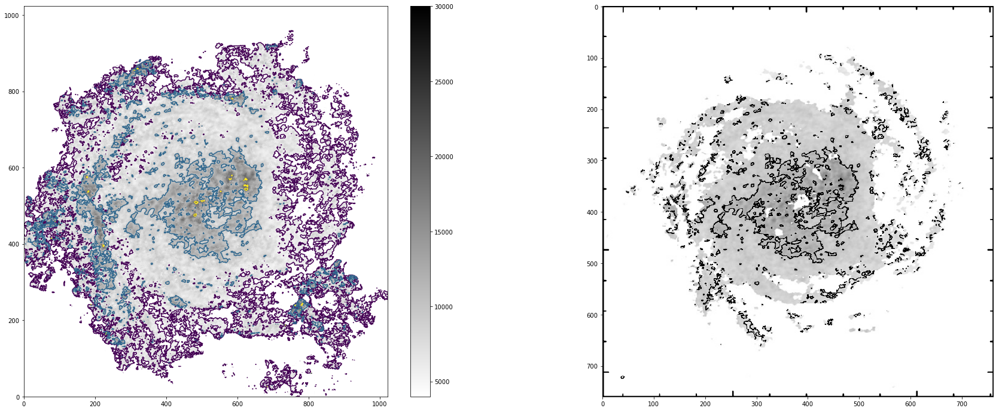

In [129]:
data = fits.getdata('NGC_628_NA_MOM2_THINGS.FITS')
data = np.squeeze(data)
data = np.nan_to_num(data)

X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
Z = data

# ax1,ax2 = plt.subplots(ncols=2, nrows=1, figsize=[16, 8])
plt.figure(figsize=[30, 12])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=4000., vmax=30000.)
plt.colorbar()

CS = plt.contour(X, Y, Z, levels=[5000, 10000, 20000])
quadmesh.cmap.set_under('white')

plt.subplot(1, 2, 2)
plt.imshow(ImagePIL.open('THINGS_HI_disp.png'))

In [130]:
c_g = Z/1000.
np.save('c_g.npy', c_g)

Нужная нам область:

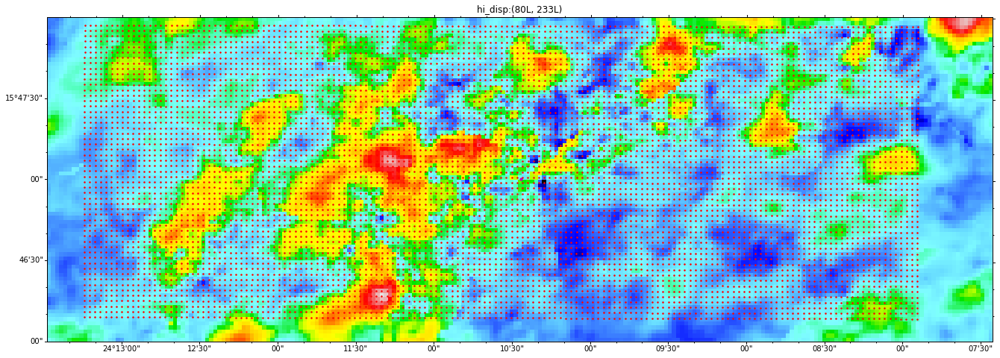

Wall time: 3min 18s


In [131]:
%%time
cutout = plot_cutout('NGC_628_NA_MOM2_THINGS.FITS', size=size, coordinates=True, figsize=[24, 8], title='hi_disp', cmap='sauron')

hi_grid_pixs = []
sigma_HI_cut = []
for scoord in sgrid.ravel():
    spix = skycoord_to_pixel(scoord, cutout.wcs)
    hi_grid_pixs.append(spix)
    sigma_HI_cut.append(cutout.data[int(spix[1])][int(spix[0])]/1000.)
plt.plot(zip(*hi_grid_pixs)[0],  zip(*hi_grid_pixs)[1], '.', ms=3, color='r')
plt.show()

In [132]:
len(hi_grid_pixs)

8525

Площадка еще раз

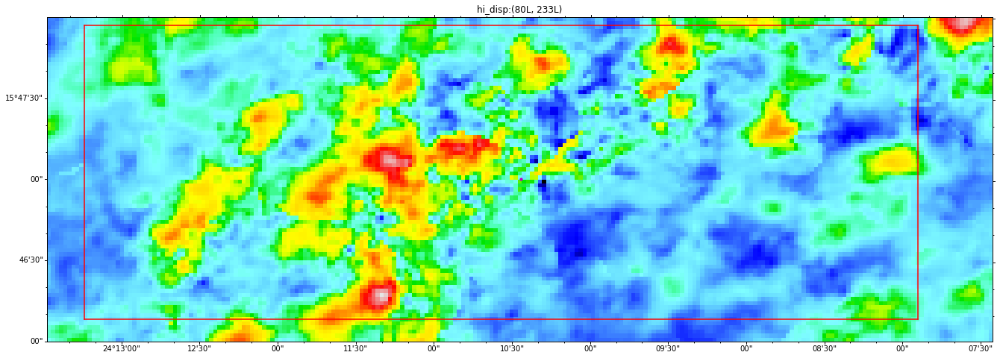

In [133]:
cutout = plot_cutout('NGC_628_NA_MOM2_THINGS.FITS', size=size, coordinates=True, figsize=[24, 8], title='hi_disp', cmap='sauron')
plot_rectange_from_grid(plt.gca(), hi_grid_pixs)
plt.show()

In [134]:
sigma_HI_cut = np.array(sigma_HI_cut).reshape((55, 155))

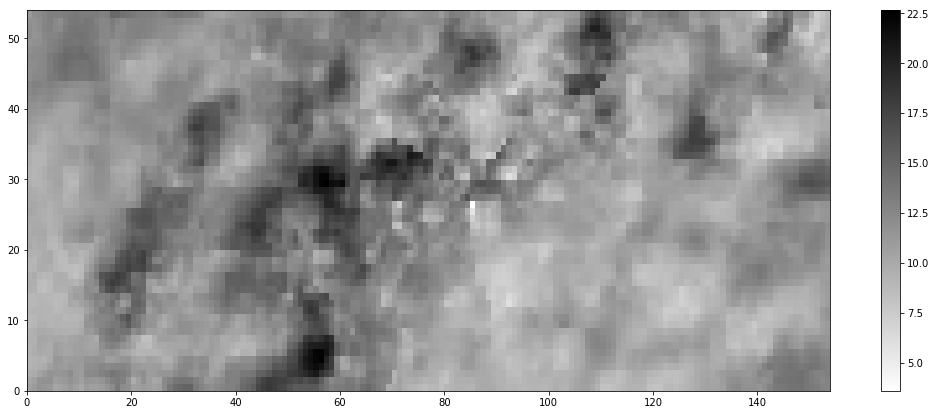

In [135]:
plt.figure(figsize=[18, 7])
X,Y = np.meshgrid(np.arange(0.,155,1), np.arange(0.,55,1))
Z = sigma_HI_cut
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
plt.colorbar()
quadmesh.cmap.set_under('white')

In [136]:
np.save('c_g_cut.npy', sigma_HI_cut)

## Кривая вращения и эпициклическая частота

Я разрежу сам руками вдоль большой оси карту скоростей THINGS и сравню ее с литературными.

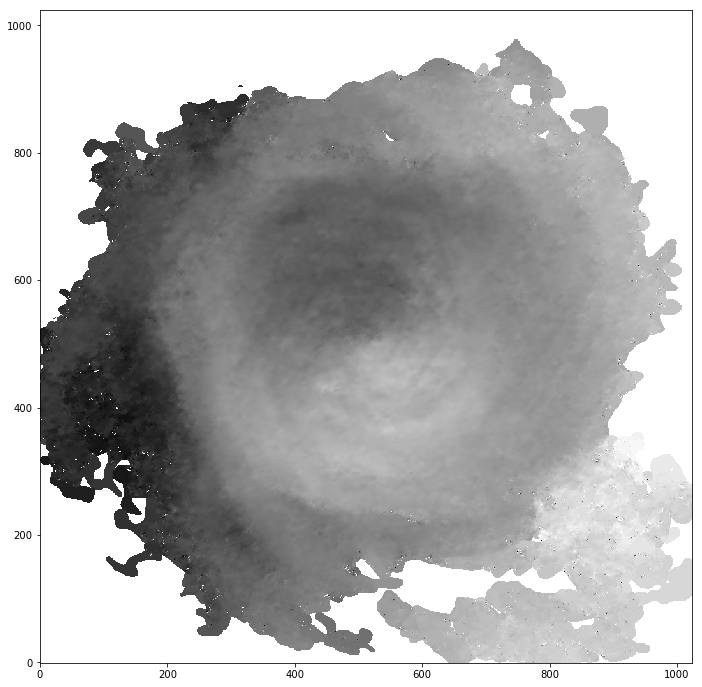

In [133]:
fig = plt.figure(figsize=[12,12])
data = fits.getdata('NGC_628_NA_MOM1_THINGS.FITS')
plt.imshow(np.squeeze(data), origin='lower', cmap='gist_yarg')
plt.show()

In [134]:
data = np.squeeze(data)
data = np.nan_to_num(data)

In [135]:
veloc_norm = lambda l: (l/1000. - 659.1)/sin_i
Z = veloc_norm(data)

In [136]:
v_HI = Z

In [137]:
np.save('v_HI.npy', v_HI)

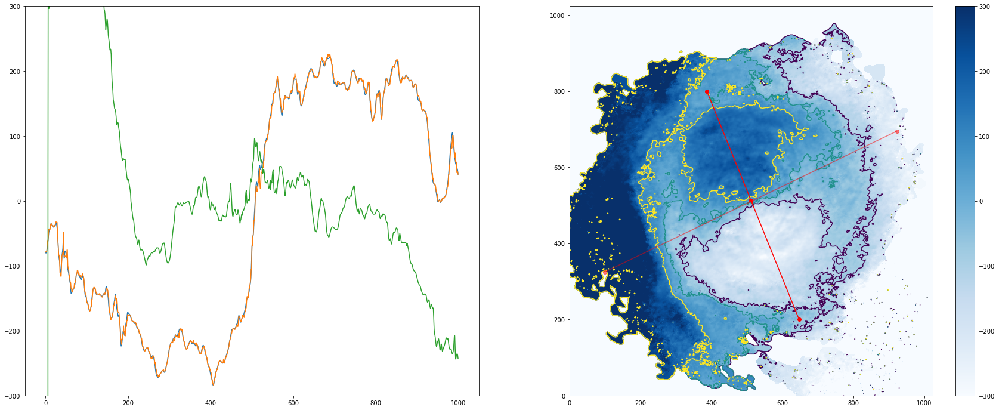

In [138]:
# https://stackoverflow.com/questions/7878398/how-to-extract-an-arbitrary-line-of-values-from-a-numpy-array
import scipy.ndimage

#-- Extract the line...
# Make a line with "num" points...
x0, y0 = 647, 200 # These are in _pixel_ coordinates!!
x1, y1 = 387, 800
num = 1000
x, y = np.linspace(x0, x1, num), np.linspace(y0, y1, num)

# Extract the values along the line, using cubic interpolation
zi = scipy.ndimage.map_coordinates(v_HI, np.vstack((y,x)))
zi_cub = v_HI[y.astype(np.int), x.astype(np.int)]


x0_, y0_ = 100, 325 # These are in _pixel_ coordinates!!
x1_, y1_ = 923, 695
num = 1000
x_, y_ = np.linspace(x0_, x1_, num), np.linspace(y0_, y1_, num)
zi_ = scipy.ndimage.map_coordinates(v_HI, np.vstack((y_,x_)))

#-- Plot...
fig, axes = plt.subplots(ncols=2, figsize = [30, 12])

axes[0].plot(zi)
axes[0].plot(zi_cub)
axes[0].plot(zi_)
axes[0].set_ylim(-300., 300.)
# axes[0].imshow(v_HI)
# axes[1].axis('image')
X,Y = np.meshgrid(np.arange(0.,len(data),1), np.arange(0.,len(data[0]),1))
quadmesh = plt.pcolormesh(X, Y, v_HI, cmap=cm.Blues)
quadmesh.set_clim(vmin=-300., vmax=300.)
plt.colorbar()
# axes[1].imshow(v_HI[::-1, ])
CS = plt.contour(X, Y, v_HI, levels=[-100., 0., 100.])
axes[1].plot([x0, x1], [y0, y1], 'ro-')
axes[1].plot([x0_, x1_], [y0_, y1_], 'ro-', alpha=0.5)
axes[1].scatter([512.,], [512.,], [30.,], marker='s', color='r')
plt.show()

Сделаем, чтобы расстояния примерно соответствовали нужным (потому как на картинке слева - не верна общая длинна):

In [139]:
sqrt((647.-387.)**2 + (200.-800.)**2) * 1520./1024.

970.64959925363905

In [140]:
r_g, vel_g = zip(*sorted(zip(np.abs(np.linspace(0., 970.6, 1000)-970.6/2), np.abs(zi))))

In [146]:
np.save('r_g.npy', r_g)
np.save('vel_g.npy', vel_g)

In [141]:
herrman2009_vc=[0.002107968676327232, 1.8461367775815631,
0.9211823115540909, 6.761771803145308,
2.389733822727237, 12.903726851637828,
4.225071883580966, 20.273481199323243,
5.876314013368969, 26.4139569715517,
7.162877562152744, 33.17277022216879,
8.630023760875005, 38.08396741894032,
9.915181997207867, 43.61202281783639,
11.930400051774697, 48.51878218581564,
12.666081119812134, 52.820517561782935,
14.316620593374722, 58.34561440815084,
16.150553341777538, 64.48461090411519,
18.16577139634434, 69.39137027209442,
19.999001488521742, 74.91498784219823,
22.197612817928857, 80.4356468597739,
23.846746979040518, 84.72998585442076,
25.67927441499249, 89.63822449866407,
27.87648043194868, 93.92812566451867,
29.891698486515494, 98.8348850324979,
32.27089246586111, 102.50792799622789,
34.83418237627244, 107.41024953541485,
36.84729246216288, 110.47087212581249,
39.22789175395938, 115.37467294126353,
42.522646795055536, 120.88645630125467,
45.44991263024566, 124.5550614361924,
49.1100489085715, 130.06388624365536,
53.49954234890582, 134.3360360943409,
56.975582696165915, 138.6155823263469,
60.2675271123603, 141.66584998289593,
63.3760782537144, 144.10221798984853,
67.39948780059358, 147.76194746720174,
70.50803894194767, 150.19831547415433,
73.7992807019166, 152.63320420484285,
75.99297343774562, 153.84621074139486]

In [142]:
leroy2011_vc = [5.327946127946127, 1.941747572815558,
6.6599326599326645, 14.5631067961165,
7.991919191919187, 28.155339805825264,
8.65791245791246, 42.718446601941764,
10.655892255892255, 52.42718446601944,
11.321885521885527, 66.01941747572818,
12.653872053872057, 78.64077669902912,
15.983838383838382, 94.17475728155341,
17.315824915824912, 107.76699029126215,
19.313804713804707, 118.44660194174757,
22.643771043771046, 131.06796116504856,
25.97373737373737, 137.86407766990294,
29.96969696969696, 147.5728155339806,
35.96363636363636, 159.2233009708738,
40.625589225589216, 166.99029126213594,
44.62154882154882, 172.81553398058253,
51.947474747474736, 179.61165048543688,
58.6074074074074, 187.37864077669903,
65.93333333333334, 190.29126213592235,
73.92525252525252, 192.23300970873788,
81.91717171717173, 196.11650485436894,
87.9111111111111, 197.0873786407767,
96.56902356902356, 198.05825242718447,
107.22491582491583, 198.05825242718447,
121.2107744107744, 200.97087378640776,
129.86868686868686, 200,
139.85858585858585, 200,
149.1824915824916, 200,
162.5023569023569, 200,
171.82626262626263, 199.02912621359224,
181.81616161616162, 199.02912621359224,
191.8060606060606, 200,
201.12996632996632, 199.02912621359224,
211.7858585858586, 201.94174757281553,
223.77373737373733, 199.02912621359224,
232.43164983164985, 199.02912621359224,
241.08956228956225, 199.02912621359224,
252.41144781144783, 199.02912621359224,
261.7353535353535, 200,
270.39326599326597, 199.02912621359224,
281.7151515151515, 198.05825242718447,
289.0410774410774, 200]

In [143]:
suwannajak2014_vc = [0.18715761885325177, 30.105909901394284,
0.23961846656211838, 42.149133171496715,
0.2919504178392671, 52.688564738232856,
0.32713914369803954, 63.22369975724507,
0.3966143203935646, 73.76742787170508,
0.4490751681024303, 85.81065114180751,
0.5184214483662384, 94.85058755290123,
0.5707533996433876, 105.39001911963737,
0.6402285763389126, 115.93374723409732,
0.6921738383209095, 121.96180369073448,
0.7956776729897537, 129.5065414939096,
0.8650239532535617, 138.54647790500326,
0.9515134589357461, 147.59071086382096,
1.0204730499044024, 152.11927216481553,
1.124105781004963, 161.16780167135704,
1.210208597391997, 165.7006595200756,
1.3135835356291237, 171.7416056198844,
1.3825431265977786, 176.27016692087903,
1.5374766375217526, 183.82779436722592,
1.675138026595631, 189.87733356248253,
1.7953983973877001, 192.91499280328253,
1.898515542761392, 195.94835549635866,
2.018775913553461, 198.98601473715865,
2.1561795097639056, 202.02797052568263,
2.2764398805559747, 205.06562976648263,
2.4137145803347018, 206.6037938516402,
2.5682614019635226, 209.650046187888,
2.6882639798921577, 209.6801220219553,
2.842681905089261, 211.2225826548368,
2.996970933854648, 211.2612515843519,
3.1513888590517523, 212.8037122172334,
3.30567788781714, 212.84238114674855,
3.4600958130142443, 214.38484177963,
3.631656963629723, 215.93159896023548,
3.7516595415583582, 215.96167479430278,
3.9402350211604977, 216.00893681926573,
4.094524049925885, 216.04760574878088,
4.265956304109648, 216.0905712260199,
4.437646351156847, 219.14112010999162,
4.5919353799222336, 219.17978903950677,
4.746224408687621, 219.21845796902193,
4.831940535779502, 219.23994070764144,
5.003372789963266, 219.28290618488046,
5.140518593310276, 219.3172785666717,
5.311950847494039, 219.3602440439107,
5.449096650841049, 219.39461642570194,
5.603256783174718, 217.92949365185075,
5.706116135684978, 217.95527293819418]

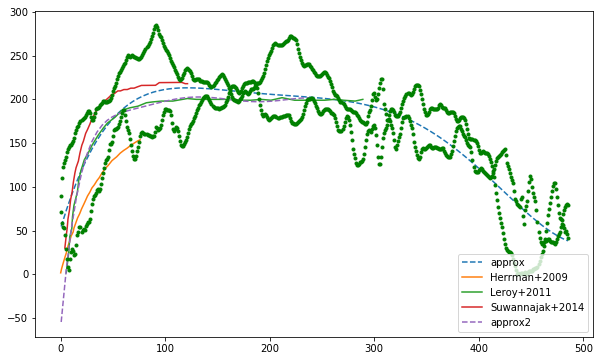

In [144]:
import scipy.interpolate as inter
fig = plt.figure(figsize=[10, 6])
gas_approx = poly1d(polyfit(r_g, vel_g, deg=5))
test_points = np.linspace(min(r_g), max(r_g), 100)
plt.plot(test_points, gas_approx(test_points), '--', label='approx')

plt.plot(herrman2009_vc[0::2], herrman2009_vc[1::2], '-', label='Herrman+2009')
plt.plot(leroy2011_vc[0::2], leroy2011_vc[1::2], '-', label='Leroy+2011')
plt.plot(map(lambda l: l/calc_scale(9.7), suwannajak2014_vc[0::2]), suwannajak2014_vc[1::2], '-', label='Suwannajak+2014')

gas_approx2 = poly1d(polyfit(leroy2011_vc[0::2], leroy2011_vc[1::2], deg=7))
plt.plot(test_points[:-50], gas_approx2(test_points[:-50]), '--', label='approx2')

plt.plot(r_g, vel_g, 'g.')
# plt.ylim(0, 300)
plt.legend(loc='lower right');

Данные хорошо согласуются (похоже, что две работы фитировали только одну сторону кривой) и извлеченный профиль тоже на них похож (отличия есть, но это все не так существенно).

Эпициклическая частота:

$$\kappa=\sqrt{2}\frac{\vartheta_c}{R}\sqrt{1+\frac{R}{\vartheta_c}\frac{d\vartheta_c}{dR}}$$

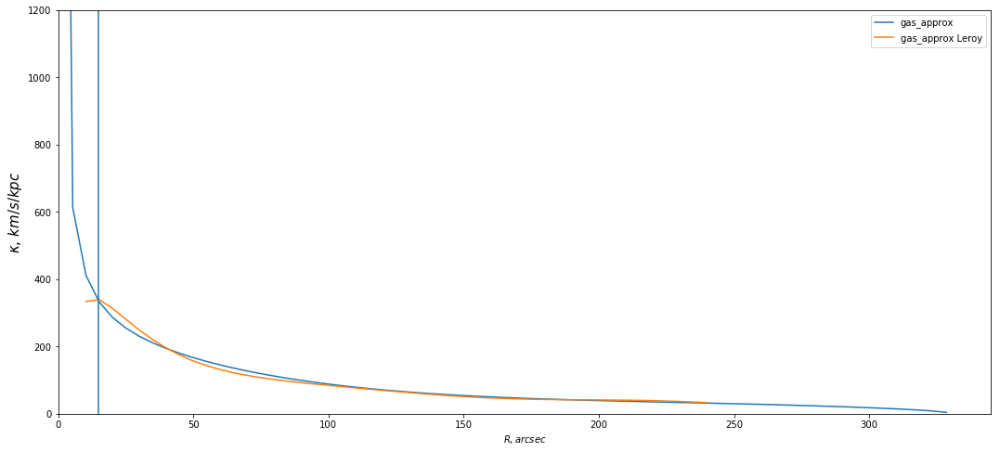

In [145]:
def epicyclicFreq_real(poly_gas, R, resolution):
    '''Честное вычисление эпициклической частоты на расстоянии R для сплайна или полинома'''
    try:
        return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.deriv()(R) / poly_gas(R)) / (R * resolution )
    except:
        return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.derivative()(R) / poly_gas(R)) / (R * resolution )

fig = plt.figure(figsize=[18, 8])
plt.plot(test_points, [epicyclicFreq_real(gas_approx, x, scale) for x in test_points], '-', label='gas_approx')
plt.plot(test_points[2:-50], [epicyclicFreq_real(gas_approx2, x, scale) for x in test_points[2:-50]], '-', label='gas_approx Leroy')

# plt.plot(r_g_dens[1:], ef, '--')
plt.xlabel('$R, arcsec$')
plt.ylabel('$\kappa,\, km/s/kpc$', fontsize=15)
plt.xlim(0)
plt.axvline(x=15.) #bulge
plt.ylim(0, 1200.)
plt.legend()

## SFR (VENGA, H$\alpha$)

Есть картинка Лероя где больше в центре и не удается восстановить из colorbar правильную шкалу и есть JCMT $H_{\alpha}$ изображение, где видно что оно хорошо накладывается на $HI$ картинку 

Это все хорошо, но мы будем использовать $log(\Sigma_{SFR})$ Dust Corrected H$\alpha$ [$M_{\odot} yr^{-1} kpc^{-1}$] из http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf.

А точнее FITS, дюбезно предоставленный Бланком

* http://iopscience.iop.org/article/10.1088/0004-637X/737/2/67/pdf
* http://iopscience.iop.org/article/10.1088/0004-637X/741/2/124/pdf

Murphy (2011) - первая ссылка: $$\frac{SFR}{M_{\odot}yr^{-1}} = 5.37\times 10^{-42} \frac{L_{H\alpha}}{erg \times s^{-1}}$$

(хотя например Kennicutt там может до 7.9 коэффециент давать http://iopscience.iop.org/article/10.1088/0004-637X/703/2/1672/pdf)

Проблема пересчитать в том, что я не знаю какие единицы в их фитсе - но скорее всего erg/s/cm^2.

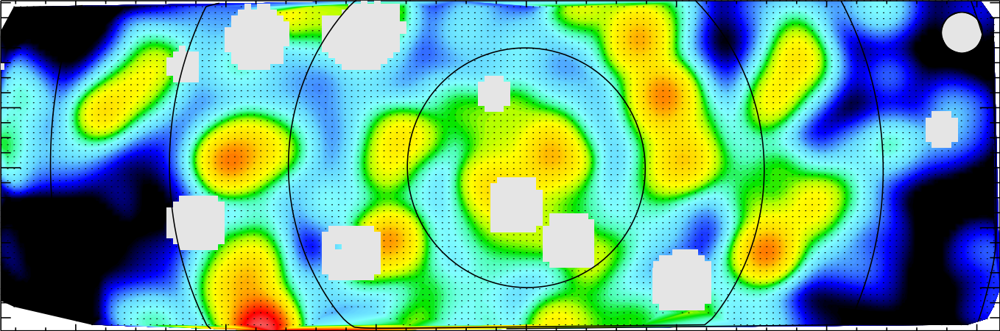

In [90]:
Image('VENGA_Halpha_SFR.png')

А вот как выглядит исходная картинка из другой статьи:

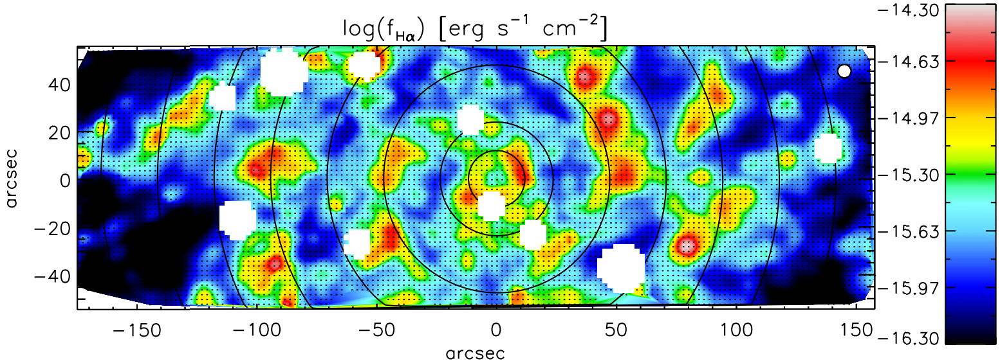

In [12]:
Image('VENGA_Halpha.png')

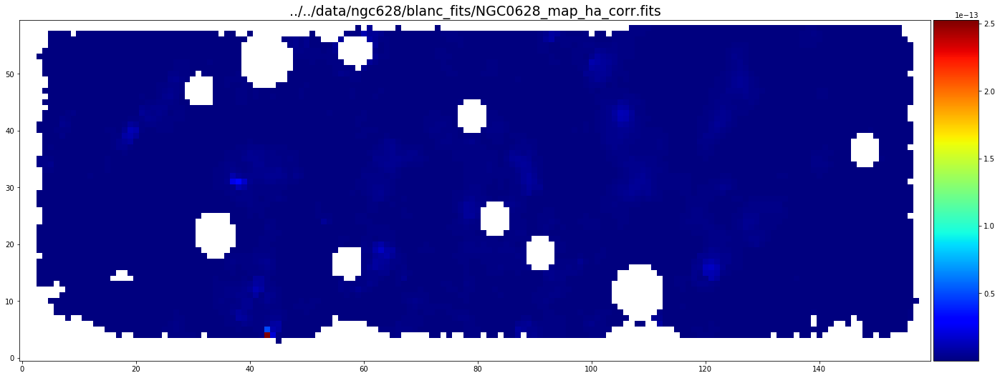

In [129]:
from astropy.io import fits
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig = plt.figure(figsize=[24,16])
ax = plt.gca()
fname = '../../data/ngc628/blanc_fits/NGC0628_map_ha_corr.fits'
data = fits.getdata(fname)
im = plt.imshow(np.squeeze(data), origin='lower', cmap='jet')

plt.title(fname, fontsize=19)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax)

plt.show()

In [38]:
np.save('Halpha_SFR_.npy', np.squeeze(np.log(data))[4:-1, 3:-2])

In [128]:
log_Halpha_SFR_ = np.load('Halpha_SFR_.npy')

SFR contours:

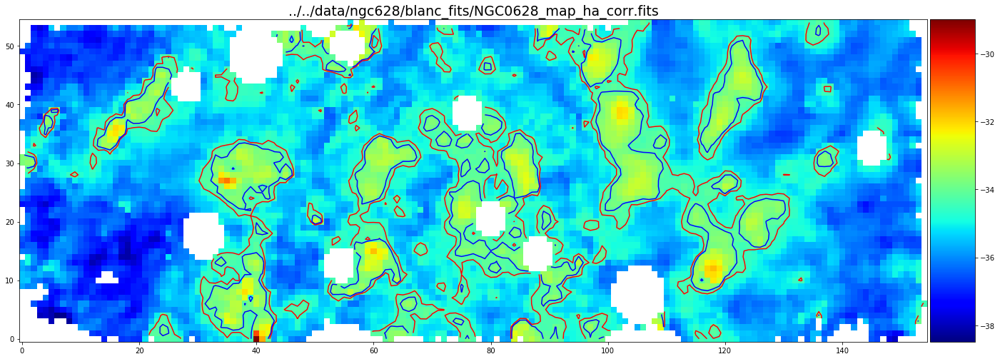

In [40]:
def add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'), X=None, Y=None):
#     X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
    if X is None and Y is None:
        X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
    CS = plt.contour(X, Y, log_Halpha_SFR_, levels=levels, colors=colors)
#     CS3 = plt.contourf(X, Y, log_Halpha_SFR_, [-1., -0.8], colors=('white'))

fig = plt.figure(figsize=[24,16])
ax = plt.gca()
im = plt.imshow(np.squeeze(np.log(data))[4:-1, 3:-2], origin='lower', cmap='jet')

add_SFR_contours()

# X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
# CS = plt.contour(X, Y, np.squeeze(np.log(data))[4:-1, 3:-2], levels=[-35., -34.], colors=('red', 'blue'))

plt.title(fname, fontsize=19)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)

plt.colorbar(im, cax=cax)

plt.show()

In [79]:
np.nanmax(np.squeeze(np.log(data))[4:-1, 3:-2]), np.nanmin(np.squeeze(np.log(data))[4:-1, 3:-2])

(-29.006720572856008, -38.479363177748063)

How to mark stars - two ways, proper and less (есть разница в шкалах, делать для imshow или pcolormesh):

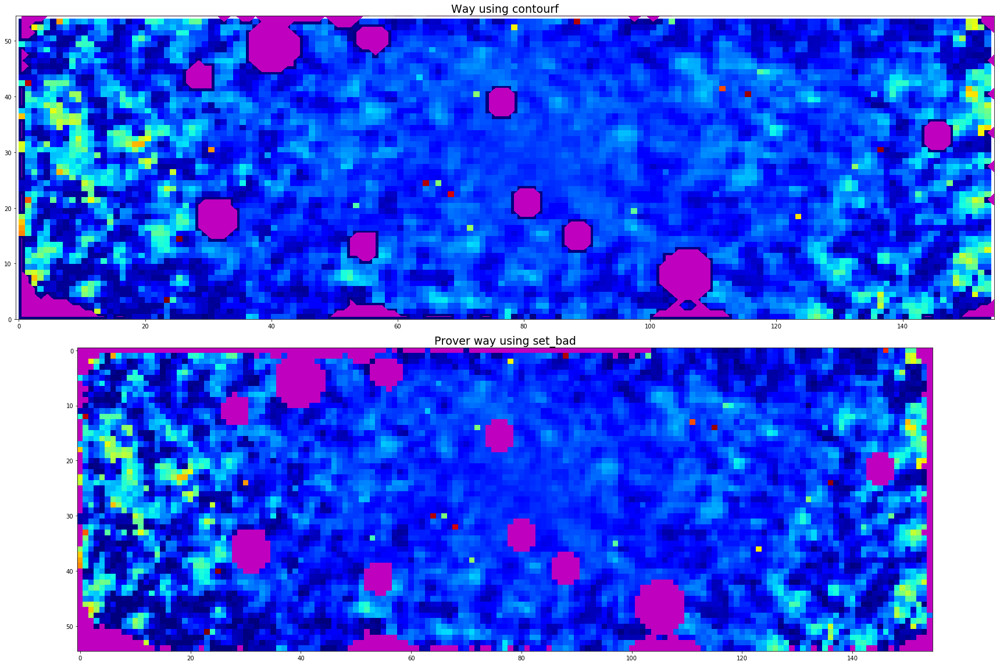

In [212]:
def mark_stars(colors=('white'), levels=[-28.1, -28.]):
    X,Y = np.meshgrid(np.arange(0.5,Nx+0.5,1), np.arange(0.5,Ny+0.5,1))
    mask = sig_los == 0
    
#     mask = np.ma.masked_where(sig_los>250, sig_los)
#     CS = plt.contour(X, Y, mask, levels=[0.99, 1.0], colors=colors, interpolation='none', origin='lower')
    CS3 = plt.contourf(X, Y, mask, levels, colors=colors, interpolation='none')

X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))

fig = plt.figure(figsize=[24,16])    
ax = fig.add_subplot(211)
# im = ax.imshow(sig_los, interpolation='none', cmap='jet')
quadmesh2 = ax.pcolormesh(X, Y, sig_los, cmap=cm.jet)
mark_stars(colors=('m'), levels=[0.999, 1.001])
ax.set_title('Way using contourf', fontsize=19)
ax.set_xlim(-0.5)

ax = fig.add_subplot(212)
masked_array = np.ma.array(sig_los, mask=sig_los == 0)
cmap = matplotlib.cm.jet
cmap.set_bad('m',1.)
ax.imshow(masked_array[::-1, :], interpolation='nearest', cmap=cmap)
ax.set_title('Prover way using set_bad', fontsize=19)
ax.set_xlim(-0.5)

fig.subplots_adjust(wspace=0.0, hspace=0.0)
plt.tight_layout()
plt.show()

In [106]:
log_Halpha_SFR_[21, 31], log_Halpha_SFR_[21, 80]

(nan, nan)

In [89]:
np.nanmax(data), np.nanmin(data)

(2.5266280723312785e-13, 1.9436806214247678e-17)

In [223]:
np.log10(0.57*0.57), np.log10(0.235*0.235), np.log10(0.086*0.086), np.log10(5.37) 

(-0.48825028865501724,
 -1.2578642754565275,
 -2.1310030975128647,
 0.72997428569955558)

In [94]:
calc_scale(8.6)*1000*10/4.8

86.86254372427983

In [69]:
xxxx = np.nan_to_num(np.squeeze(np.log(data)))

In [72]:
len(xxxx.ravel())

9600

In [83]:
xxx = np.squeeze(np.log(data))

In [87]:
np.nanmax(xxx), np.nanmin(xxx)

(-29.006720572856008, -38.479363177748063)

In [ ]:
Halpha_SFR_

## Плотность $\Sigma_{\rm CO}$ (VENGA, HERACLES)

В http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf выбор из трех возможностей:

* HERACLES, CO(2–1) beam size of $13.6$ and rms noise of ∼22 mK per 2.6 km s−1 channel, which translates into a 1σ limit on the molecular gas surface density of $\Sigma_{H2}\approx 3 M_{\odot} pc^{-2}$
* BIMA-SONG, robust beam size of $6.2$, and rms noise of 51 mJy beam−1 in a 10 km s−1 channel or $\Sigma_{H2}\approx 13 M_{\odot} pc^{-2}$
* CARMA, CO(1–0) has a spatial resolution of $3.6$ and rms noise of ∼20 mJy beam−1 in a 10 km s−1 channel $\Sigma_{H2}\approx 5 M_{\odot} pc^{-2}$

Т.о. лучше HERACLES, поскольку в смысле пространственного разрешения они все приведены к одному
>We
convolve the BIMA-SONG and CARMA maps with a Gaussian
kernel to match the 13.6 arcsec PSF of the HERACLES map, which
corresponds to ∼570 pc at the assumed distance to NGC 0628.

TODO: учеть другой угол и расстояние - у них For NGC 628, we assume an inclination of i = 8.7 and a distance of 8.6 Mpc (Herrmann et al. 2008).

Теперь поверхностные плотности. 

Leroy делал $$\Sigma_{H_2} = 4.4\cos i \times I_{CO(1-0)}$$ $$\Sigma_{H_2} = 5.5\cos i \times I_{CO(2-1)}$$ для $X_{CO}=2\times10^{20}$

В HERACLES $CO(2-1)$ изначально, но карта в статье уже переведена в $CO(1-0)$, так что используем первую формулу.

Сравним с 2008м годом:

In [96]:
H2_raw = ImagePIL.open('Leroy_H2_scaled.png')
colorbar = ImagePIL.open('Leroy_HI_colorbar.png')
cw, ch = colorbar.width, colorbar.height
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 10:11, :].reshape(ch, 4)

In [114]:
fname = '../../data/ngc628/ngc0628_heracles_mom0.fits'
data = np.squeeze(fits.getdata(fname))
data = data*5.5*cos_i

In [98]:
%%time
Z = image_map_to_colorbar(H2_raw, colorbar, 33.89, 1.)

Wall time: 55.1 s


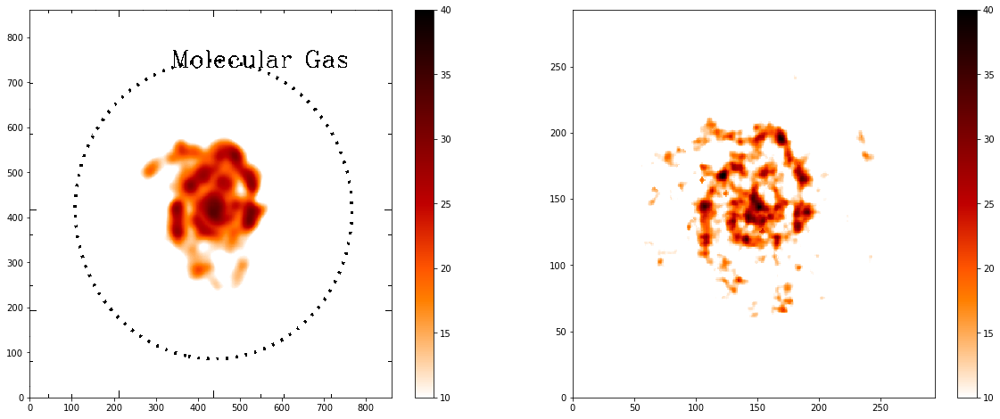

In [120]:
X,Y = np.meshgrid(np.arange(0.,862,1), np.arange(0.,862,1))

plt.figure(figsize=[20, 8])
plt.subplot(1, 2, 1)
quadmesh = plt.pcolormesh(X, Y, Z*2, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=40.)
plt.colorbar()

plt.subplot(1, 2, 2)
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))

quadmesh = plt.pcolormesh(X, Y, data, cmap=cm.gist_heat_r)
quadmesh.set_clim(vmin=10.0, vmax=40.)
plt.colorbar()

Видно, что разница примерно в два раза по оценкам - что-то Leroy сделал не так в своей работе, поскольку позже в [Leroy 2015](http://iopscience.iop.org/article/10.1088/0004-637X/808/1/99/pdf) плотности уже до 40 $M_{\odot}pc^{-2}$ (может ли это быть связано с разрешением?).

Причем это верно и для снятой картинки со статьи.

http://iopscience.iop.org/article/10.1088/0004-6256/137/6/4670/pdf

- NAME_heracles.hans.fits - the data cube
- NAME_heracles_mom0.fits - the integrated intensity map
- NAME_heracles_emom0.fits - uncertainty in the integrated intensity map
- NAME_heracles_mom1.fits - the velocity field

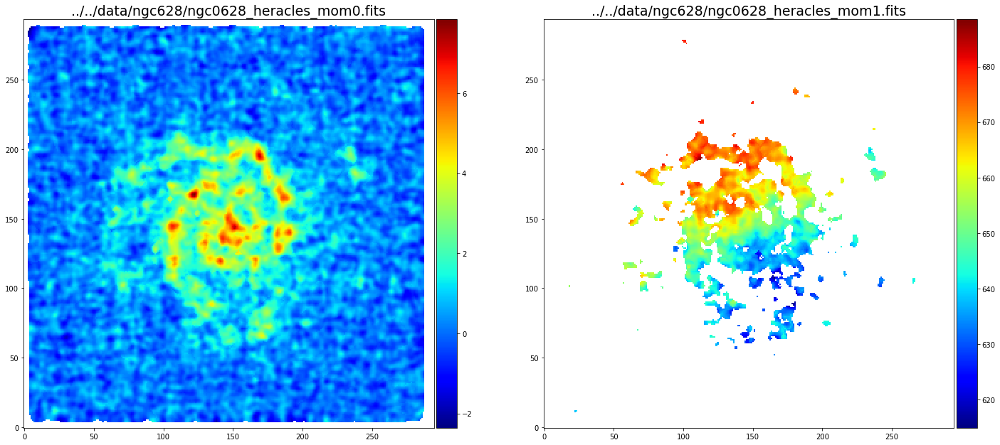

In [9]:
from astropy.io import fits
from mpl_toolkits.axes_grid1 import make_axes_locatable

fig = plt.figure(figsize=[24,16])
plt.subplot(121)
ax = plt.gca()
fname = '../../data/ngc628/ngc0628_heracles_mom0.fits'
data = fits.getdata(fname)
im = plt.imshow(np.squeeze(data), origin='lower', cmap='jet')

plt.title(fname, fontsize=19)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(im, cax=cax)

plt.subplot(122)
ax = plt.gca()
fname = '../../data/ngc628/ngc0628_heracles_mom1.fits'
data = fits.getdata(fname)
im = plt.imshow(np.squeeze(data), origin='lower', cmap='jet')

plt.title(fname, fontsize=19)
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.05)
plt.colorbar(im, cax=cax)
plt.show()

Нужная нам область (для перевода из BUNIT = 'K KM/S'/Tmb, integrated over line используем формулу выше, она же (4) в статье о HERACLES):

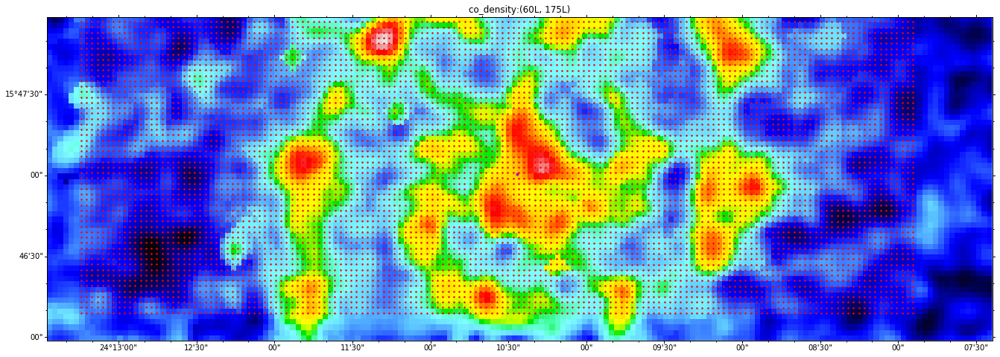

Wall time: 3min 13s


In [121]:
%%time
cutout = plot_cutout('../../data/ngc628/ngc0628_heracles_mom0.fits', size=size, coordinates=True, figsize=[24, 8], title='co_density', cmap='sauron')

co_grid_pixs = []
Sigma_CO_cut = []
for scoord in sgrid.ravel():
    spix = skycoord_to_pixel(scoord, cutout.wcs)
    co_grid_pixs.append(spix)
    Sigma_CO_cut.append(cutout.data[int(spix[1])][int(spix[0])]*5.5*cos_i)
plt.plot(zip(*co_grid_pixs)[0],  zip(*co_grid_pixs)[1], '.', ms=3, color='r')
plt.show()

In [122]:
len(co_grid_pixs)

8525

Площадка еще раз

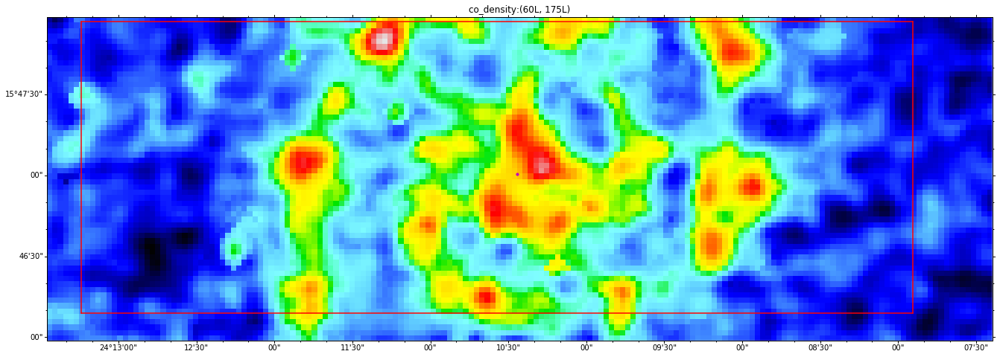

In [123]:
cutout = plot_cutout('../../data/ngc628/ngc0628_heracles_mom0.fits', size=size, coordinates=True, figsize=[24, 8], title='co_density', cmap='sauron')
plot_rectange_from_grid(plt.gca(), co_grid_pixs)
plt.show()

In [124]:
Sigma_CO_cut = np.array(Sigma_CO_cut).reshape((55, 155))

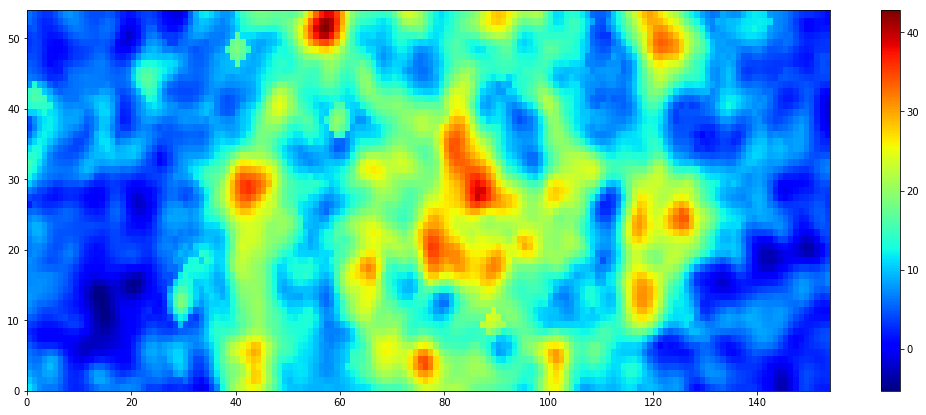

In [125]:
plt.figure(figsize=[18, 7])
X,Y = np.meshgrid(np.arange(0.,155,1), np.arange(0.,55,1))
Z = Sigma_CO_cut
quadmesh = plt.pcolormesh(X, Y, Z, cmap='jet')
plt.colorbar()
quadmesh.cmap.set_under('white')

In [126]:
np.save('Sigma_CO_cut.npy', Sigma_CO_cut)

## Плотность $\Sigma_{\rm s}$ (S4G)

другая возможность - использовать cleaned stellar fits из http://irsa.ipac.caltech.edu/data/SPITZER/S4G/docs/P5_README.html чтобы восстановить с помощью работы [Querejeta et al. (2014)](https://ui.adsabs.harvard.edu/#abs/2014ASPC..486..143Q/abstract)

Используем ровно ту методику, что Leroy применил в своей работе к S4G данным: $$\Sigma_s = 280\cos i\times I_{3.6}$$

TODO: проверить, что именно к ним, добавить разрешение кубов, размеры бима

По поводу разрешения - Саша Мосенков пишет:

> Берется средняя 1.66" для всех галактик, отдельно для каждой ты не найдешь. 

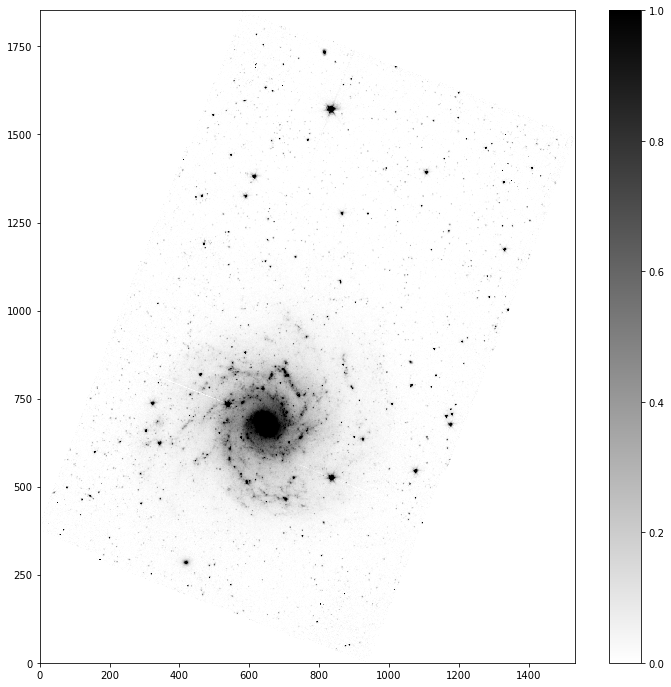

In [12]:
data = fits.getdata('NGC0628.phot.1_nonan.fits')
data = squeeze(data)
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))
Z = data

plt.figure(figsize=[12, 12])
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=0., vmax=1.)

plt.colorbar()

Слудеум Leroy (2008) c его постоянной M/L в $K$: $$\Sigma = 280\times\cos i\times I_{36}$$

Уже проверяли в другом документе по приближенной площадке, что похоже очень на его данные (надеюсь SIP distortion ничего не ломает, его отключили).

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


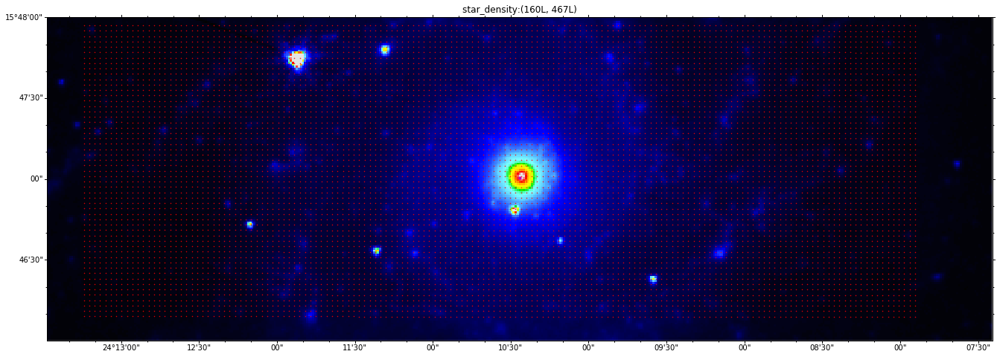

Wall time: 2min 26s


In [13]:
%%time
cutout = plot_cutout('NGC0628.phot.1_nonan.fits', size=size, coordinates=True, figsize=[24, 8], title='star_density', cmap='sauron', vmax=10.)

star_grid_pixs = []
Sigma_s_cut = []
for scoord in sgrid.ravel():
    spix = skycoord_to_pixel(scoord, cutout.wcs)
    star_grid_pixs.append(spix)
    Sigma_s_cut.append(cutout.data[int(spix[1])][int(spix[0])]*280.*cos_i)
plt.plot(zip(*star_grid_pixs)[0],  zip(*star_grid_pixs)[1], '.', ms=1, color='r')
plt.show()

In [143]:
len(star_grid_pixs)

8525

Площадка еще раз

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


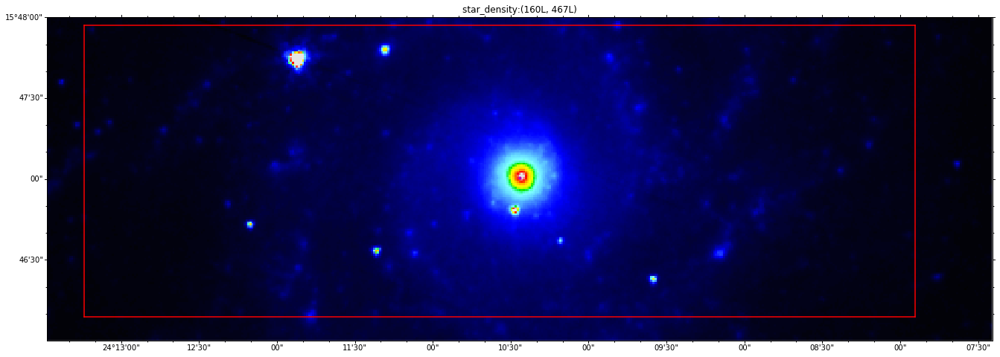

In [147]:
cutout = plot_cutout('NGC0628.phot.1_nonan.fits', size=size, coordinates=True, figsize=[24, 8], title='star_density', cmap='sauron', vmax=10.)
plot_rectange_from_grid(plt.gca(), star_grid_pixs)
plt.show()

INFO: 
                Inconsistent SIP distortion information is present in the FITS header and the WCS object:
                SIP coefficients were detected, but CTYPE is missing a "-SIP" suffix.
                astropy.wcs is using the SIP distortion coefficients,
                therefore the coordinates calculated here might be incorrect.

                If you do not want to apply the SIP distortion coefficients,
                please remove the SIP coefficients from the FITS header or the
                WCS object.  As an example, if the image is already distortion-corrected
                (e.g., drizzled) then distortion components should not apply and the SIP
                coefficients should be removed.

                While the SIP distortion coefficients are being applied here, if that was indeed the intent,
                for consistency please append "-SIP" to the CTYPE in the FITS header or the WCS object.

                 [astropy.wcs.wcs]


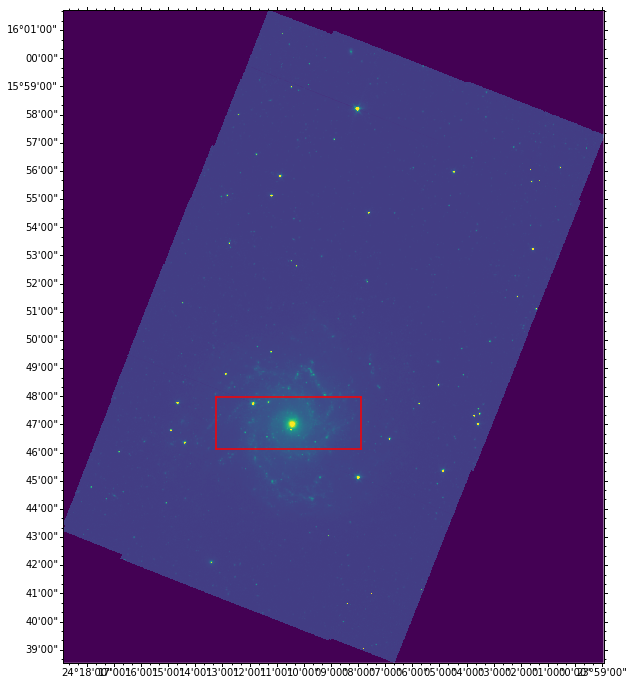

In [23]:
X,Y = np.meshgrid(np.arange(0.,len(data[0]),1), np.arange(0.,len(data),1))

fig = plt.figure(figsize=[12,12])

w = WCS('NGC0628.phot.1_nonan.fits', naxis=2)
ax = fig.add_subplot(111, projection=w)
im = ax.imshow(data, origin='lower', vmax=5.)

lon = ax.coords[0]
lat = ax.coords[1]

lon.set_major_formatter('dd:mm:ss')
lat.set_major_formatter('dd:mm:ss')

lon.set_ticks(spacing=60. * u.arcsec)
lat.set_ticks(spacing=60. * u.arcsec)

lon.display_minor_ticks(True)
lat.display_minor_ticks(True)
lat.set_minor_frequency(3)
lon.set_minor_frequency(3)

# star_grid_pixs_ = []
# for scoord in sgrid.ravel():
#     spix = skycoord_to_pixel(scoord, w)
#     star_grid_pixs_.append(spix)

plot_rectange_from_grid(plt.gca(), star_grid_pixs_)
plt.show()

In [145]:
Sigma_s_cut = np.array(Sigma_s_cut).reshape((55, 155))

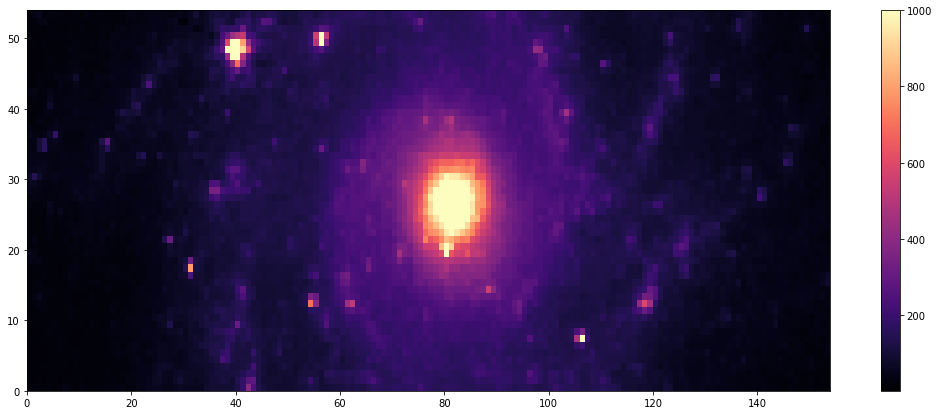

In [149]:
plt.figure(figsize=[18, 7])
X,Y = np.meshgrid(np.arange(0.,155,1), np.arange(0.,55,1))
Z = Sigma_s_cut
quadmesh = plt.pcolormesh(X, Y, Z, cmap='magma')
quadmesh.set_clim(vmin=1., vmax=1000.)
plt.colorbar()
quadmesh.cmap.set_under('white')

In [151]:
np.save('Sigma_s_cut.npy', Sigma_s_cut)

# Все в одном

In [13]:
Sigma_HI_ = np.load('Sigma_HI_cut.npy')
sig_los = np.load('sig_los.npy')
c_g_ = np.load('c_g_cut.npy')
c_CO_ = np.load('c_CO_.npy')
dist_ = np.load('dist.npy')
Sigma_HERACLES_CO_ = np.load('Sigma_CO_cut.npy')
# Sigma_HERACLES_CO_ = np.nan_to_num(Sigma_HERACLES_CO_)
log_Halpha_SFR_ = np.load('Halpha_SFR_.npy')
# Sigma_s = np.load('Sigma_s.npy')
sig_R_max = np.load('sig_R_max.npy')
sig_R_min = np.load('sig_R_min.npy')
Sigma_s_Leroy_ = np.load('Sigma_s_cut.npy')

X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))

r_g = np.load('r_g.npy')
vel_g = np.load('vel_g.npy')
gas_approx = poly1d(polyfit(r_g, vel_g, deg=5))
def epicyclicFreq_real(poly_gas, R, resolution):
    return sqrt(2.0) * poly_gas(R) * sqrt(1 + R * poly_gas.deriv()(R) / poly_gas(R)) / (R * resolution )

def add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'), X=None, Y=None):
#     X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
    if X is None and Y is None:
        X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
    CS = plt.contour(X, Y, log_Halpha_SFR_, levels=levels, colors=colors)
#     CS3 = plt.contourf(X, Y, log_Halpha_SFR_, [-1., -0.8], colors=('white'))

def mark_stars(colors=('white'), levels=[-28.1, -28.]):
    Xm,Ym = np.meshgrid(np.arange(0.5,Nx+0.5,1), np.arange(0.5,Ny+0.5,1))
    mask = sig_los == 0
    CS3 = plt.contourf(Xm, Ym, mask, levels, colors=colors, interpolation='none')

Общая картинка:

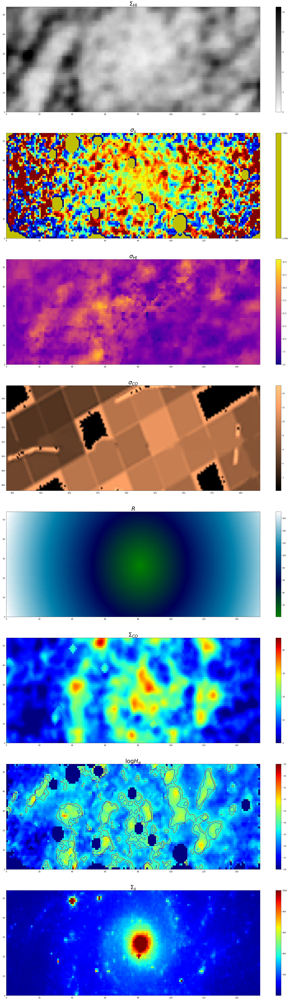

In [175]:
import matplotlib.patches as patches

plt.figure(figsize=[30, 96])
plt.subplot(8, 1, 1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Sigma_HI_, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=10.5)
plt.colorbar()
plt.title(r'$\Sigma_{HI}$', fontsize=30)


plt.subplot(8, 1, 2)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
# CS = plt.contour(X, Y, sig_los, levels=[40., 70.], aspect='auto', alpha=0.5, colors='r')
# plt.clabel(CS, inline=1, fontsize=10)
plt.title(r'$\sigma_{s}$', fontsize=30)
quadmesh2 = plt.pcolormesh(X, Y, sig_los, cmap=cm.jet)
quadmesh2.set_clim(vmin=6., vmax=80.5)
mark_stars(colors=('y'), levels=[0.999, 1.001])
plt.colorbar()

#bulge
circle = plt.Circle((512, 512), 10., color='b', fill=False)
plt.gca().add_artist(circle)


plt.subplot(8, 1, 3)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, c_g_, cmap=cm.plasma)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=5., vmax=25.5)
plt.colorbar()
plt.title(r'$\sigma_{HI}$', fontsize=30)

plt.subplot(8, 1, 4)
X_,Y_ = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X_, Y_, c_CO_, cmap=cm.copper)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=.1, vmax=15.1)
plt.colorbar()
plt.title(r'$\sigma_{CO}$', fontsize=30)

plt.subplot(8, 1, 5)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, dist_, cmap=cm.ocean)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
# quadmesh.set_clim(vmin=.1, vmax=15.1)
plt.colorbar()
plt.title(r'$R$', fontsize=30)

plt.subplot(8, 1, 6)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, Sigma_HERACLES_CO_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0., vmax=45.19)
plt.colorbar()
plt.title(r'$\Sigma_{CO}$', fontsize=30)

plt.subplot(8, 1, 7)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-38., vmax=-29.)
plt.colorbar()
plt.title(r'$\log H_{\alpha}$', fontsize=30)
add_SFR_contours()

plt.subplot(8, 1, 8)
# X,Y = np.meshgrid(xvalues, yvalues)
quadmesh = plt.pcolormesh(X, Y, Sigma_s_Leroy_, cmap=cm.jet)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=1, vmax=1000.)
plt.colorbar()
plt.title(r'$\Sigma_{s}$', fontsize=30)

# X,Y = np.meshgrid(np.arange(0.,len(c_g),1), np.arange(0.,len(c_g[0]),1))
# CS = plt.contour(X[470:560, 380:650], Y[470:560, 380:650], c_g[470:560, 380:650], levels=[5., 10., 20.], aspect='auto', alpha=0.5)

plt.savefig('scaled_maps_column.png', format='png', bbox_inches='tight')
plt.show()

In [47]:
print Sigma_HI_.shape
print sig_los.shape
print c_g_.shape
print c_CO_.shape
print dist_.shape
print Sigma_HERACLES_CO_.shape
print log_Halpha_SFR_.shape
print sig_R_max.shape
print sig_R_min.shape
print Sigma_s_Leroy_.shape

(55L, 155L)
(55L, 155L)
(55L, 155L)
(513L, 1553L)
(55L, 155L)
(55L, 155L)
(55L, 155L)
(55L, 155L)
(55L, 155L)
(55L, 155L)


# Результаты

## $Q$

Было 1553x513≈800000 pix, стало 155x55=8525 т.е. в тысячу раз быстрее.

TODO: можно ли оценить эффект толщины?

TODO: cold phase

In [25]:
%%time

G = 4.32
Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)
bark = np.zeros(dist_.shape)
bark_max = np.zeros(dist_.shape)
Qgs = np.zeros(dist_.shape)
Qss_min = np.zeros(dist_.shape)
Qss_max = np.zeros(dist_.shape)

step = 0
errors = 0
for i, row in enumerate(dist_):
    for j, col in enumerate(dist_[0]):
        step+=1
        if step % 1000 == 0:
            print step
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)
        Qs_min = kappa * s_R_min / (3.36 * G * Sigma_s_)
        
#         print c, Sigma, kappa, Sigma_s_, s_R_max, s_R_min, Qs_min, Qg, c/s_R_min
        
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            errors+=1
            qeff = 0.01
            root_for_max = -1.
        Qeff_min[i][j] = 1./qeff
        bark[i][j] = root_for_max
        
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            errors+=1
            qeff = 0.01
            root_for_max = -1.
        Qeff_max[i][j] = 1./qeff
        bark_max[i][j] = root_for_max
        
        Qgs[i][j] = Qg
        Qss_min[i][j] = Qs_min
        Qss_max[i][j] = Qs_max
        
print 'Errors:{}'.format(errors)

1000
2000
3000
4000
5000
6000
7000
8000
Errors:1490
Wall time: 13.7 s


In [26]:
np.save('Qeff_min.npy', Qeff_min)
np.save('bark.npy', bark)
np.save('Qeff_max.npy', Qeff_max)
np.save('bark_max.npy', bark)
np.save('Qgs.npy', Qgs)
np.save('Qss_min.npy', Qss_min)
np.save('Qss_max.npy', Qss_max)

In [47]:
Qeff_min = np.load('Qeff_min.npy')
bark = np.load('bark.npy')
Qeff_max = np.load('Qeff_max.npy')
bark = np.load('bark_max.npy')
Qgs = np.load('Qgs.npy')
Qss_min = np.load('Qss_min.npy')
Qss_max = np.load('Qss_max.npy')

X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))

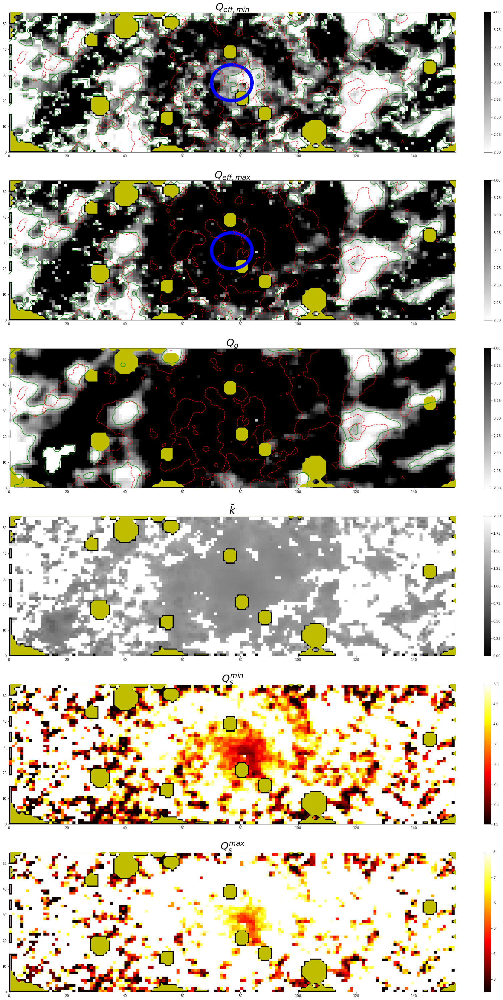

In [49]:
# TODO: понять, откуда берутся контуры внутри звезд и как их убрать

plt.figure(figsize=[30, 54])

plt.subplot(6,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,min}$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
# circle = plt.Circle((512, 512), 10., color='b', fill=False, lw=10)
# plt.gca().add_artist(circle)
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10) #7px approx 15arcsec
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,2)
quadmesh = plt.pcolormesh(X, Y, Qeff_max, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,max}$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))

plt.subplot(6,1,3)
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'$Q_{g}$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5], colors=('red'))

plt.subplot(6,1,4)
quadmesh = plt.pcolormesh(X, Y, bark, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=2.)
plt.colorbar()
plt.title(r'$\bar{k}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(6,1,5)
quadmesh = plt.pcolormesh(X, Y, Qss_min, cmap=cm.hot)
quadmesh.set_clim(vmin=1.5, vmax=5.)
plt.colorbar()
plt.title(r'$Q_{s}^{min}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(6,1,6)
quadmesh = plt.pcolormesh(X, Y, Qss_max, cmap=cm.hot)
quadmesh.set_clim(vmin=2.5, vmax=8.)
plt.colorbar()
plt.title(r'$Q_{s}^{max}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

# plt.savefig('result_maps_column2.png', format='png', bbox_inches='tight')
# plt.show()

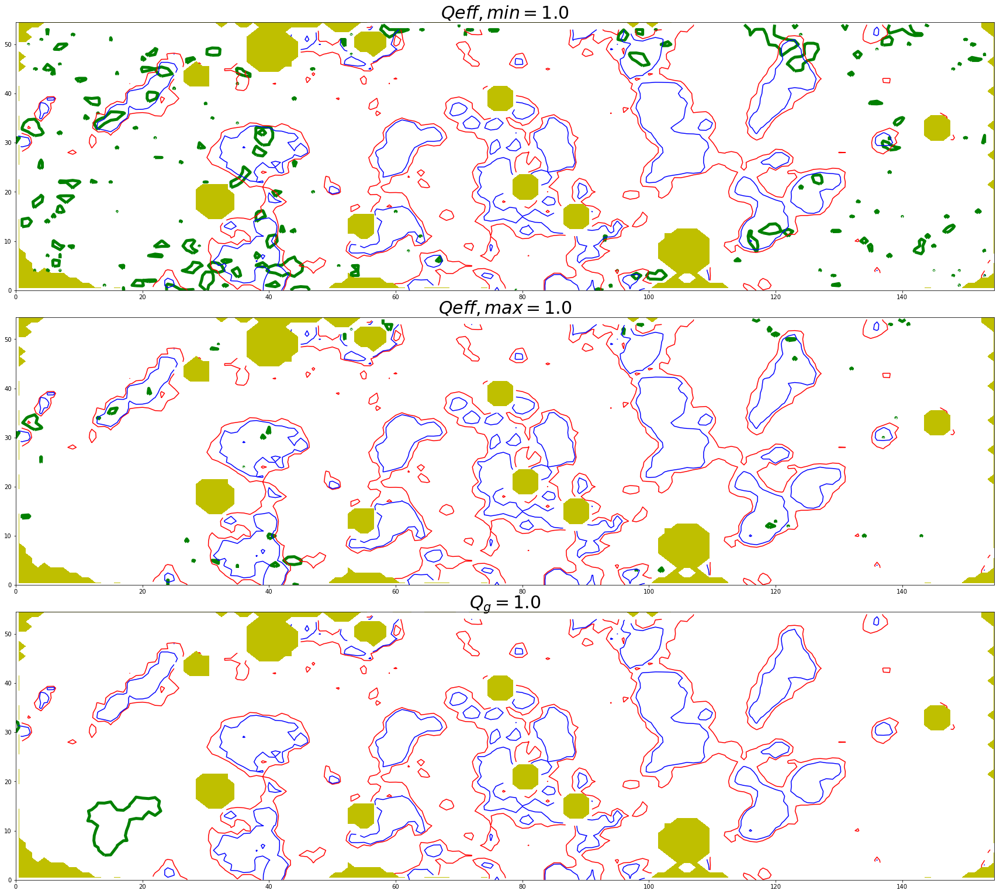

In [215]:
fig = plt.figure(figsize=[30, 27])

q_level = 1.

plt.subplot(3,1,1)
CS = plt.contour(X, Y, Qeff_min, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,min={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,2)
CS = plt.contour(X, Y, Qeff_max, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,max={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,3)
CS = plt.contour(X, Y, Qgs, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Q_g={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

fig.subplots_adjust(wspace=0.0, hspace=0.1)
plt.show()

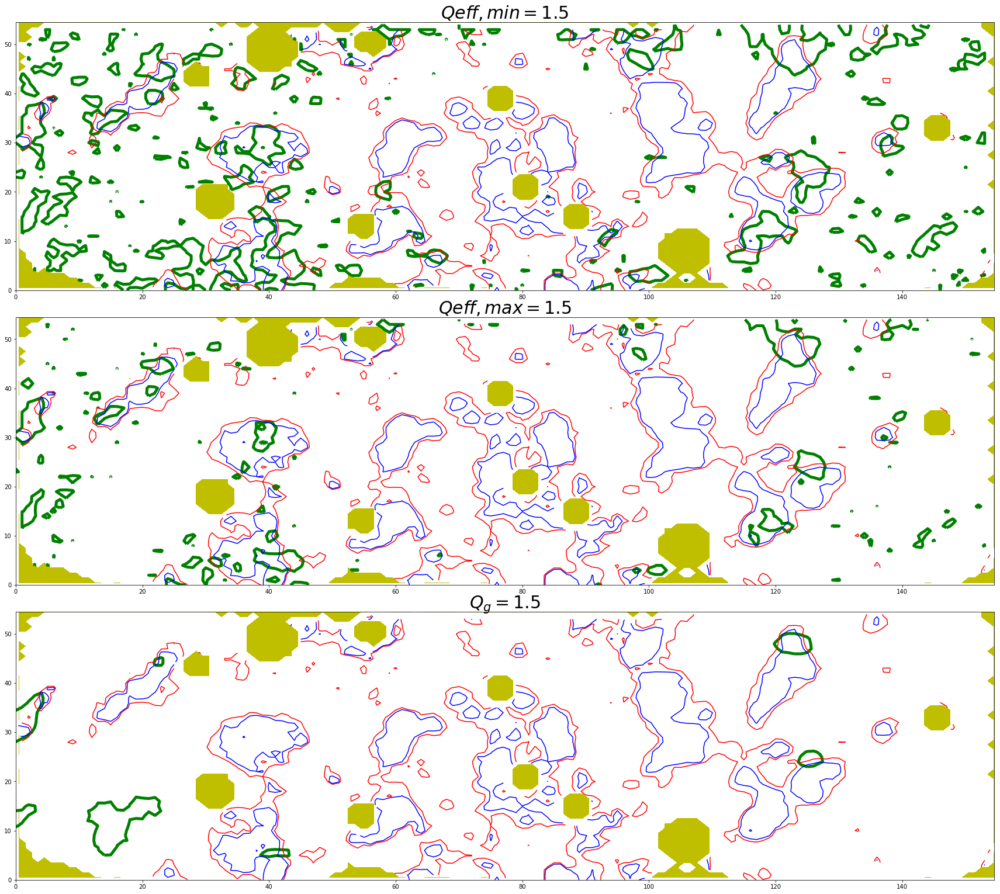

In [216]:
fig = plt.figure(figsize=[30, 27])

q_level = 1.5

plt.subplot(3,1,1)
CS = plt.contour(X, Y, Qeff_min, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,min={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,2)
CS = plt.contour(X, Y, Qeff_max, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,max={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,3)
CS = plt.contour(X, Y, Qgs, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Q_g={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

fig.subplots_adjust(wspace=0.0, hspace=0.1)
plt.show()

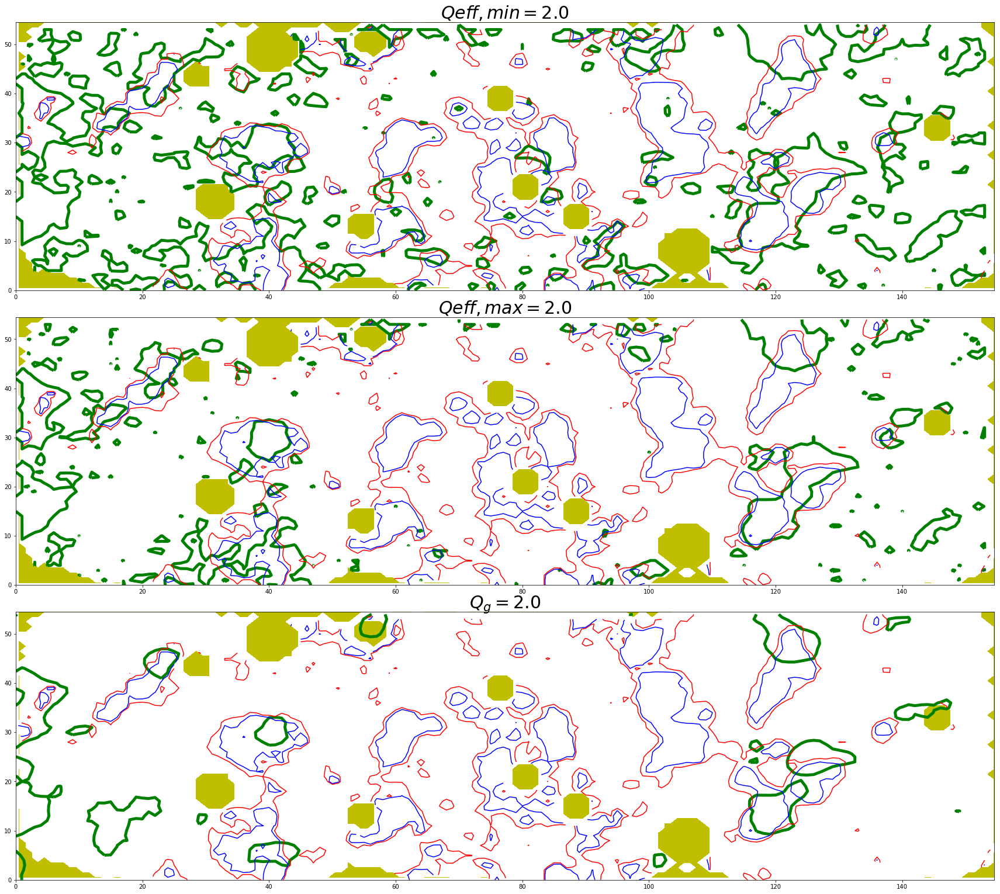

In [217]:
fig = plt.figure(figsize=[30, 27])

q_level = 2.

plt.subplot(3,1,1)
CS = plt.contour(X, Y, Qeff_min, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,min={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,2)
CS = plt.contour(X, Y, Qeff_max, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,max={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,3)
CS = plt.contour(X, Y, Qgs, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Q_g={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

fig.subplots_adjust(wspace=0.0, hspace=0.1)
plt.show()

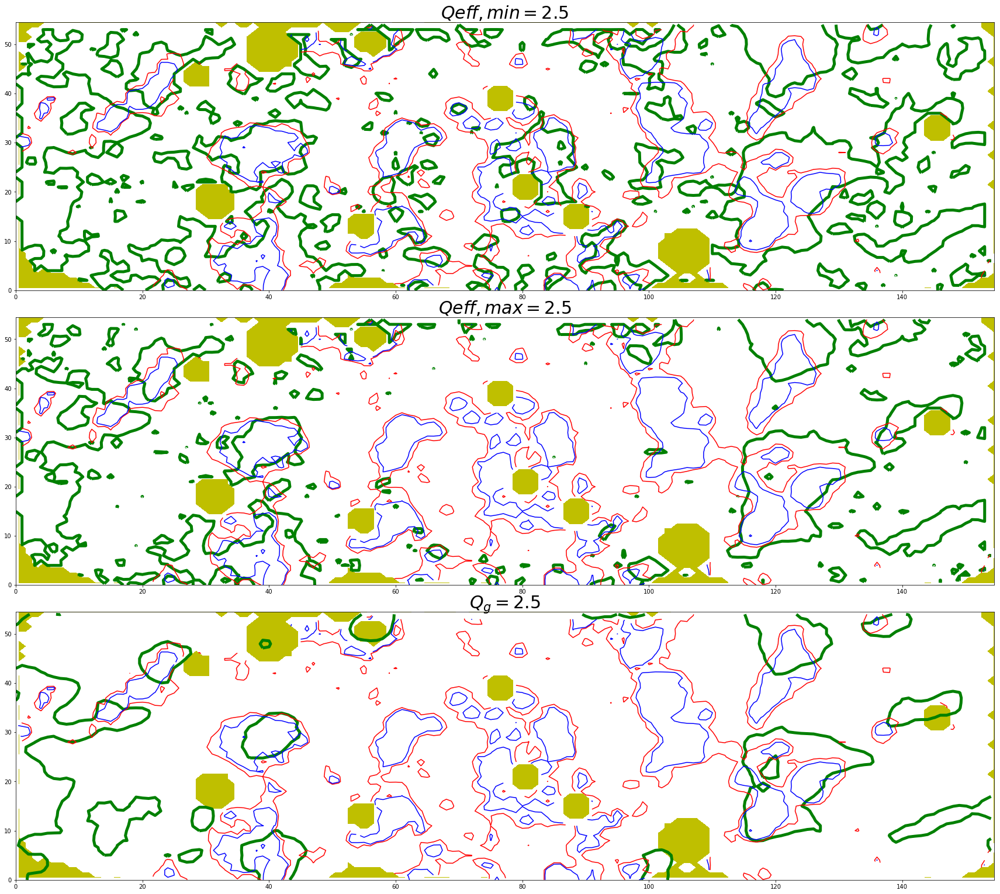

In [218]:
fig = plt.figure(figsize=[30, 27])

q_level = 2.5

plt.subplot(3,1,1)
CS = plt.contour(X, Y, Qeff_min, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,min={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,2)
CS = plt.contour(X, Y, Qeff_max, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,max={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,3)
CS = plt.contour(X, Y, Qgs, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Q_g={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

fig.subplots_adjust(wspace=0.0, hspace=0.1)
plt.show()

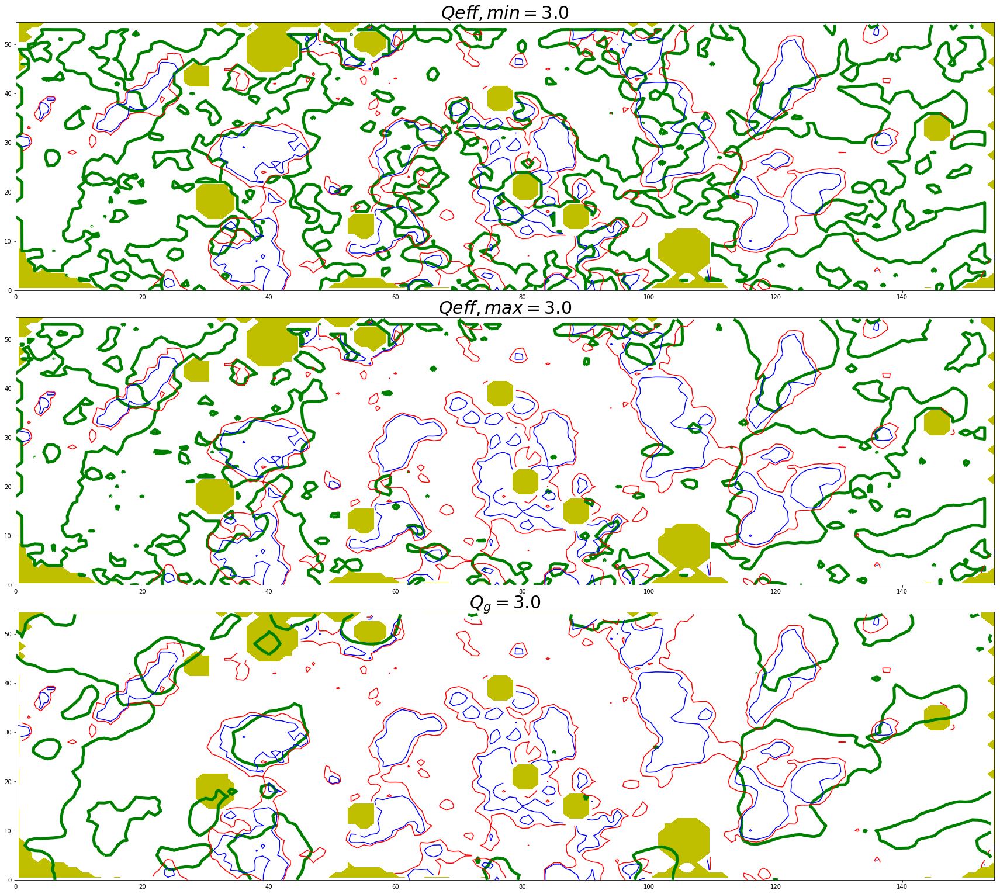

In [219]:
fig = plt.figure(figsize=[30, 27])

q_level = 3.

plt.subplot(3,1,1)
CS = plt.contour(X, Y, Qeff_min, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,min={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,2)
CS = plt.contour(X, Y, Qeff_max, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Qeff,max={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,3)
CS = plt.contour(X, Y, Qgs, levels=[q_level], colors=('g'), linewidths=[5.])
plt.title(r'$Q_g={}$'.format(q_level), fontsize=30)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))
mark_stars(colors=('y'), levels=[0.999, 1.001])

fig.subplots_adjust(wspace=0.0, hspace=0.1)
plt.show()

$\bar{k}$ в масштабах кпк 
${\displaystyle \bar{k}\equiv\frac{k\,\sigma_{\mathrm{s}}}{\kappa}}$:

In [25]:
%%time
G = 4.32
lambda_kpc = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        s_R_min = sig_R_min[i][j]
        lambda_kpc[i][j] = 2*math.pi*s_R_min/(bark[i][j]*kappa)

0
Wall time: 766 ms


In [26]:
np.save('lambda_kpc.npy', lambda_kpc)

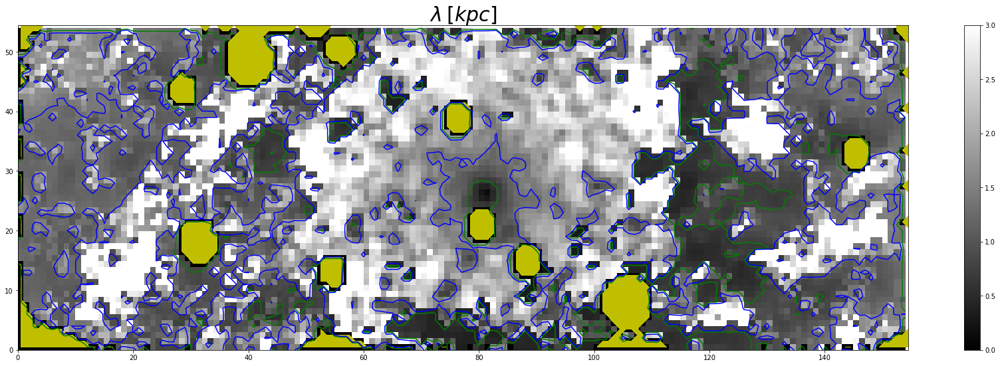

In [27]:
plt.figure(figsize=[30, 9])
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, lambda_kpc, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()
CS = plt.contour(X, Y, lambda_kpc, levels=[0.75, 1.4], colors=('g', 'b'))
plt.title(r'$\lambda\:[kpc]$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)

## как повлияет на результат использование изменяющегося $X_{\rm CO}$

Используя модель из Leroy (2008) предполагалось $X_{\rm CO} = 2.0\times10^{20} \mathrm{cm^{-2}K^{-1}km^{-1}s}$.

В работе http://iopscience.iop.org/article/10.1088/0004-637X/764/2/117/pdf был найден градиент этой величины для двух случаев степенного закона $N=1$ и $N=1.5$: 

 $$log(X_{CO}) = 20.09(0.05)\, +\, 0.06(0.02)R\:[kpc]\: N=1$$
 $$log(X_{CO}) = 20.00(0.06)\, +\, 0.08(0.02)R\:[kpc]\: N=1.5$$

Была еще также работа Aniano (2012), где нет никакого градиента. Они объясняют плохость этой работы тем, что 

> Inspecting their Figure 4, it is evident that the results of their measurements of XCO in NGC 628 are subject to strong systematic uncertainties, and show large changes (from an increasing to a flat, or even decreasing, radial trend) depending on which subset of the Spitzer+Herschel data is used and the spatial resolution at which the modeling is conducted. Given the large systematic uncertainties in their measurement of XCO for NGC 628, we refrain from conducting a detailed comparison to their results.

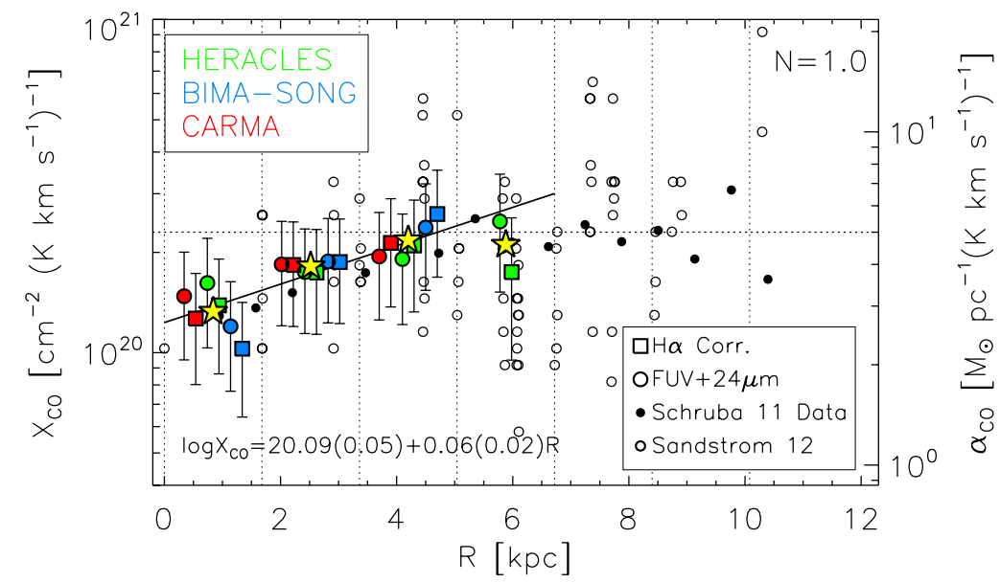

In [57]:
Image('alpha_CO_variations_VENGA.png', width=600)

Посмотрим на разброс:

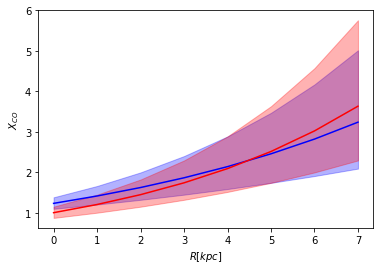

In [77]:
# log(X_CO) = 20.09(0.05) + 0.06(0.02)R[kpc] N=1
# log(X_CO) = 20.00(0.06) + 0.08(0.02)R[kpc] N=1.5

X_CO_10 = []
X_CO_15 = []
for r in range(8):
    X_CO_10.append((np.power(10., 0.09 + 0.06*r), np.power(10., 0.04 + 0.04*r), np.power(10., 0.14 + 0.08*r)))
    X_CO_15.append((np.power(10., 0.0 + 0.08*r), np.power(10., -0.06 + 0.06*r), np.power(10., 0.06 + 0.1*r)))
    
plt.plot(range(8), zip(*X_CO_10)[0], '-', color='b')
plt.fill_between(range(8), zip(*X_CO_10)[1], zip(*X_CO_10)[2], color='b', alpha=0.3)
plt.plot(range(8), zip(*X_CO_15)[0], '-', color='r')
plt.fill_between(range(8), zip(*X_CO_15)[1], zip(*X_CO_15)[2], color='r', alpha=0.3)
plt.ylabel(r'$X_{CO}$')
plt.xlabel(r'$R[kpc]$')

Видно, что хотя ошибки довольно заметны, средние похожи друг на друга. Используем для $N=1$ (поскольку они именно ее обсуждают в выводах). Надо также не забыть, что у них использованы расстояния 8.6 Мпк.

In [14]:
%%time

G = 4.32
Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)
bark = np.zeros(dist_.shape)
bark_max = np.zeros(dist_.shape)
Qgs = np.zeros(dist_.shape)
Qss_min = np.zeros(dist_.shape)
Qss_max = np.zeros(dist_.shape)
Sigma_HERACLES_CO_grad = np.zeros(dist_.shape)

step = 0
for i, row in enumerate(dist_):
    for j, col in enumerate(dist_[0]):
        if step%1000 == 0:
            print step
        step+=1
        c = c_g_[i][j]
        r = dist_[i][j]
        rkpc = r*calc_scale(8.6)
        X_CO_10 = np.power(10., 0.09 + 0.06*rkpc)
        Sigma_HERACLES_CO_grad[i][j] = X_CO_10*Sigma_HERACLES_CO_[i][j]/2.0
        Sigma = 1.36*(Sigma_HI_[i][j] + X_CO_10*Sigma_HERACLES_CO_[i][j]/2.0)
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)
        Qs_min = kappa * s_R_min / (3.36 * G * Sigma_s_)
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_min[i][j] = 1./qeff
        bark[i][j] = root_for_max
        
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_max[i][j] = 1./qeff
        bark_max[i][j] = root_for_max
        
        Qgs[i][j] = Qg
        Qss_min[i][j] = Qs_min
        Qss_max[i][j] = Qs_max

0
1000
2000
3000
4000
5000
6000
7000
8000
Wall time: 15.9 s


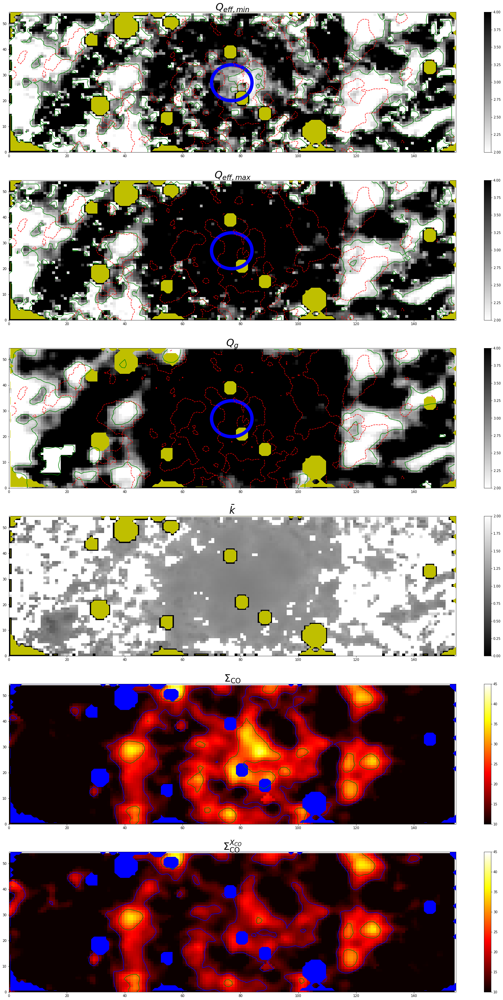

In [15]:
plt.figure(figsize=[30, 54])

plt.subplot(6,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,min}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,2)
quadmesh = plt.pcolormesh(X, Y, Qeff_max, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,max}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,4)
quadmesh = plt.pcolormesh(X, Y, bark, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=2.)
plt.colorbar()
plt.title(r'$\bar{k}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(6,1,3)
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'$Q_{g}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,5)
quadmesh = plt.pcolormesh(X, Y, Sigma_HERACLES_CO_, cmap=cm.hot)
quadmesh.set_clim(vmin=10., vmax=45.)
plt.colorbar()
CS = plt.contour(X, Y, Sigma_HERACLES_CO_, levels=[15., 25.], colors=('b', 'g'))
plt.title(r'$\Sigma_{\rm CO}}$', fontsize=30)
mark_stars(colors=('b'), levels=[0.999, 1.001])


plt.subplot(6,1,6)
quadmesh = plt.pcolormesh(X, Y, Sigma_HERACLES_CO_grad, cmap=cm.hot)
quadmesh.set_clim(vmin=10., vmax=45.)
plt.colorbar()
CS = plt.contour(X, Y, Sigma_HERACLES_CO_grad, levels=[15., 25.], colors=('b', 'g'))
plt.title(r'$\Sigma_{\rm CO}^{X_{CO}}$', fontsize=30)
mark_stars(colors=('b'), levels=[0.999, 1.001])

# plt.savefig('result_maps_column3.png', format='png', bbox_inches='tight')
plt.show()

В целом ничего особо не поменялось, поскольку отличия не такие большие, как видно из двух последних карт. Периферия и центр изменились на картах $Q$, но там мы ничего особо и не могли померять.

## сравнение с уровнями $\Sigma_{H2}$

In [57]:
SFR = np.nan_to_num(log_Halpha_SFR_.ravel())
SFR[SFR > -0.5] = -1000.
SFR = np.power(10., SFR)
print SFR.sum(), len(SFR), mean(SFR), max(SFR)

17836.5397464 796689 0.0223883344021 0.103032865539


In [59]:
(175.92+157.3)*(53.82+ 55.42)*scale*scale #площадь

45.5941507286985

С этим что-то не сходится у меня

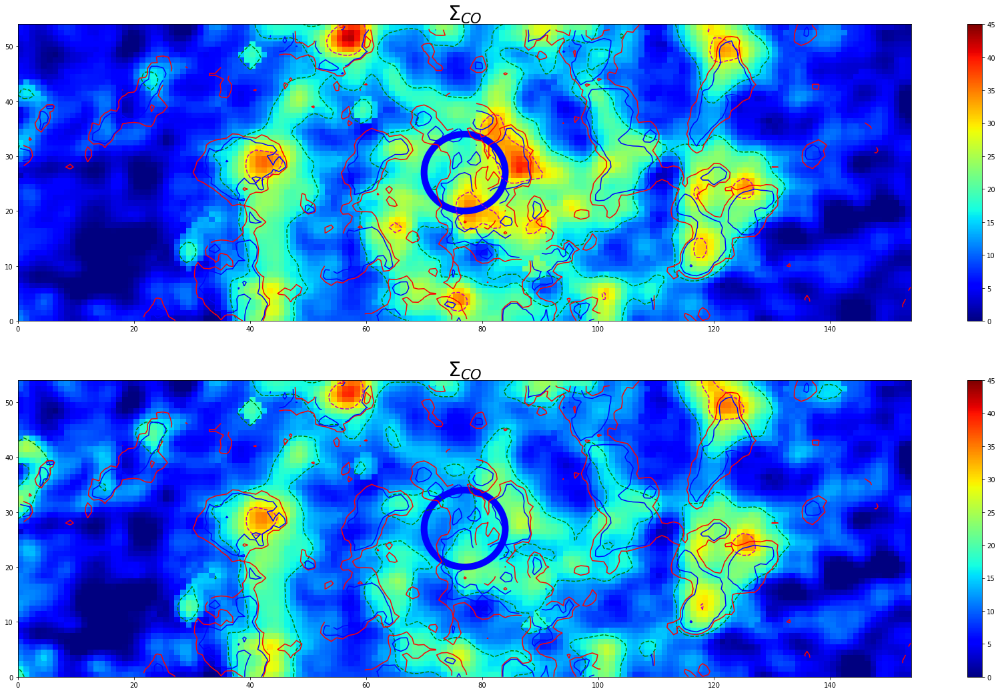

In [20]:
plt.figure(figsize=[30, 18])
plt.subplot(2,1,1)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, Sigma_HERACLES_CO_, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=45.)
plt.colorbar()
CS = plt.contour(X, Y, Sigma_HERACLES_CO_, levels=[15., 30.], colors=('g', 'm'), linestyles='dashed')
plt.title(r'$\Sigma_{CO}$', fontsize=30)
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'b'))

plt.subplot(2,1,2)
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, Sigma_HERACLES_CO_grad, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=45.)
plt.colorbar()
CS = plt.contour(X, Y, Sigma_HERACLES_CO_grad, levels=[15., 30.], colors=('g', 'm'), linestyles='dashed')
plt.title(r'$\Sigma_{CO}$', fontsize=30)
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'b'))

В целом очень похоже, но как будто сдвинуто, что странно. 

## shear (Hunter 1998)

Hunter et al. (1998), 'competition with shear' unstable according to Leroy: $$\frac{\alpha_A\sigma_g A}{G\pi\Sigma_g} < 1,$$ где $A = 0.5(\frac{v}{r}-\frac{dv}{dr})$ постоянная Оорта. Hunter et al. (1998) предложили $\alpha_A \approx 2.5$.

In [21]:
def oort_a(r, gas_vel, scale):
    try:
        return 0.5 * (gas_vel(r)/r - gas_vel.deriv()(r))/(scale)
    except:
        return 0.5 * (gas_vel(r)/r - gas_vel.derivative()(r))/(scale)
    
def Sigma_crit_A(r, gas_vel, alpha, sound_vel, Sigma_g, scale):
    G = 4.32
    return (alpha * sound_vel * oort_a(r, gas_vel, scale)) / (np.pi * G * Sigma_g)

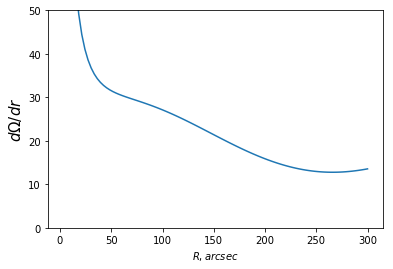

In [22]:
test_points = np.linspace(0, 300., 100)
plt.plot(test_points, [oort_a(x, gas_approx, scale) for x in test_points], '-', label='poly')
plt.ylim(0, 50)
plt.xlabel('$R, arcsec$')
plt.ylabel('$d\Omega/dr$', fontsize=15);

In [23]:
%%time

shear = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma_g = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        shear[i][j] = Sigma_crit_A(dist_[i][j], gas_approx, 2.5, c, Sigma_g, scale)

0
Wall time: 474 ms


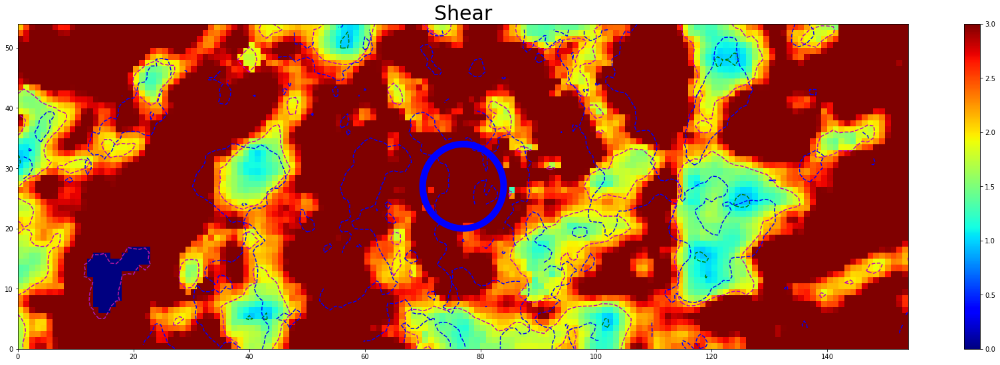

In [24]:
plt.figure(figsize=[30, 9])
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, shear, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=3.)
plt.colorbar()
CS = plt.contour(X, Y, shear, levels=[1., 2.], colors=('g', 'm'), linestyles='dashed')

plt.title('Shear', fontsize=30)

#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('b'))

Т.о. shear ничего не может объяснить или требуется другая величина $\alpha_A$

## SFR через $\lambda$

https://arxiv.org/pdf/1702.02609.pdf (и http://iopscience.iop.org/article/10.1086/431734/pdf), но там плохо тем, что формула не подходит ибо турбулентность (я посмотрел первоисточники [Krumholz 2005](http://iopscience.iop.org/article/10.1086/431734/pdf) - вроде можно использовать формулу) $$SFR=\epsilon_{eff}(\frac{\pi^3}{2})^{0.5}G\lambda^2\frac{\Sigma_g^2}{\sigma_g}(1+\frac{\Sigma_*}{\Sigma_g}\frac{\sigma_g}{\sigma_*})^{0.5}$$ и затем $\Sigma_{SFR} = SFR/Area$ и еще проследить, чтобы $\lambda$ была в правильных единицах.

In [118]:
bark = np.load('bark.npy')
lambda_kpc = np.load('lambda_kpc.npy')

In [90]:
0.008*sqrt(pi**3)/sqrt(2)

0.031499219891444837

In [93]:
3.24/3.17

1.0220820189274449

In [10]:
((175.92+157.3)/1553)*scale, ((53.82+55.42)/513)*scale

(0.007593776203341999, 0.007536375271917793)

In [114]:
#  X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
((175.92+157.3)/1553)*((53.82+55.42)/513)*(scale**2)

5.722954719934443e-05

Проверим точку из Dib грубо:

In [15]:
G = 4.32
e_ff = 0.008
multipl = e_ff*sqrt(pi**3)/sqrt(2)*1.0221*G/1000.
area = 0.5

(multipl*(0.8**2)*(42.**2)*np.sqrt(2)/10.)/area, np.power(10., -1.3)

(0.044412015384004556, 0.05011872336272722)

Да, очень похоже. Значит и у нас должно быть верно.

In [28]:
%%time

G = 4.32
Sigma_lambda = np.zeros(dist_.shape)
e_ff = 0.008

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        lambd = lambda_kpc[i][j]
        multipl = e_ff*sqrt(pi**3)/sqrt(2)*1.0221*G/1000.
#         area = 5.723/100000.
        area = 5.723
        Sigma_lambda[i][j] = (multipl*(lambd**2)*(Sigma**2)*np.sqrt(1 + (Sigma_s_/s_R_min)*(c/Sigma))/c)/area

0
Wall time: 761 ms


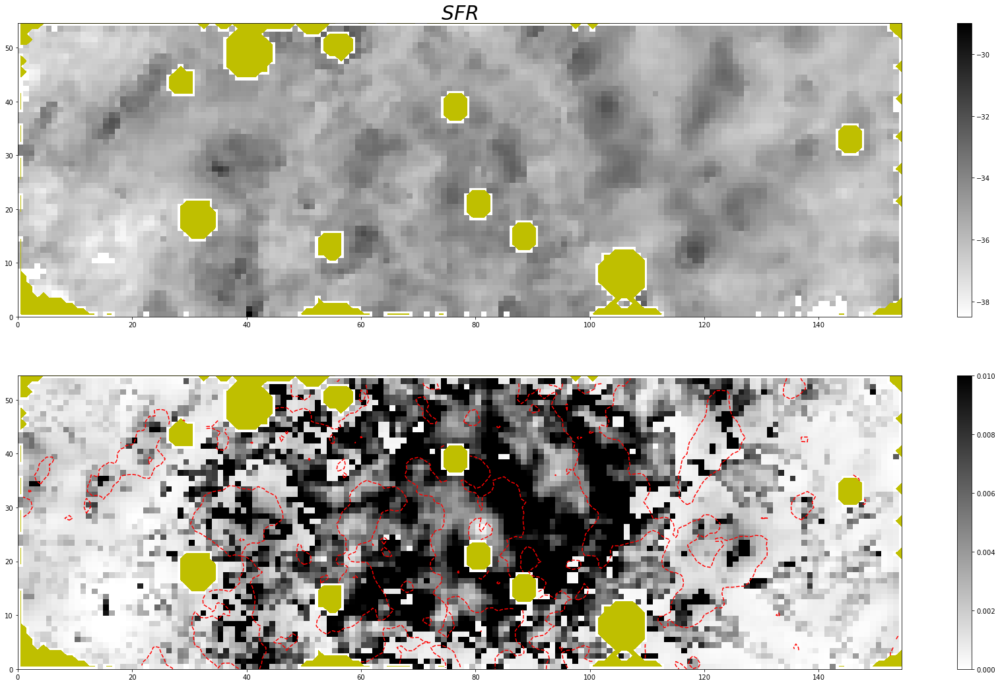

In [49]:
plt.figure(figsize=[30, 18])

plt.subplot(2,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, log_Halpha_SFR_, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=-38.5, vmax=-29)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$SFR$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])


plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, Sigma_lambda, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=0.0, vmax=0.01)
# quadmesh.set_clim(vmin=10.0, vmax=2000.)
plt.colorbar()
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5], colors=('red'))

plt.show()

In [126]:
%%time

G = 4.32
tmp_lambda = np.zeros(dist_.shape)
e_ff = 0.008

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        lambd = lambda_kpc[i][j]
        multipl = e_ff*sqrt(pi**3)/sqrt(2)*1.0221*G/1000.
#         area = 5.723/100000.
        area = 5.723
        tmp_lambda[i][j] = np.sqrt(1 + (Sigma_s_/s_R_min)*(c/Sigma))

0
100
200
300
400
500
Wall time: 1min 1s


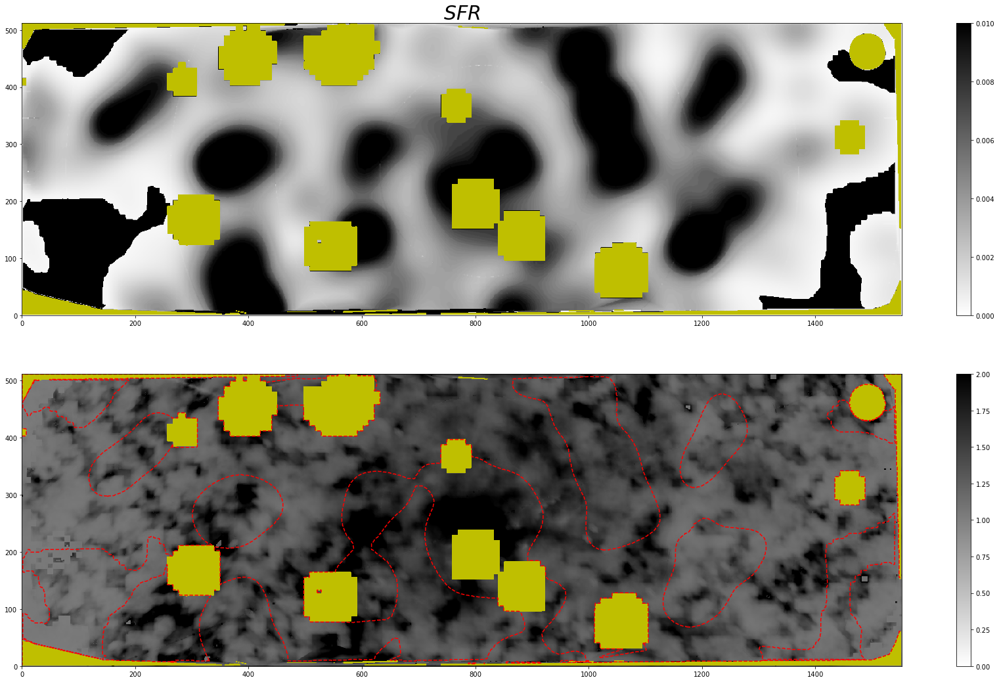

In [128]:
plt.figure(figsize=[30, 18])

plt.subplot(2,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, np.power(10., log_Halpha_SFR_), cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0.0, vmax=0.01)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$SFR$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors='y')


plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, tmp_lambda, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=0.0, vmax=2.)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
# plt.title(r'$Q_{eff,max}$', fontsize=30)
add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors='y')

plt.show()

In [135]:
%%time

G = 4.32
tmp_lambda = np.zeros(dist_.shape)
e_ff = 0.008

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        lambd = lambda_kpc[i][j]
        multipl = e_ff*sqrt(pi**3)/sqrt(2)*1.0221*G/1000.
#         area = 5.723/100000.
        area = 5.723
        tmp_lambda[i][j] = (Sigma**2)/c

0
100
200
300
400
500
Wall time: 57 s


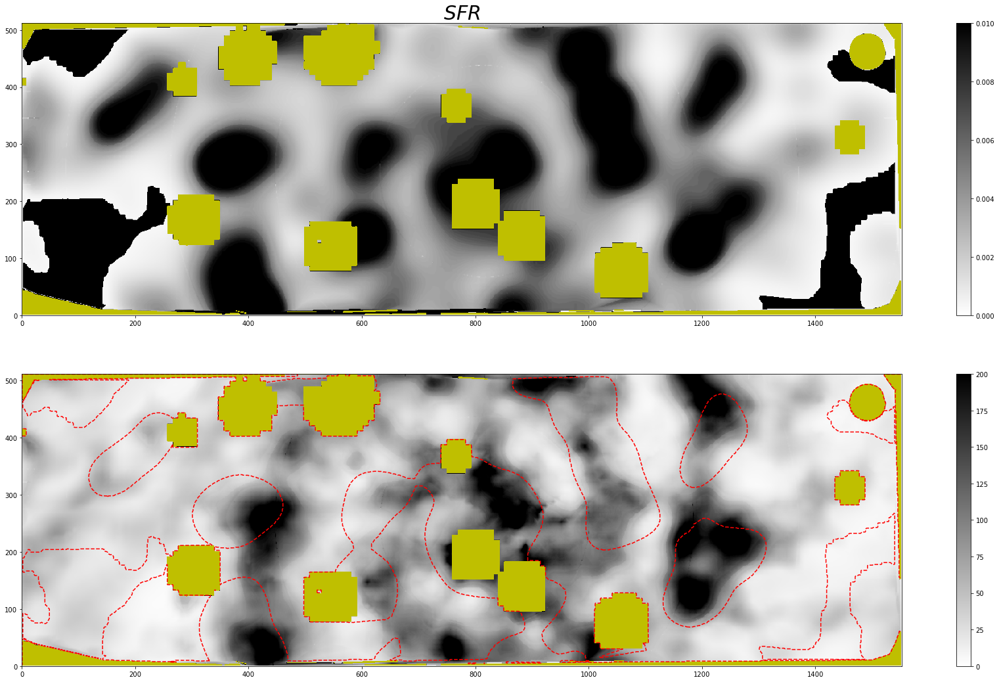

In [140]:
plt.figure(figsize=[30, 18])

plt.subplot(2,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, np.power(10., log_Halpha_SFR_), cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0.0, vmax=0.01)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$SFR$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors='y')


plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, tmp_lambda, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=0.0, vmax=200.)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
# plt.title(r'$Q_{eff,max}$', fontsize=30)
add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors='y')

plt.show()

In [10]:
%%time

G = 4.32
Sigma_lambda = np.zeros(dist_.shape)
e_ff = 0.008

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        lambd = 1./bark[i][j]
        Sigma_lambda[i][j] = (lambd**2)*(Sigma**2)*np.sqrt(1 + (Sigma_s_/s_R_max)*(c/Sigma))/c        

0
100
200
300
400
500
Wall time: 56.5 s


In [11]:
np.save('Sigma_lambda.npy', Sigma_lambda)

In [78]:
Sigma_lambda = np.load('Sigma_lambda.npy')

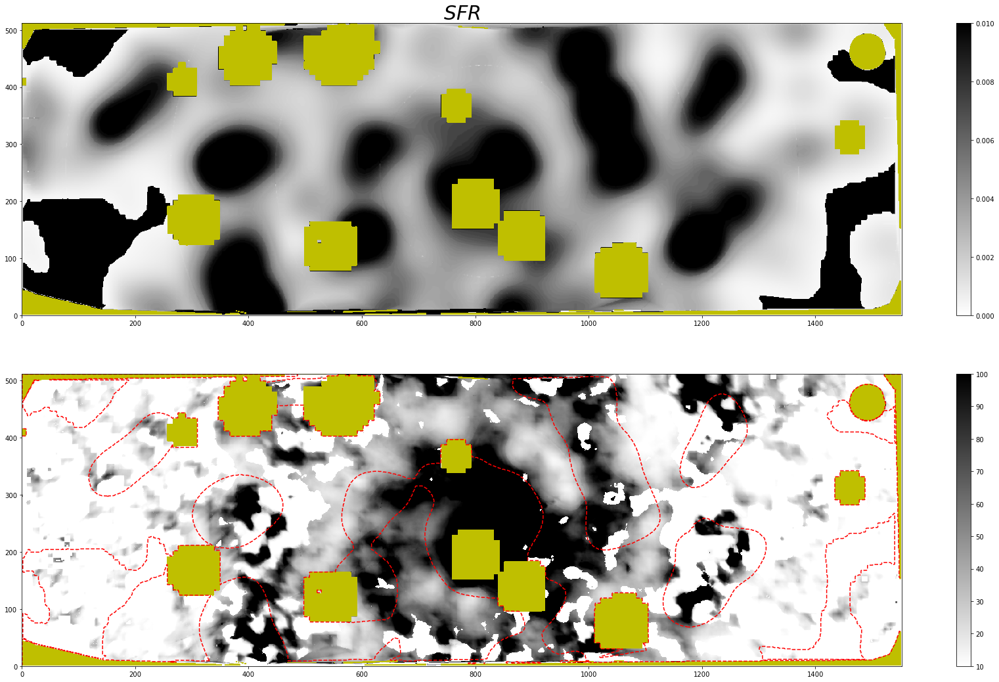

In [18]:
plt.figure(figsize=[30, 18])

plt.subplot(2,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, np.power(10., log_Halpha_SFR_), cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=0.0, vmax=0.01)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$SFR$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors='y')


plt.subplot(2,1,2)
quadmesh = plt.pcolormesh(X, Y, Sigma_lambda, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=10.0, vmax=100.)
plt.colorbar()
# CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
# plt.title(r'$Q_{eff,max}$', fontsize=30)
add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors='y')

plt.show()

Хм, странно, все очень похоже. Но тут неправильно $\lambda$ посчитано.

In [124]:
mask = Sigma_HERACLES_CO_ < 45.

In [ ]:
plt.figure(figsize=[16, 11])
plt.scatter(np.power(10., log_Halpha_SFR_[mask]).ravel(), Sigma_lambda[mask].ravel(), s=1., c=np.nan_to_num(dist_[mask].ravel()), cmap='plasma')
# plt.xlim(0., 0.03)
plt.colorbar()
plt.show()

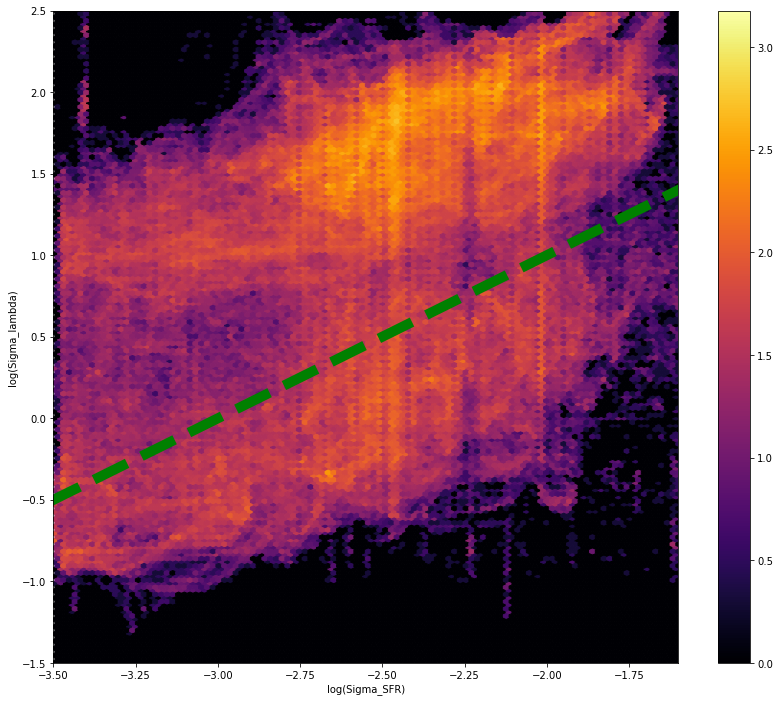

In [87]:
# libraries
import matplotlib.pyplot as plt
import numpy as np
 
# create data
x = np.nan_to_num(log_Halpha_SFR_[mask].ravel())
y = np.nan_to_num(np.log10(Sigma_lambda[mask].ravel()))
 
# Make the plot
plt.figure(figsize=[14, 12])
plt.hexbin(x, y, gridsize=200, bins='log', cmap='inferno')
plt.ylim(-1.5, 2.5)
plt.xlim(-3.5, -1.6)
plt.colorbar()
law = 1.
law_bias = 3.
plt.plot([-4., -1.], [-4.*law+law_bias, -1.*law+law_bias], '--', lw=10, color='g')
plt.xlabel('log(Sigma_SFR)')
plt.ylabel('log(Sigma_lambda)')
plt.show()

**Kennicutt–Schmidt law**

Со звездами формирует странные непонятные кластеры. Интересно. Возможно это же причина "нитей" на картинке после этой.

In [18]:
Sigma_g = 1.36*(Sigma_HI_ + Sigma_HERACLES_CO_)

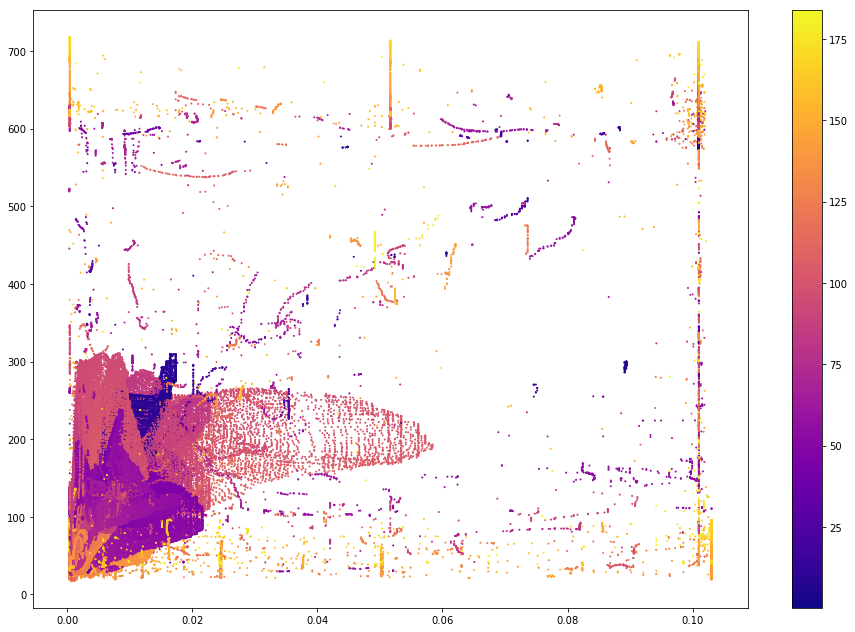

In [20]:
plt.figure(figsize=[16, 11])
plt.scatter(np.power(10., log_Halpha_SFR_).ravel(), np.power(Sigma_g, 1.4).ravel(), s=1., c=np.nan_to_num(dist_.ravel()), cmap='plasma')
# plt.xlim(0., 0.03)
plt.colorbar()
plt.show()

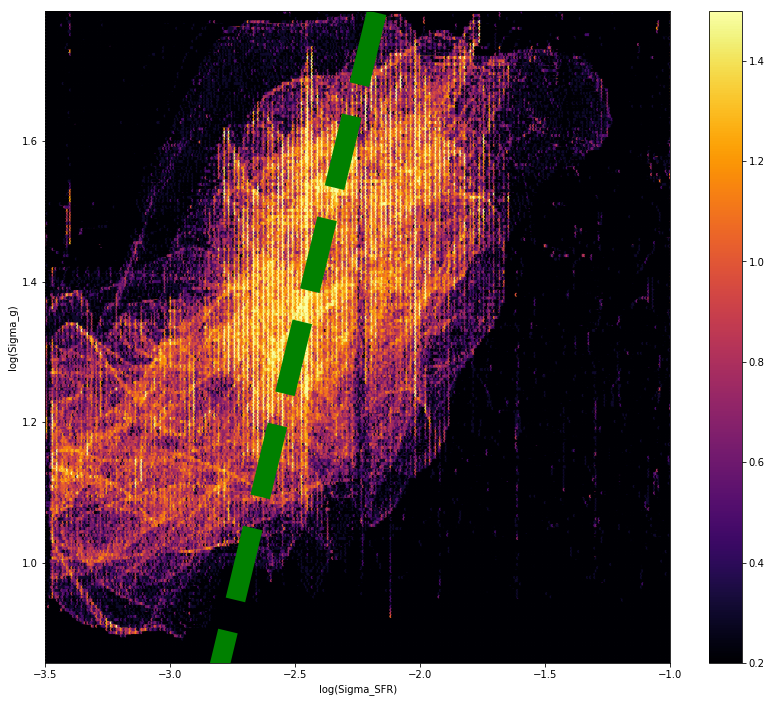

In [78]:
# create data
x = np.nan_to_num(log_Halpha_SFR_[mask].ravel())
y = np.nan_to_num(np.log10(Sigma_g[mask].ravel()))
 
# Make the plot
plt.figure(figsize=[14, 12])
plt.hexbin(x, y, gridsize=600, bins='log', cmap='inferno', vmin=0.2, vmax=1.5)
plt.ylim(1.2/1.4, 2.5/1.4)
plt.xlim(-3.5, -1.0)
plt.colorbar()
kslaw = 1.48
kslaw_bias = 5.
plt.plot([-4., -2.], [-4.*kslaw+kslaw_bias, -2.*kslaw+kslaw_bias], '--', lw=20, color='g')
plt.xlabel('log(Sigma_SFR)')
plt.ylabel('log(Sigma_g)')
plt.show()

Интересно. Эти непонятные нити и явно наклон не такой.

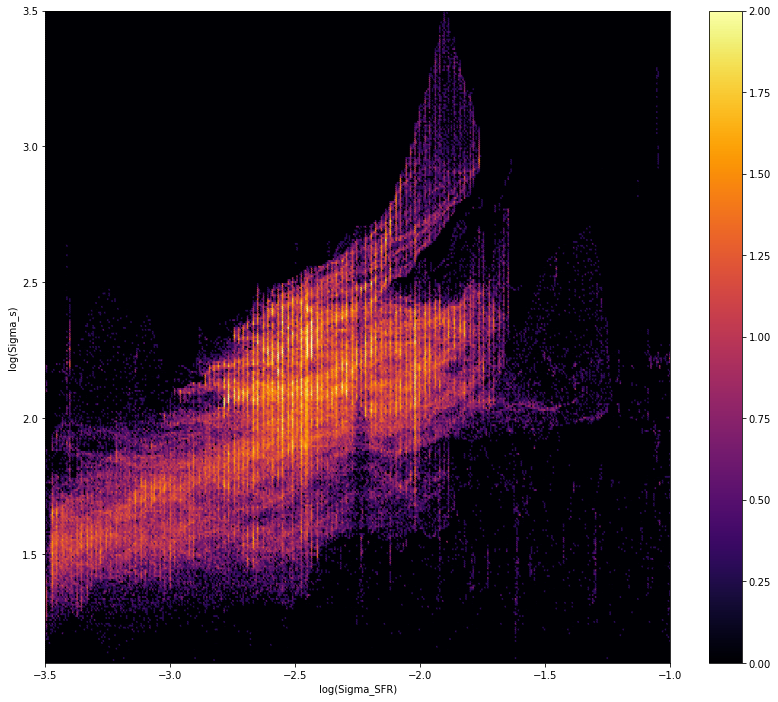

In [27]:
mask = Sigma_HERACLES_CO_ < 45.

# create data
x = np.nan_to_num(log_Halpha_SFR_[mask].ravel())
y = np.nan_to_num(np.log10(Sigma_s_Leroy_[mask].ravel()))
 
# Make the plot
plt.figure(figsize=[14, 12])
plt.hexbin(x, y, gridsize=600, bins='log', cmap='inferno', vmax=2.)
plt.ylim(1.1, 3.5)
plt.xlim(-3.5, -1.0)
plt.colorbar()
# kslaw = 1.48
# kslaw_bias = 5.
# plt.plot([-4., -2.], [-4.*kslaw+kslaw_bias, -2.*kslaw+kslaw_bias], '--', lw=20, color='g')
plt.xlabel('log(Sigma_SFR)')
plt.ylabel('log(Sigma_s)')
plt.show()

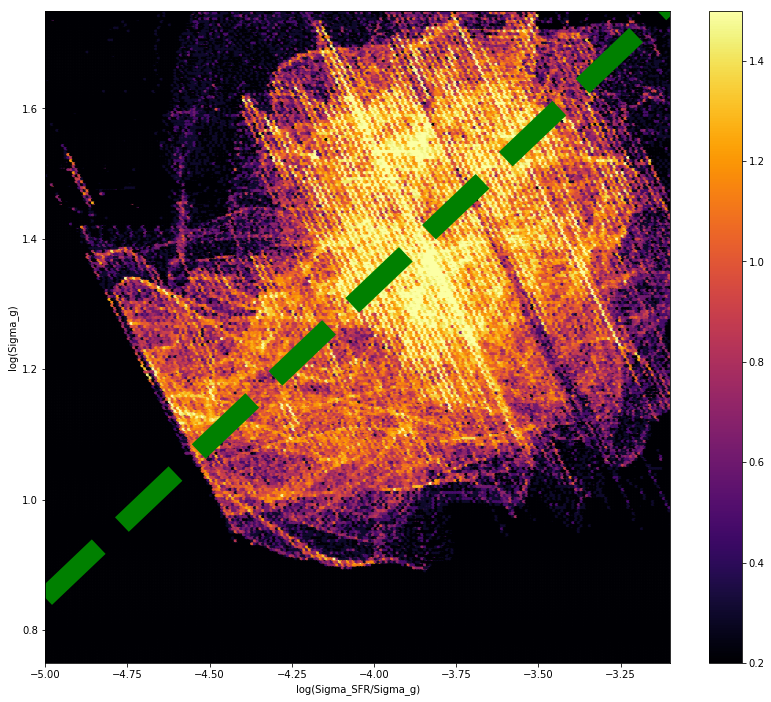

In [37]:
mask = Sigma_HERACLES_CO_ < 45.

# create data
x = np.nan_to_num(log_Halpha_SFR_[mask].ravel())
y = np.nan_to_num(np.log10(Sigma_g[mask].ravel()))
 
# Make the plot
plt.figure(figsize=[14, 12])
plt.hexbin(x-y, y, gridsize=600, bins='log', cmap='inferno', vmin=0.2, vmax=1.5)
plt.ylim(0.75, 1.75)
plt.xlim(-5, -3.1)
plt.colorbar()
kslaw = 0.48
kslaw_bias = 3.25
plt.plot([-5., -2.], [-5.*kslaw+kslaw_bias, -2.*kslaw+kslaw_bias], '--', lw=20, color='g')
plt.xlabel('log(Sigma_SFR/Sigma_g)')
plt.ylabel('log(Sigma_g)')
plt.show()

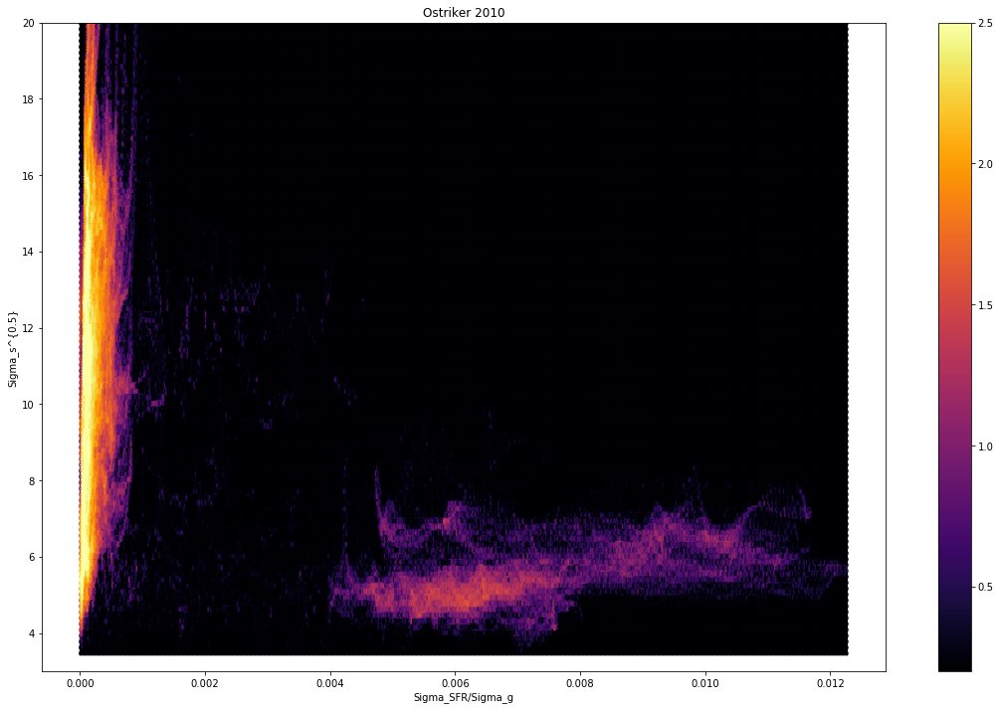

In [44]:
mask = Sigma_HERACLES_CO_ < 45.

# create data
x = np.nan_to_num(np.power(10., log_Halpha_SFR_[mask]).ravel())
y = np.nan_to_num(Sigma_g[mask].ravel())
z = np.divide(x, y)
z_ = np.power(Sigma_s_Leroy_[mask].ravel(), 0.5)
 
# Make the plot
plt.figure(figsize=[19, 12])
plt.hexbin(z, z_, gridsize=600, bins='log', cmap='inferno', vmin=0.2, vmax=2.5)
plt.ylim(3., 20.)
# plt.xlim(-5, -3.1)
plt.colorbar()
# kslaw = 0.48
# kslaw_bias = 3.25
# plt.plot([-5., -2.], [-5.*kslaw+kslaw_bias, -2.*kslaw+kslaw_bias], '--', lw=20, color='g')
plt.xlabel('Sigma_SFR/Sigma_g')
plt.ylabel('Sigma_s^{0.5}')
plt.title('Ostriker 2010')
plt.show()

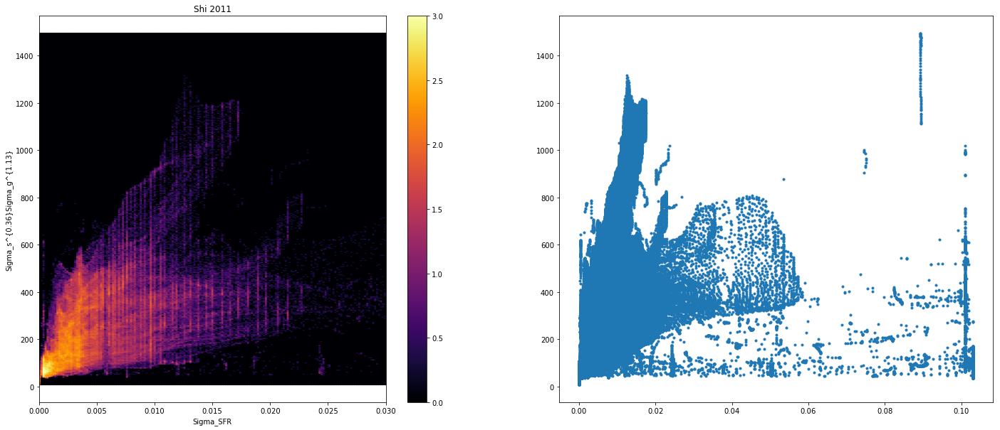

In [14]:
mask = Sigma_HERACLES_CO_ < 45.

# create data
x = np.nan_to_num(np.power(10., log_Halpha_SFR_[mask]).ravel())

z = np.nan_to_num(np.power(Sigma_s_Leroy_[mask].ravel(), 0.36))
z_ = np.nan_to_num(np.power(Sigma_g[mask].ravel(), 1.13))
y = np.multiply(z, z_)
 
# Make the plot
plt.figure(figsize=[24, 10])
plt.subplot(1, 2, 1)
plt.hexbin(x, y, gridsize=600, bins='log', cmap='inferno', vmin=0., vmax=3.)
# plt.ylim(0., 0.1)
plt.xlim(0., 0.03)
plt.colorbar()
# kslaw = 0.48
# kslaw_bias = 3.25
# plt.plot([-5., -2.], [-5.*kslaw+kslaw_bias, -2.*kslaw+kslaw_bias], '--', lw=20, color='g')
plt.xlabel('Sigma_SFR')
plt.ylabel('Sigma_s^{0.36}Sigma_g^{1.13}')
plt.title('Shi 2011')
plt.subplot(1, 2, 2)
plt.plot(x, y, '.')
plt.show()

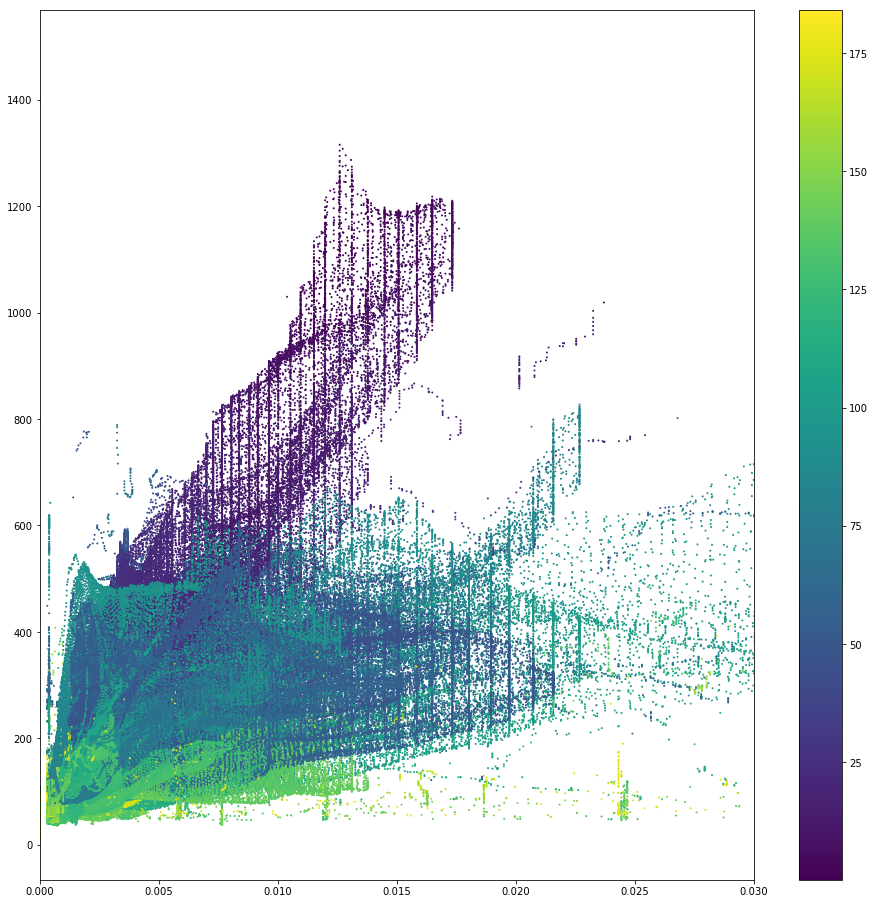

In [21]:
plt.figure(figsize=[16, 16])
plt.scatter(x, y, s=1., c=np.nan_to_num(dist_[mask].ravel()))
plt.xlim(0., 0.03)
plt.colorbar()
plt.show()

## $\sigma_R$ через толщину (e.g. Leroy 2008)

$\sigma_R = \sigma_Z/0.6 = \frac{1}{0.6}\sqrt{\frac{2\pi G l_s\Sigma_s}{7.3}}$, где $l_s=2.3\:kpc$ у Leroy. 

In [50]:
sigmaR_leroy = lambda l: sqrt(2*pi*4.32*2.3*l/7.3)/0.6

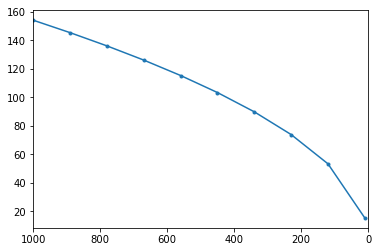

In [51]:
plt.plot(np.linspace(10, 1000., 10),[sigmaR_leroy(_) for _ in np.linspace(10, 1000., 10)], '.-')
plt.xlim(1000., 0.);

In [52]:
%%time

G = 4.32
Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)
bark = np.zeros(dist_.shape)
bark_max = np.zeros(dist_.shape)
Qgs = np.zeros(dist_.shape)
Qss_min = np.zeros(dist_.shape)
Qss_max = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sigmaR_leroy(Sigma_s_)
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)       
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_max, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_max[i][j] = 1./qeff
        bark_max[i][j] = root_for_max
        
        Qgs[i][j] = Qg
        Qss_max[i][j] = Qs_max

0
Wall time: 8.11 s


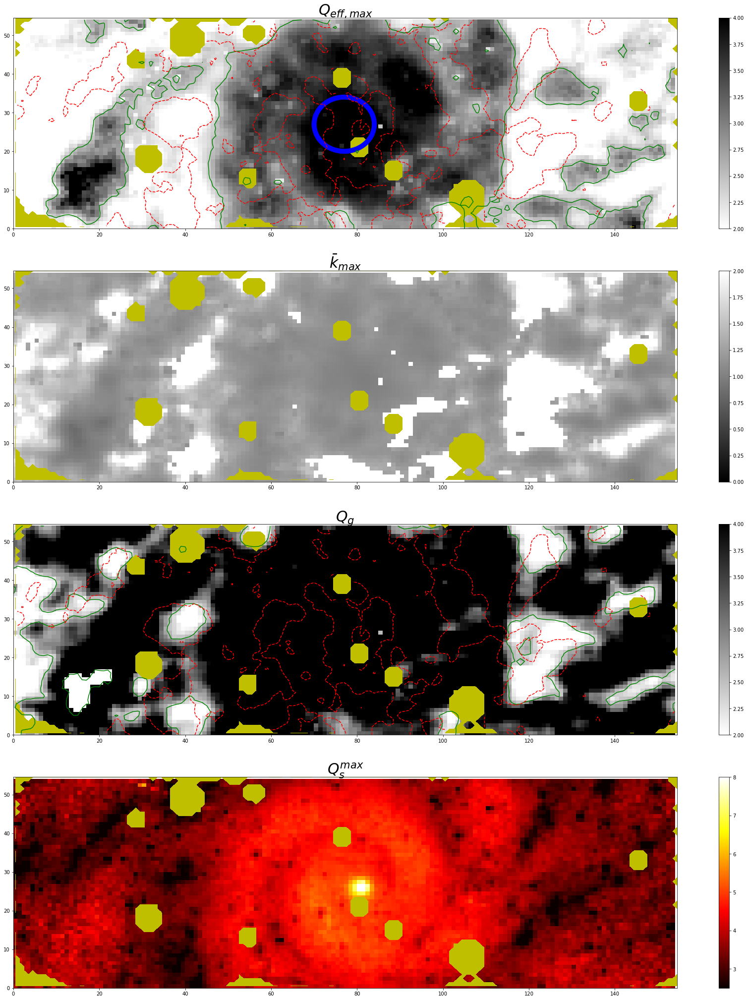

In [53]:
plt.figure(figsize=[30, 36])

plt.subplot(4,1,1)
quadmesh = plt.pcolormesh(X, Y, Qeff_max, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,max}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(4,1,2)
quadmesh = plt.pcolormesh(X, Y, bark_max, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=2.)
plt.colorbar()
plt.title(r'$\bar{k}_{max}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(4,1,3)
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'$Q_{g}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5], colors=('red'))

plt.subplot(4,1,4)
quadmesh = plt.pcolormesh(X, Y, Qss_max, cmap=cm.hot)
quadmesh.set_clim(vmin=2.5, vmax=8.)
plt.colorbar()
plt.title(r'$Q_{s}^{max}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

# plt.savefig('result_maps_column5.png', format='png', bbox_inches='tight')
plt.show()

## $\sigma_R$ через производную

$${\displaystyle \sigma_{\varphi}^{2}/\sigma_{R}^{2}=0.5\left(1+\frac{R}{\bar{v}_{\varphi}}\frac{d\bar{v}_{\varphi}}{dR}\right)}$$

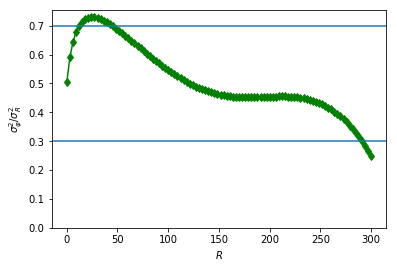

In [54]:
def sigPhi_to_sigR_real(R):
        return 0.5 * (1 + R*gas_approx.deriv()(R) / gas_approx(R))

test_points = np.linspace(0.1, 300., 100)
plt.plot(test_points, [sigPhi_to_sigR_real(R) for R in test_points], 'd-', color='green')
plt.axhline(y=0.3)
plt.axhline(y=0.7)
plt.xlabel('$R$')
plt.ylabel(r"$\sigma_{\varphi}^2/\sigma_{R}^2$")
plt.ylim(0)
plt.show()

In [55]:
def dotproduct(v1, v2):
    return sum((a*b) for a, b in zip(v1, v2))

def length(v):
    return math.sqrt(dotproduct(v, v))

def angle(v1, v2):
    return math.acos(dotproduct(v1, v2) / (length(v1) * length(v2)))

phi = np.zeros(sig_los.shape)

for i in range(len(sig_los[0])):
    for j in range(len(sig_los)):
        x, y  = 813.5-i, 253.5-j
        phi[j][i] = angle(np.array([x,y]), np.array([1553., 1553*np.sin(22.5*np.pi/180.)-60.]))*180./np.pi

$$\sigma^2_{los, \phi} = [\sigma_R^2\sin^2\phi + \sigma^2_{\varphi}\cos^2\phi]\sin^2 i + \sigma_z^2\cos^2 i,$$

In [56]:
sig_r_max = lambda sig, phi_, R: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + sigPhi_to_sigR_real(R)*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.09*cos_i**2) 
sig_r_min = lambda sig, phi_, R: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + sigPhi_to_sigR_real(R)*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.49*cos_i**2) 

In [57]:
%%time
sig_R_max = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_max[i][j] = sig_r_max(sig_los[i][j], phi[i][j], dist_[i][j])
        
sig_R_min = np.zeros(sig_los.shape)

for i in range(len(sig_los)):
    for j in range(len(sig_los[0])):
        sig_R_min[i][j] = sig_r_min(sig_los[i][j], phi[i][j], dist_[i][j])

Wall time: 1.1 s


In [58]:
%%time

G = 4.32
Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)
bark = np.zeros(dist_.shape)
bark_max = np.zeros(dist_.shape)
Qgs = np.zeros(dist_.shape)
Qss_min = np.zeros(dist_.shape)
Qss_max = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)
        Qs_min = kappa * s_R_min / (3.36 * G * Sigma_s_)
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_min[i][j] = 1./qeff
        bark[i][j] = root_for_max
        
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_max[i][j] = 1./qeff
        bark_max[i][j] = root_for_max
        
        Qgs[i][j] = Qg
        Qss_min[i][j] = Qs_min
        Qss_max[i][j] = Qs_max

0
Wall time: 15.1 s


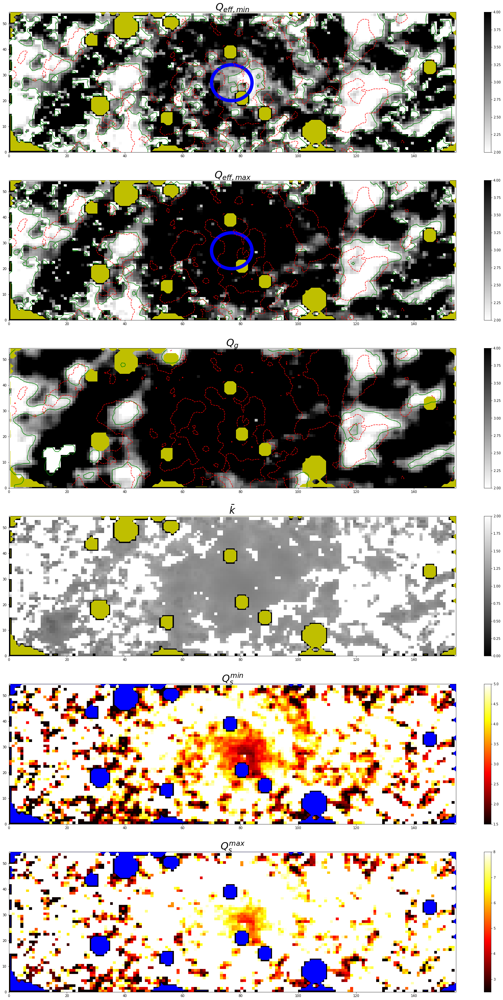

In [59]:
plt.figure(figsize=[30, 54])

plt.subplot(6,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,min}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,2)
quadmesh = plt.pcolormesh(X, Y, Qeff_max, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_max, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,max}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,4)
quadmesh = plt.pcolormesh(X, Y, bark, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=2.)
plt.colorbar()
plt.title(r'$\bar{k}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])


plt.subplot(6,1,3)
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'$Q_{g}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5], colors=('red'))


plt.subplot(6,1,5)
quadmesh = plt.pcolormesh(X, Y, Qss_min, cmap=cm.hot)
quadmesh.set_clim(vmin=1.5, vmax=5.)
plt.colorbar()
plt.title(r'$Q_{s}^{min}$', fontsize=30)
mark_stars(colors=('b'), levels=[0.999, 1.001])

plt.subplot(6,1,6)
quadmesh = plt.pcolormesh(X, Y, Qss_max, cmap=cm.hot)
quadmesh.set_clim(vmin=2.5, vmax=8.)
plt.colorbar()
plt.title(r'$Q_{s}^{max}$', fontsize=30)
mark_stars(colors=('b'), levels=[0.999, 1.001])


# plt.savefig('result_maps_column5.png', format='png', bbox_inches='tight')
plt.show()

In [37]:
sig_R_max_ = np.load('sig_R_max.npy')
sig_R_min_ = np.load('sig_R_min.npy')

Отличия минимальны, да и сами оценки $\sigma_R$ отличаются слабо:

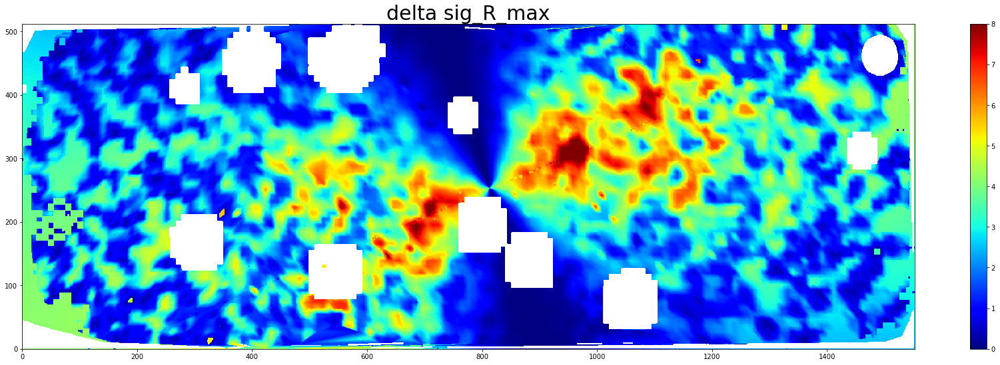

In [56]:
plt.figure(figsize=[30, 9])
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))
quadmesh = plt.pcolormesh(X, Y, sig_R_max_-sig_R_max, cmap=cm.jet)
quadmesh.set_clim(vmin=0., vmax=8.)
plt.colorbar()
# CS = plt.contour(X, Y, shear, levels=[1., 2.], colors=('g', 'm'), linestyles='dashed')

plt.title('delta sig_R_max', fontsize=30)

# add_SFR_contours(colors=('b', 'g'))
mark_stars()

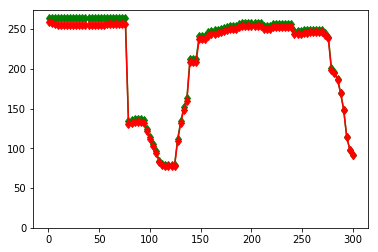

In [54]:
l1 = lambda sig, phi_, R: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + 0.25*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.09*cos_i**2) 
l2 = lambda sig, phi_, R: sig/np.sqrt(sin_i**2 * np.sin(phi_*np.pi/180.)**2 + sigPhi_to_sigR_real(R)*sin_i**2*np.cos(phi_*np.pi/180.)**2 + 0.09*cos_i**2) 

test_points = np.linspace(0.1, 300., 100)
plt.plot(test_points, [l1(_, 0., R) for _, R in zip(sig_los[250, :], test_points)], 'd-', color='green')
plt.plot(test_points, [l2(_, 0., R) for _, R in zip(sig_los[250, :], test_points)], 'd-', color='r')
# plt.axhline(y=0.3)
# plt.axhline(y=0.7)
# plt.xlabel('$R$')
# plt.ylabel(r"$\sigma_{\varphi}^2/\sigma_{R}^2$")
plt.ylim(0)
plt.show()

Да, разница минимальна.

## $\sigma_R$ в случае равновесного SVE

Как в случае Dib 2016.

In [60]:
%%time

G = 4.32
Qeff_max = np.zeros(dist_.shape)
Qeff_min = np.zeros(dist_.shape)
bark = np.zeros(dist_.shape)
bark_max = np.zeros(dist_.shape)
Qgs = np.zeros(dist_.shape)
Qss_min = np.zeros(dist_.shape)
Qss_max = np.zeros(dist_.shape)

for i, row in enumerate(dist_):
    if i%100 == 0:
        print i
    for j, col in enumerate(dist_[0]):
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_los[i][j]
        s_R_min = sig_los[i][j]
        Qg = kappa * c / (math.pi * G * Sigma)
        Qs_max = kappa * s_R_max / (3.36 * G * Sigma_s_)
        Qs_min = kappa * s_R_min / (3.36 * G * Sigma_s_)
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_min, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_min[i][j] = 1./qeff
        bark[i][j] = root_for_max
        
        try:
            root_for_max, qeff = findInvKinemQeffBrentq(Qs_max, Qg, c/s_R_min, np.arange(0.01, 50., 1.))
        except ValueError:
            qeff = 0.01
            root_for_max = -1.
        Qeff_max[i][j] = 1./qeff
        bark_max[i][j] = root_for_max
        
        Qgs[i][j] = Qg
        Qss_min[i][j] = Qs_min
        Qss_max[i][j] = Qs_max

0
Wall time: 15.4 s


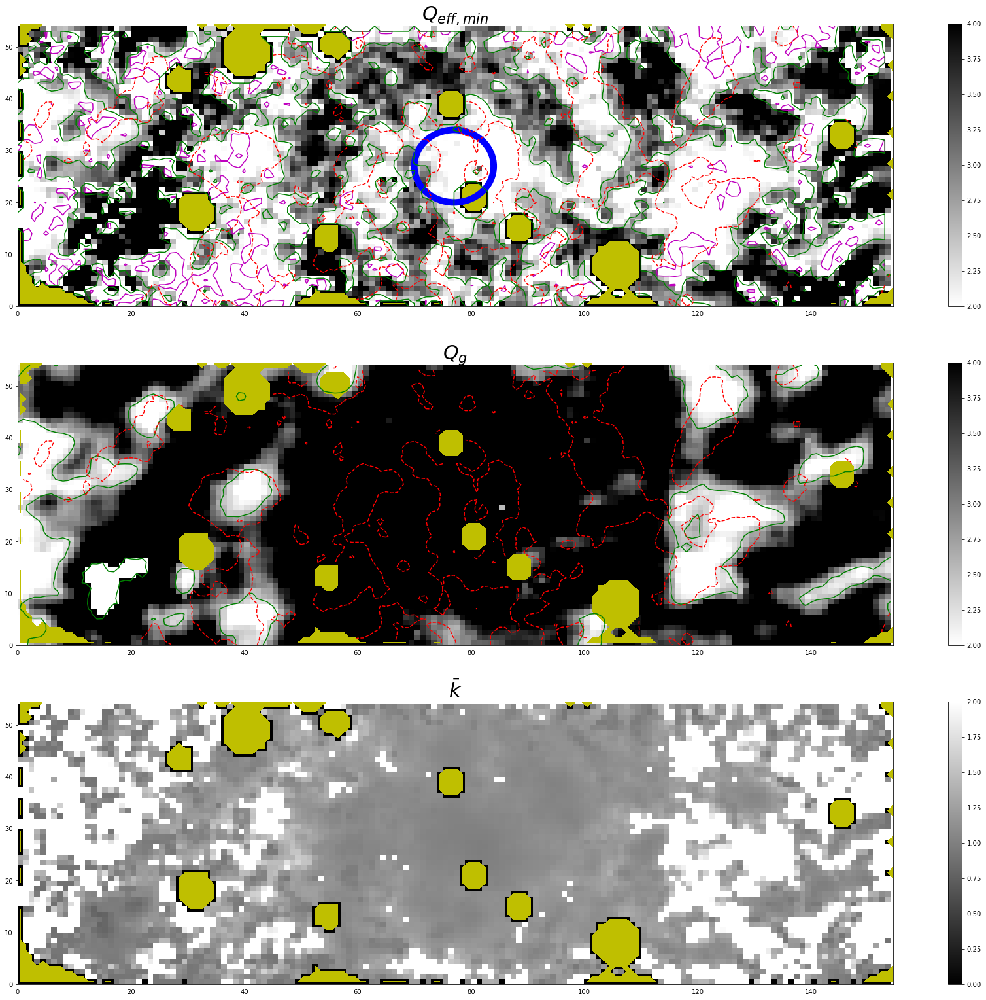

In [61]:
plt.figure(figsize=[30, 27])

plt.subplot(3,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_min, levels=[1., 2.5], colors=('m','g'))
plt.title(r'$Q_{eff,min}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
circle = plt.Circle((Nx/2, Ny/2), 7., color='b', fill=False, lw=10)
plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5], colors=('red'))

plt.subplot(3,1,3)
quadmesh = plt.pcolormesh(X, Y, bark, cmap=cm.gray)
quadmesh.set_clim(vmin=0., vmax=2.)
plt.colorbar()
plt.title(r'$\bar{k}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])

plt.subplot(3,1,2)
quadmesh = plt.pcolormesh(X, Y, Qgs, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'$Q_{g}$', fontsize=30)
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5], colors=('red'))

# plt.savefig('result_maps_column4.png', format='png', bbox_inches='tight')
plt.show()

Видно, что сильно перегрето выходит.

## статистика

Без звезд

In [90]:
Z = Sigma_HERACLES_CO_
mask = Z < 45. 

https://stats.stackexchange.com/questions/73646/how-do-i-test-that-two-continuous-variables-are-independent

In [46]:
np.count_nonzero(np.isnan(log_Halpha_SFR_.ravel())), log_Halpha_SFR_.ravel().shape

(4128, (796689L,))

In [47]:
np.count_nonzero(np.isnan(Qeff_min.ravel())), Qeff_min.ravel().shape

(0, (796689L,))

In [93]:
print np.corrcoef(Qeff_min[mask].ravel(), np.nan_to_num(log_Halpha_SFR_[mask].ravel()))[0][1]
print np.corrcoef(Qss_min[mask].ravel(), np.nan_to_num(log_Halpha_SFR_[mask].ravel()))[0][1]
print np.corrcoef(Qeff_max[mask].ravel(), np.nan_to_num(log_Halpha_SFR_[mask].ravel()))[0][1]
print np.corrcoef(Qss_max[mask].ravel(), np.nan_to_num(log_Halpha_SFR_[mask].ravel()))[0][1]
print np.corrcoef(np.nan_to_num(Qgs[mask].ravel()), np.nan_to_num(log_Halpha_SFR_[mask].ravel()))[0][1]
# TODO: не учитывать звезды

-0.079226848018
0.0608483577852
-0.0562031803056
0.0620927652054
-0.0222051966759


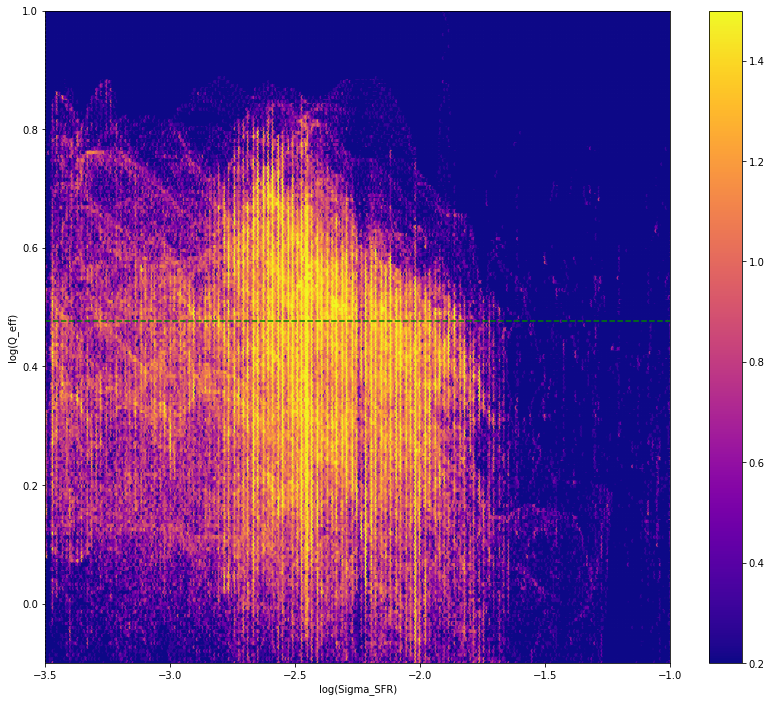

In [100]:
# libraries
import matplotlib.pyplot as plt
import numpy as np

mask = Sigma_HERACLES_CO_ < 45.

# create data
x = np.nan_to_num(log_Halpha_SFR_[mask].ravel())
y = np.nan_to_num(np.log10(Qeff_min[mask].ravel()))
 
# Make the plot
plt.figure(figsize=[14, 12])
plt.hexbin(x, y, gridsize=600, bins='log', cmap='plasma', vmin=0.2, vmax=1.5)
plt.ylim(-0.1, 1.)
plt.xlim(-3.5, -1.0)
plt.colorbar()
plt.axhline(y=np.log10(3.), ls='--', color='g')
# kslaw = 1.48
# kslaw_bias = 5.
# plt.plot([-4., -2.], [-4.*kslaw+kslaw_bias, -2.*kslaw+kslaw_bias], '--', lw=20, color='g')
plt.xlabel('log(Sigma_SFR)')
plt.ylabel('log(Q_eff)')
plt.show()

## Romeo

Посмотрим трехкомпонентную модель c толщиной и сколько там получается:

In [24]:
G = 4.32
Qeff_max_rom = np.zeros(dist_.shape)
Qeff_min_rom = np.zeros(dist_.shape)
# rom_comp_min = np.empty(dist_.shape, dtype="S10")
# rom_comp_max = np.empty(dist_.shape, dtype="S10")
rom_comp_min = np.zeros(dist_.shape)
rom_comp_max = np.zeros(dist_.shape)

step = 0
errors = 0
for i, row in enumerate(dist_):
    for j, col in enumerate(dist_[0]):
        step+=1
        if step % 1000 == 0:
            print step
        c = c_g_[i][j]
        Sigma = 1.36*(Sigma_HI_[i][j] + Sigma_HERACLES_CO_[i][j])
        kappa = epicyclicFreq_real(gas_approx, dist_[i][j], scale)
        Sigma_s_ = Sigma_s_Leroy_[i][j]
        s_R_max = sig_R_max[i][j]
        s_R_min = sig_R_min[i][j]
                
        try:
            rom_max, comp = romeo_Qinv(r=None, epicycl=kappa, sound_vel_CO=c, sound_vel_HI=c, 
                            sigma_R=s_R_max, 
                            star_density=Sigma_s_, HI_density=Sigma_HI_[i][j], CO_density=Sigma_HERACLES_CO_[i][j], 
                            alpha=0.3, thin=False, verbose=False, He_corr=False)
        except ValueError:
            errors+=1
            rom_max = 0.01
            comp = 'error'
        Qeff_max_rom[i][j] = 1./rom_max
        if comp == 'star':
            marker = 1
        elif comp == 'HI':
            marker = 2
        elif comp == 'H2':
            marker = 3
        elif comp == 'error':
            marker = 0
        rom_comp_max[i][j] = marker
        
        try:
            rom_min, comp = romeo_Qinv(r=None, epicycl=kappa, sound_vel_CO=c, sound_vel_HI=c, 
                            sigma_R=s_R_min, 
                            star_density=Sigma_s_, HI_density=Sigma_HI_[i][j], CO_density=Sigma_HERACLES_CO_[i][j], 
                            alpha=0.7, thin=False, verbose=False, He_corr=False)
        except ValueError:
            errors+=1
            rom_min = 0.01
            comp = 'error'
        Qeff_min_rom[i][j] = 1./rom_min
        if comp == 'star':
            marker = 1
        elif comp == 'HI':
            marker = 2
        elif comp == 'H2':
            marker = 3
        elif comp == 'error':
            marker = 0
        rom_comp_min[i][j] = marker

        
print 'Errors:{}'.format(errors)

1000
2000
3000
4000
5000
6000
7000
8000
Errors:0


In [30]:
numpy.unique(rom_comp_min, return_counts=True)

(array([ 1.,  2.,  3.]), array([5942,  591, 1992], dtype=int64))

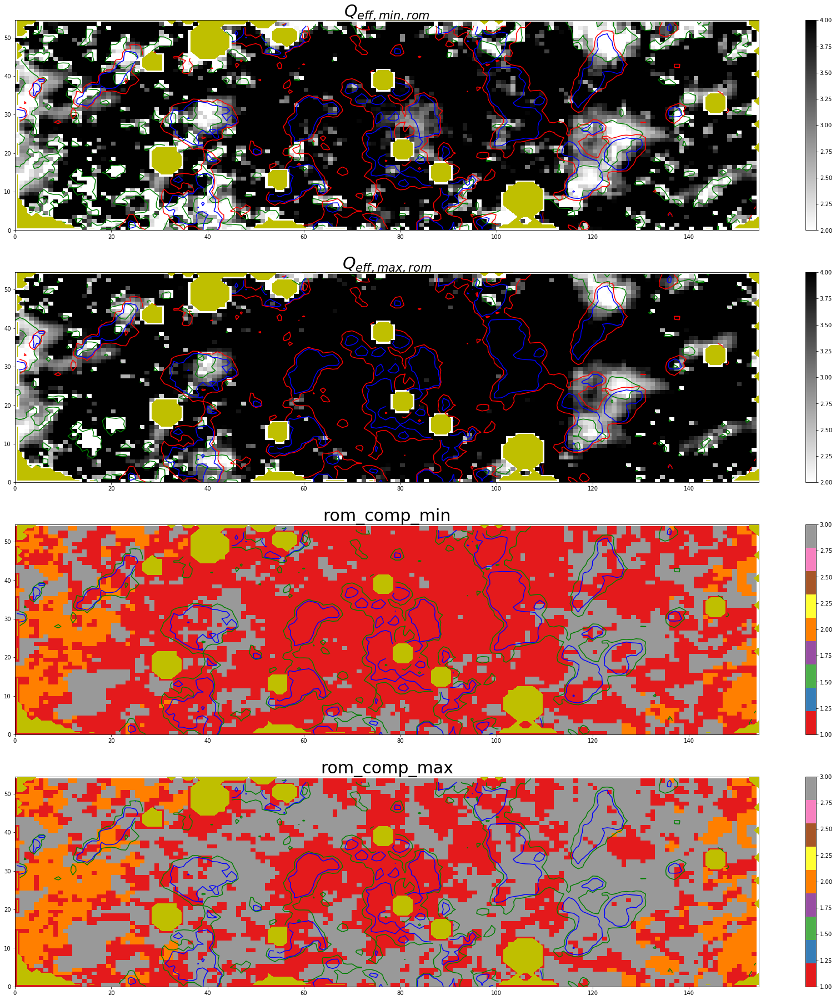

In [35]:
plt.figure(figsize=[30, 32])

plt.subplot(4,1,1)
# X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
quadmesh = plt.pcolormesh(X, Y, Qeff_min_rom, cmap=cm.gist_yarg)
# CS = plt.contour(X, Y, Sigma_HI, levels=[5., 10.], aspect='auto', alpha=0.5)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_min_rom, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,min,rom}$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
# circle = plt.Circle((512, 512), 10., color='b', fill=False, lw=10)
# plt.gca().add_artist(circle)
# circle = plt.Circle((Nx/2, Ny/2), 15*1553./(157.3+175.92), color='b', fill=False, lw=10)
# plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))


plt.subplot(4,1,2)
quadmesh = plt.pcolormesh(X, Y, Qeff_max_rom, cmap=cm.gist_yarg)
quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
CS = plt.contour(X, Y, Qeff_max_rom, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,max,rom}$', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
#bulge
# circle = plt.Circle((Nx/2, Ny/2), 15*1553./(157.3+175.92), color='b', fill=False, lw=10)
# plt.gca().add_artist(circle)
add_SFR_contours(levels=[-34.5, -34.], colors=('red', 'blue'))


plt.subplot(4,1,3)
quadmesh = plt.pcolormesh(X, Y, rom_comp_min, cmap=cm.Set1)
# quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
# CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'rom_comp_min', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5, -34.], colors=('g', 'blue'))

plt.subplot(4,1,4)
quadmesh = plt.pcolormesh(X, Y, rom_comp_max, cmap=cm.Set1)
# quadmesh.set_clim(vmin=2.0, vmax=4.)
plt.colorbar()
# CS = plt.contour(X, Y, Qgs, levels=[2.5], colors=('g'))
plt.title(r'rom_comp_max', fontsize=30)
# add_SFR_contours(levels=[-2.25], colors=('red'), X=None, Y=None)
mark_stars(colors=('y'), levels=[0.999, 1.001])
add_SFR_contours(levels=[-34.5, -34.], colors=('g', 'blue'))

plt.show()

Т.е. целиком почти определяется звездами и $H_2$, наверху - только звездами.

# Appendix

In [37]:
w = WCS(naxis=2)

In [56]:
w.wcs.crpix = [-234.75, 8.3393]
w.wcs.cdelt = numpy.array([-0.066667, 0.066667])
w.wcs.crval = [0, -20]
w.wcs.ctype = ["RA---AZP", "DEC--AZP"]
w.wcs.set_pv([(2, 1, 45.0)])

http://docs.astropy.org/en/stable/visualization/wcsaxes/ticks_labels_grid.html

http://docs.astropy.org/en/stable/wcs/

In [ ]:
fig = plt.figure(figsize=[24, 8])
ax = fig.add_subplot(1, 1, 1, projection=w)
lon = ax.coords[0]
lat = ax.coords[1]
lon.set_major_formatter('dd:mm:ss.s')
lat.set_major_formatter('dd:mm')
plt.imshow(img_dilation)

In [ ]:
fig = plt.figure(figsize=[24, 8])
ax = fig.add_subplot(1, 1, 1)
# lon.set_major_formatter('dd:mm:ss.s')
# lat.set_major_formatter('dd:mm')
plt.imshow(img_dilation)

ticksLocationsRA = linspace(0, len(img_dilation[0]), 3)
# ticksLabelsRA = degrees_to_hhmmss(ticksLocatoinsRA)
# xticks(ticksLocationsRA, ticksLabelsRA)
plt.xticks(ticksLocationsRA, [r'$30h10m$', r'$30h11m$', r'$30h12m$'])

# The same with DEC coodinates
ticksLocationsDEC = linspace(0, len(img_dilation), 3)
# ticksLabelsDEC = degrees_to_ddmmss(ticksLocatoinsDEC)
# yticks(ticksLocationsDEC, ticksLabelsDEC)
yticks(ticksLocationsDEC, [r"$30^{\circ}10^{''}$", r"$30^{\circ}11^{''}$", r"$29^{\circ}12^{''}$"])

plt.tick_params(axis='both', which='major', labelsize=20)
plt.tick_params(axis='both', which='minor', labelsize=18)

In [ ]:
lb = SkyCoord(ra='01h37m35s', dec='+15d34.5m')
rb = SkyCoord('01h35m49.5s', '+15d34.5m')

lu = SkyCoord('01h37m35s', '+16d00m')
ru = SkyCoord('01h35m49.5s', '+16d00m')

def pix_to_coordinates(xpix, ypix):
    xrange_ = lb.data.lon.deg + (rb.data.lon.deg-lb.data.lon.deg)/1024. * (xpix)
    yrange_ = lb.data.lat.deg + (lu.data.lat.deg-lb.data.lat.deg)/1024. * (ypix)
    return SkyCoord(ra='{}deg'.format(xrange_), dec='{}deg'.format(yrange_))

pix_to_coordinates(512,512).ra.hms

In [10]:
sig_raw = ImagePIL.open('VENGA_sig_los.png')
colorbar = ImagePIL.open('VENGA_sig_los_colorbar.png')
cw, ch = colorbar.width, colorbar.height
colorbar = np.array(list(colorbar.getdata())).reshape(ch, cw, 4)[:, 110:111, :].reshape(ch, 4)
Z = image_map_to_colorbar(sig_raw, colorbar, 8.921330089213301, 6.)

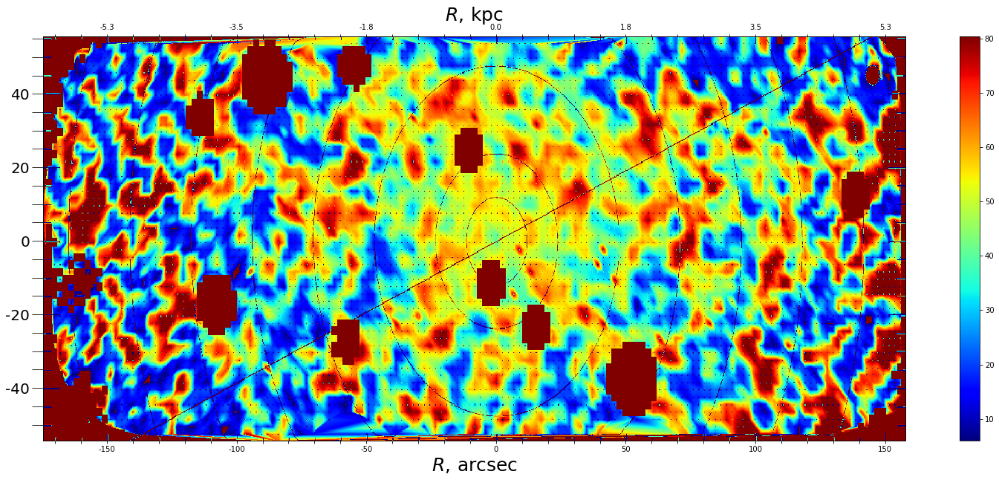

In [18]:
X,Y = np.meshgrid(np.arange(0.,1553,1), np.arange(0.,513,1))
# Z = np.array(list(ImagePIL.open('VENGA_sig_los.png').getdata())).reshape(513, 1553, 4)[:, :, 0]

fig = plt.figure(figsize=[26, 10])
quadmesh = plt.pcolormesh(X, Y, Z, cmap=cm.jet)
quadmesh.set_clim(vmin=6.0, vmax=80.4)
plt.colorbar()

ticksLocationsRA = np.arange(21, 1553, 46.7)
#  X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
plt.xticks(ticksLocationsRA, [str(int(_)+1-(int(_)+1)%10) if (int(_)+1-(int(_)+1)%10)%50 == 0 else '' for _ in np.linspace(-170.02, +160.1, 34)])
plt.xlabel(r'$R,\,\rm{arcsec}$', fontsize=25)

ax = plt.gca()
ax2 = ax.twiny()
ax2.set_xlim(ax.get_xlim())
ax2.set_xticks(ticksLocationsRA)
ax2.set_xticklabels(['{:2.1f}'.format((int(_)+1-(int(_)+1)%10)*scale) if (int(_)+1-(int(_)+1)%10)%50 == 0 else '' for _ in np.linspace(-170.02, +160.1, 34)])
ax2.set_xlabel(r"$R,\,\rm{kpc}$", fontsize=25)


# xinterp = np.linspace(678. - 53.82/scaley, 678. + 55.42/scaley, 513)

ticksLocationsDEC = np.arange(20, 513, 23.3)
#  X,Y = np.meshgrid(np.linspace(512. - 175.92/1.5, 512.+157.3/1.5, 1553), np.linspace(512. - 53.82/1.5, 512. + 55.42/1.5, 513))
plt.yticks(ticksLocationsDEC, [str(int(_)) if int(_)%20 == 0 else '' for _ in np.linspace(-50.0, 55.0, 22)])
ax.yaxis.set_tick_params(size=15, labelsize=20);

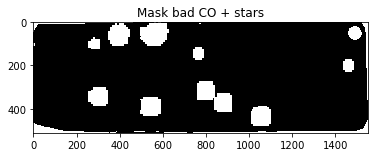

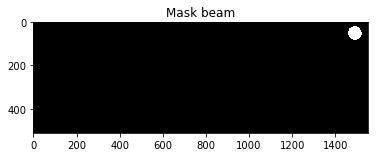

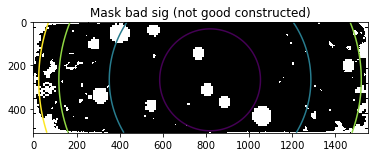

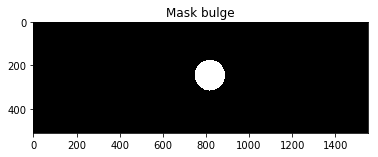

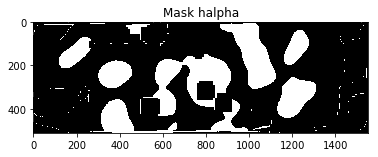

In [89]:
mask_CO = Sigma_HERACLES_CO_ > 45.
mask_CO[100:150, 500:550] = True
plt.imshow(mask_CO[::-1,:], cmap=plt.cm.Greys_r, interpolation='none')
plt.title('Mask bad CO + stars')
plt.show()

mask_beam = mask_CO
for i in range(len(mask_beam)):
    for j in range(len(mask_beam[0])):
        if i < 400 or j < 1200 or j > 1523:
            mask_beam[i][j] = False
plt.imshow(mask_beam[::-1,:], cmap=plt.cm.Greys_r, interpolation='none')
plt.title('Mask beam')
plt.show()

mask_sig = sig_los > 80.3
plt.imshow(mask_sig[::-1,:], cmap=plt.cm.Greys_r, interpolation='none')
CS = plt.contour(X, Y, dist_, levels=[50, 100, 150, 170])
plt.title('Mask bad sig (not good constructed)')
plt.show()

mask_bulge = (dist_ < 15.0)
plt.imshow(mask_bulge[::-1,:], cmap=plt.cm.Greys_r, interpolation='none')
plt.title('Mask bulge')
plt.show()

mask_halpha = (log_Halpha_SFR_>-2.25)&(log_Halpha_SFR_<-1.)
plt.imshow(mask_halpha[::-1,:], cmap=plt.cm.Greys_r, interpolation='none')
plt.title('Mask halpha')
plt.show()

hillshade (https://github.com/agile-geoscience/notebooks/blob/master/Colourmaps.ipynb)

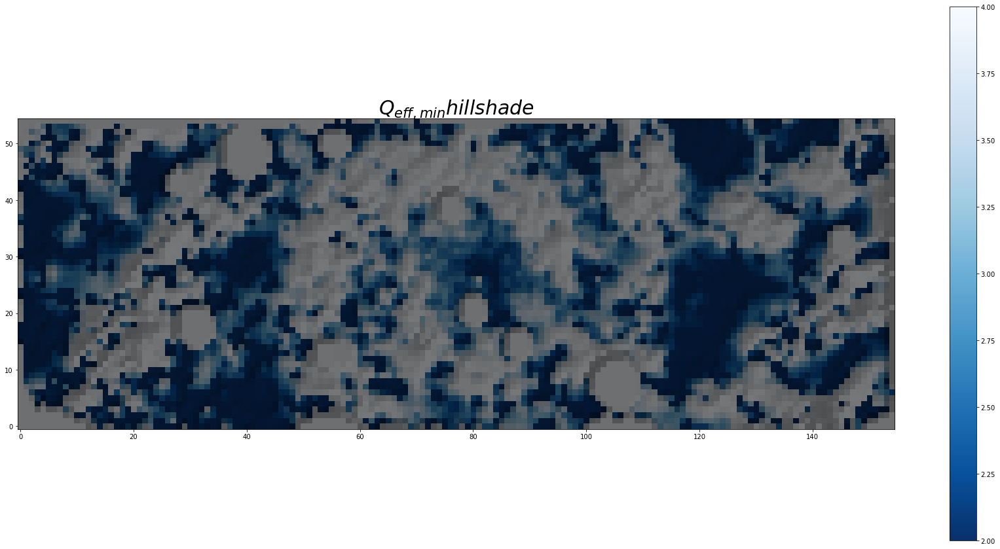

In [74]:
Qeff_min = np.load('Qeff_min.npy')
bark = np.load('bark.npy')
Qeff_max = np.load('Qeff_max.npy')
bark = np.load('bark_max.npy')
Qgs = np.load('Qgs.npy')
Qss_min = np.load('Qss_min.npy')
Qss_max = np.load('Qss_max.npy')

X,Y = np.meshgrid(np.arange(0.,Nx,1), np.arange(0.,Ny,1))

from matplotlib.colors import LightSource

ls = LightSource(azdeg=225, altdeg=140)
bumps = ls.hillshade(Qeff_min)**0.9     # Taking a root backs it off a bit.

from matplotlib.colors import LinearSegmentedColormap

def make_colormap(seq):
    """
    Converts a sequence of RGB tuples containing floats in the interval (0,1).
    For some reason LinearSegmentedColormap cannot take an alpha channel,
    even though matplotlib colourmaps have one.
    """
    seq = [(None,) * 3, 0.0] + list(seq) + [1.0, (None,) * 3]
    cdict = {'red': [], 'green': [], 'blue': []}
    for i, item in enumerate(seq):
        if isinstance(item, float):
            r1, g1, b1 = seq[i - 1]
            r2, g2, b2 = seq[i + 1]
            cdict['red'].append([item, r1, r2])
            cdict['green'].append([item, g1, g2])
            cdict['blue'].append([item, b1, b2])
    return LinearSegmentedColormap('CustomMap', cdict)

from matplotlib.colors import ListedColormap

def add_alpha(cmap, alpha=None):
    """
    Add an alpha channel (opacity) to a colourmap. Uses a ramp by default.
    Pass an array of 256 values to use that. 0 = transparent; 1 = opaque.
    """
    cmap4 = cmap(np.arange(cmap.N))
    if alpha is None:
        alpha = np.linspace(1, 0, cmap.N)
    cmap4[:,-1] = alpha
    return ListedColormap(cmap4)

kmap = make_colormap([(0,0,0)])
kmap4 = add_alpha(kmap)


plt.figure(figsize=[30, 15])

im = plt.imshow(Qeff_min, cmap='Blues_r', origin='lower', vmin=2., vmax=4.)
plt.colorbar()
plt.imshow(bumps, cmap=kmap4, origin='lower', vmax=4., alpha=0.7)
# quadmesh.set_clim(vmin=2.0, vmax=4.)
# CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
plt.title(r'$Q_{eff,min} hillshade$', fontsize=30)

plt.show()

Похоже на большем разрешении это сработало бы лучше

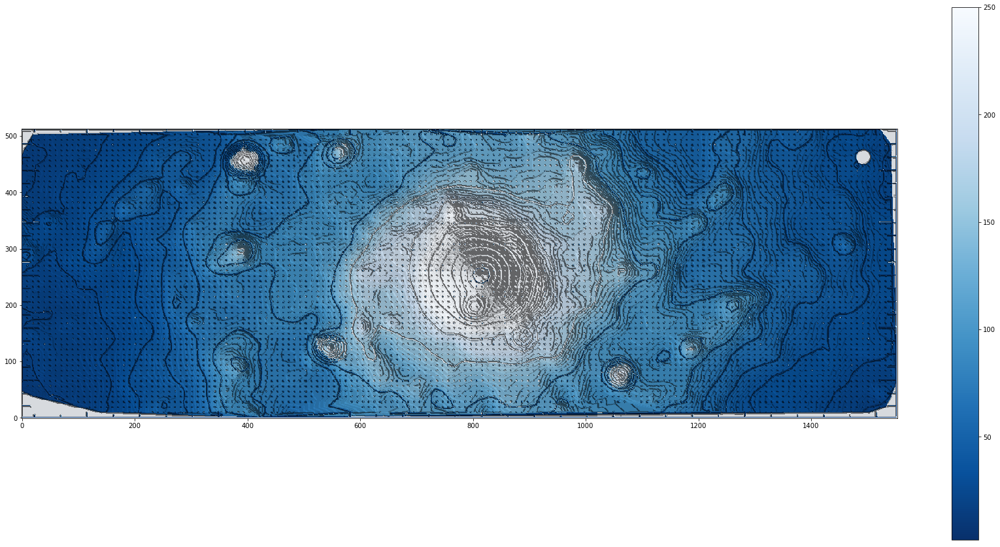

In [96]:
Sigma_s = np.load('Sigma_s.npy')

ls = LightSource(azdeg=125, altdeg=140)
bumps = ls.hillshade(Sigma_s)**0.55     # Taking a root backs it off a bit.

plt.figure(figsize=[30, 15])

im = plt.imshow(Sigma_s, cmap='Blues_r', origin='lower', vmin=2., vmax=250.)
plt.colorbar()
plt.imshow(bumps, cmap=kmap4, origin='lower', alpha=0.6)
# quadmesh.set_clim(vmin=2.0, vmax=4.)
# CS = plt.contour(X, Y, Qeff_min, levels=[2.5], colors=('g'))
# plt.title(r'$Q_{eff,min} hillshade$', fontsize=30)

plt.show()

Во, гораздо круче.